<a href="https://colab.research.google.com/github/TonioFlag/Teoria-de-Colas-y-Simulacion/blob/main/Caso-1/Analisis-de-entrada.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# @title Bibliotecas/Librerias
!pip install SciPy -q
!pip install pingouin -q
!pip install distfit -q
from matplotlib import pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import random
from scipy.stats import chi2_contingency, mannwhitneyu, kruskal, f_oneway, anderson, expon
import pingouin as pg
from distfit import distfit
import os

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 204.4/204.4 kB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.9/42.9 kB 1.6 MB/s eta 0:00:00


In [ ]:
# @title Limpieza de Datos
base = pd.read_excel('p1.xlsx')
lista = ["A","Z","S","I","C"]

def generarTiempo(row):
  if np.isnan(row.iloc[0]):
    return None
  else:
    dia = (int(row.iloc[0])-1)*24
    hora = int(row.iloc[1])
    min = (int(row.iloc[2])+random.uniform(-0.54,0.45))/60

  return dia+hora+min

for i in lista:
  base['DS'+i] = base[i+'D'] % 7 + 1
  base['Reloj'+i] = base[[i+'D', i+'H',i+'M']].apply(generarTiempo, axis=1)
  base.drop(columns=[i + 'D', i + 'H', i + 'M'], inplace=True)


base['TiempoA'] = base['RelojA'].diff().fillna(base['RelojA'][0])
base['TiempoA'] = base['TiempoA'].apply(lambda x: x * -1 if x < 0 and x > -1 else x)

base['TiempoZ'] = base['RelojZ']-base['RelojA']
base['TiempoS'] = base['RelojS'] - base['RelojZ']
base['TiempoS'] = base['TiempoS'].apply(lambda x: x * -1 if x < 0 and x > -1 else x)
base['TiempoI'] = base['RelojI'] - base['RelojS']
base['TiempoC'] = base['RelojC'] - base['RelojI']

bloques = {
    1: {
        "Cuadras": 32,
        "Calles": "8 de la St-1 a la St-7S",
        "Avenidas": "4 de la Av-4E a Av-7E"
    },
    2: {
        "Cuadras": 28,
        "Calles": "7 de la St-2N a la St-8N",
        "Avenidas": "4 de la Av-4E a Av-7E"
    },
    3: {
        "Cuadras": 32,
        "Calles": "8 de la St-1 a la St-7S",
        "Avenidas": "4 de la Av-1W a Av-3E"
    },
    4: {
        "Cuadras": 28,
        "Calles": "7 de la St-2N a la St-8N",
        "Avenidas": "4 de la Av-1W a Av-3E"
    },
    5: {
        "Cuadras": 22,
        "Calles": "8 de la St-1 a la St-7S",
        "Avenidas": "3 de la Av-8E a Av-10E"
    },
    6: {
        "Cuadras": 27,
        "Calles": "7 de la St-2N a la St-8N",
        "Avenidas": "4 de la Av-8E a Av-11E"
    },
    7: {
        "Cuadras": 35,
        "Calles": "8 de la St-1 a la St-7S",
        "Avenidas": "5 de la Av-2W a Av-6W"
    },
    8: {
        "Cuadras": 29,
        "Calles": "7 de la St-2N a la St-8N",
        "Avenidas": "5 de la Av-2W a Av-6W"
    },
    9: {
        "Cuadras": 34,
        "Calles": "9 de la St-8S a la St-16S",
        "Avenidas": "4 de la Av-4E a Av-7E"
    },
    10: {
        "Cuadras": 36,
        "Calles": "9 de la St-8S a la St-16S",
        "Avenidas": "4 de la Av-1W a Av-3E"
    },
    11: {
        "Cuadras": 28,
        "Calles": "9 de la St-8S a la St-16S",
        "Avenidas": "4 de la Av-8E a Av-11E"
    },
    12: {
        "Cuadras": 26,
        "Calles": "9 de la St-8S a la St-16S",
        "Avenidas": "4 de la Av-2W a Av-5W"
    },
    13: {
        "Cuadras": 24,
        "Calles": "6 de la St-9N a la St-14N",
        "Avenidas": "4 de la Av-4E a Av-7E"
    },
    14: {
        "Cuadras": 30,
        "Calles": "8 de la St-9N a la St-16N",
        "Avenidas": "4 de la Av-1W a Av-3E"
    },
    15: {
        "Cuadras": 18,
        "Calles": "6 de la St-9N a la St-14N",
        "Avenidas": "4 de la Av-8E a Av-11E"
    },
    16: {
        "Cuadras": 24,
        "Calles": "7 de la St-9N a la St-15N",
        "Avenidas": "4 de la Av-2W a Av-5W"
    }
}

def hallarBloque(direccion):
  direccion = direccion.split(' ')
  parte1 = direccion[0]
  parte2 = direccion[1]
  for i in range(1,17):
    elementosA = bloques[i]['Avenidas'].split(' ')
    inferiorA = elementosA[3].split('-')[1][:-1]
    elementosC = bloques[i]['Calles'].split(' ')
    if len(elementosC[3].split("-")[1]) == 1:
      inferiorC = elementosC[3].split('-')[1]
    else:
      inferiorC = elementosC[3].split('-')[1][:-1]
    for j in range(int(inferiorA),int(elementosA[5].split('-')[1][:-1])+1):
      if elementosA[3] == 'Av-1W':
        avenida1 = elementosA[3].replace(inferiorA,str(j)).replace('W','E')
      else:
        avenida1 = None
      avenida = elementosA[3].replace(inferiorA,str(j))
      for k in range(int(inferiorC),int(elementosC[6].split('-')[1][:-1])+1):
        if elementosC[3] == 'St-1':
          calle1 = elementosC[3].replace(inferiorC,str(k))+'S'
        else:
          calle1 = None
        calle = elementosC[3].replace(inferiorC,str(k))

        if (parte1 == avenida and parte2 == calle) or (parte1 == calle and parte2 == avenida):
          return round(i)
        elif (parte1 == avenida1 and parte2 == calle) or (parte1 == calle and parte2 == avenida1):
          return round(i)
        elif (parte1 == avenida and parte2 == calle1) or (parte1 == calle1 and parte2 == avenida):
          return round(i)
        elif (parte1 == avenida1 and parte2 == calle1) or (parte1 == calle1 and parte2 == avenida1):
          return round(i)
  return None

def hallaBloqueCalles(row):
  direccion = row.iloc[0]
  direccion = direccion.split(' ')
  parte1 = direccion[0]
  parte2 = direccion[1]

  if np.isnan(row.iloc[1]):
    for i in range(1,17):
      elementosA = bloques[i]['Avenidas'].split(' ')
      inferiorA = elementosA[3].split('-')[1][:-1]
      elementosC = bloques[i]['Calles'].split(' ')
      if len(elementosC[3].split("-")[1]) == 1:
        inferiorC = elementosC[3].split('-')[1]
      else:
        inferiorC = elementosC[3].split('-')[1][:-1]
      for j in range(int(inferiorA),int(elementosA[5].split('-')[1][:-1])+1):
        avenida = elementosA[3].replace(inferiorA,str(j))
        for k in range(int(inferiorC),int(elementosC[6].split('-')[1][:-1])+1):
          calle = elementosC[3].replace(inferiorC,str(k))
          if elementosA[3] == 'Av-1W':
            if (parte1 == calle or parte2 == calle):
              return round(i)
          elif elementosC[3] == "St-1":
            if (parte1 == avenida or parte2 == avenida):
              return round(i)
          elif elementosA[3] == 'Av-1W' and elementosC[3] == 'St-1':
            return 3
    return 3
  else:
    return row.iloc[1]

base['Bloque'] = base['Servicio'].apply(lambda x: hallarBloque(x))
base['Bloque'] = base[['Servicio', 'Bloque']].apply(hallaBloqueCalles, axis=1)
asignacion1 = [1,3,5,7,9,10,11,12]
base['CAUE'] = base['Bloque'].apply(lambda x: 1 if x in asignacion1 else 2)

def hallar_vehiculo(row):
  amb = str(row["Amb"][0]) if pd.notna(row["Amb"]) else ""
  bom = str(row["Bombero"][0]) if pd.notna(row["Bombero"]) else ""
  part = str(row["Part"][0]) if pd.notna(row["Part"]) else ""
  serv = str(row["Servicio.1"]) if pd.notna(row["Servicio.1"]) else ""

  if serv == "M-B-P":
    return amb +"-"+ bom +"-"+ part
  elif serv == "M-B":
    return amb +"-"+ bom
  elif serv == "M-P":
    return amb +"-"+ part
  elif serv == "B":
    return bom
  elif serv == "P":
    return part
  elif serv == "M":
    return amb

def hallar_servidores(row):
  amb = str(row["Amb"]) if pd.notna(row["Amb"]) else ""
  bom = str(row["Bombero"]) if pd.notna(row["Bombero"]) else ""
  part = str(row["Part"]) if pd.notna(row["Part"]) else ""
  serv = str(row["Servicio.1"]) if pd.notna(row["Servicio.1"]) else ""
  if serv == "M-B-P":
    return amb +" y "+ bom +" y "+ part
  elif serv == "M-B":
    return amb +" y "+ bom
  elif serv == "M-P":
    return amb +" y "+ part
  elif serv == "B":
    return bom
  elif serv == "P":
    return part
  elif serv == "M":
    return amb

base['Vehiculos'] = base[["Amb","Bombero","Part","Servicio.1"]].apply(hallar_vehiculo, axis=1)
base['Servidores'] = base[["Amb","Bombero","Part","Servicio.1"]].apply(hallar_servidores, axis=1)
base.to_excel('base_datos_caso_fina.xlsx', index=False)

In [ ]:
# @title Funciones para pruebas de independencia, homogeneidad y de ajuste, además de las de gráficos de disperción.

def dispercion(j, variables):
  fig, axes = plt.subplots(1, len(variables), figsize=(5*len(variables), 5))
  for i, variable in enumerate(variables):
        ax = axes[i]
        if variable == 'DS':
          variable = 'DS'+j
        for categoria in base[variable].unique():
            x = len(base[(base[variable] == categoria)]['Tiempo'+j]) - 1
            ax.scatter(
                base[(base[variable] == categoria)]['Tiempo'+j][:x],
                base[(base[variable] == categoria)]['Tiempo'+j][1:],
                label=f"{categoria}", s=8, alpha=0.7
            )
        ax.set_title(f"Dispersión por {variable}")
        ax.set_xlabel(f"Tiempo{j} (t)")
        ax.set_ylabel(f"Tiempo{j} (t+1)")
        ax.legend(title=variable)

  plt.tight_layout()
  plt.show()

def dispercion_porgrupos(j, variables, base):
  fig, axes = plt.subplots(1, len(variables), figsize=(25, 5))
  for i, variable in enumerate(variables):
        ax = axes[i]
        if variable == 'DS':
          variable = 'DS'+j
        for categoria in base[variable].unique():
            x = len(base[(base[variable] == categoria)]['Tiempo'+j]) - 1
            ax.scatter(
                base[(base[variable] == categoria)]['Tiempo'+j][:x],
                base[(base[variable] == categoria)]['Tiempo'+j][1:],
                label=f"{categoria}", s=8, alpha=0.7
            )
        ax.set_title(f"Dispersión por {variable}")
        ax.set_xlabel(f"Tiempo{j} (t)")
        ax.set_ylabel(f"Tiempo{j} (t+1)")
        ax.legend(title=variable)

  plt.tight_layout()
  plt.show()

def graficos_QQPLOT(variable):
  distribuciones = ["norm", "expon", "logistic", "gumbel_l", "gumbel_r"]
  fig, axes = plt.subplots(1, 5, figsize=(16, 4))
  for i, distribucion in enumerate(distribuciones):
    ax = axes[i]
    ax = pg.qqplot(base[variable], dist=distribucion, ax=ax)
    ax.set_title(f"QQ Plot para {distribucion}")
    if i == 0:
      ax.set_ylabel(f"Cuantiles ordenados")
    else:
      ax.set_ylabel("")
    ax.set_xlabel("Cuantiles Teoricos")
  plt.tight_layout()
  plt.show()

def pruebas_independencia(df, var1, var2):

    resultado = pg.chi2_independence(x= var1, y=var2, data=df)[2]
    for i, row in resultado.iterrows():
      p = row['pval']
      pasa = 'Sí' if p > 0.05 else 'No'
      test = row["test"]
      resultado2 = row['chi2']
      dof = row['dof']
      if test == 'freeman-tukey' or test == 'mod-log-likelihood' or test == "neyman":
        None
      else:
        resultados.append(["Independencia",f'{test}', f'{var1} vs {var2}', f"Chi2={resultado2}, DoF={dof}", p, pasa])

def pruebas_homogeneidad(df, grupo, variable):
    grupos = df[grupo].unique()
    if len(grupos) == 2:  # Comparación entre dos grupos
        datos1 = df[df[grupo] == grupos[0]][variable]
        datos2 = df[df[grupo] == grupos[1]][variable]
        resultado = pg.mwu(datos1, datos2, alternative='two-sided')
        p = resultado['p-val'][0]
        pasa = 'Sí' if p > 0.05 else 'No'
        resultados.append(["homogeneidad",'Mann-Whitney U', f'{grupos[0]} vs {grupos[1]} (en {variable})', f"U={resultado['U-val'][0]:.2f}", p, pasa])
    elif len(grupos) >= 2:  # Comparación entre más de dos grupos
        datos = [df[df[grupo] == g][variable] for g in grupos]
        stat, p = kruskal(*datos)
        pasa = 'Sí' if p > 0.05 else 'No'
        resultados.append(["Homogeneidad", "Kruskal-Wallis", f'{grupo} para {variable}', f'Estadístico={stat}', p, pasa])
        stat, p = f_oneway(*datos)
        pasa = 'Sí' if p > 0.05 else 'No'
        resultados.append(["Homogeneidad",'ANOVA', f'{grupo} para {variable}', f'Estadístico={stat}', p, pasa])
        homones = pg.homoscedasticity(df, dv=variable, group=grupo)
        pasa = "Sí" if homones['equal_var'].iloc[0] else "No"
        resultados.append(["Homogeneidad Varianzas", "Homoscedasticity", f'{grupo} para {variable}', f'Estadístico={homones["W"].iloc[0]}', homones['pval'].iloc[0], pasa])
        homones = pg.homoscedasticity(df, dv=variable, group=grupo, method="levene", alpha = 0.05)
        pasa = "Sí" if homones['equal_var'].iloc[0] else "No"
        resultados.append(["Homogeneidad Varianzas", "Homoscedasticity (levene)", f'{grupo} para {variable}', f'Estadístico={homones["W"].iloc[0]}', homones['pval'].iloc[0], pasa])
        homones = pg.homoscedasticity(df, dv=variable, group=grupo, method="bartlett", alpha = 0.05)
        pasa = "Sí" if homones['equal_var'].iloc[0] else "No"
        resultados.append(["Homogeneidad Varianzas", "Homoscedasticity (bartlett)", f'{grupo} para {variable}', f'Estadístico={homones["T"].iloc[0]}', homones['pval'].iloc[0], pasa])

def prueba_ajuste_exponencial(df, variable):
    distribuciones = ["norm", "expon", "logistic", "gumbel", "gumbel_l", "gumbel_r", "extreme1", "weibull_min"]
    datos = df[variable]
    #params = expon.fit(datos)
    for i in distribuciones:
      try:
        stat, critical_values, significance_level = anderson(datos, dist=i)
        pasa = 'Sí' if stat < critical_values[2] else 'No'
        resultados.append(["Ajuste",f'Anderson-Darling', f'{variable} vs distribución {i}', f'Estadístico={stat}, Crítico={critical_values[2]}', significance_level, pasa])
      except:
        resultados.append(["Ajuste",f'Anderson-Darling', f'{variable} vs distribución {i}',"Error","Error","Error"])

def sacar_informacion(resultados, nombre):
    if not os.path.exists("Pruebas.xlsx"):
        with pd.ExcelWriter("Pruebas.xlsx") as writer:
            resultados.to_excel(writer, sheet_name=nombre, index=False)
    else:
        with pd.ExcelWriter("Pruebas.xlsx", engine='openpyxl', mode='a') as writer:
            resultados.to_excel(writer, sheet_name=nombre, index=False)

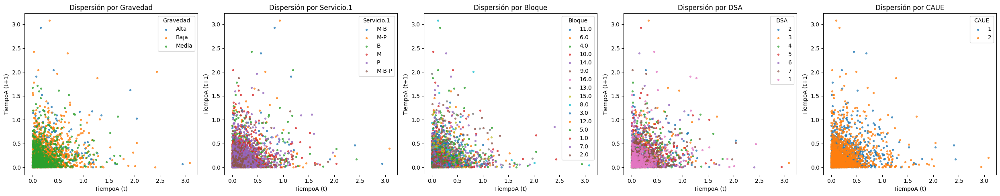

In [ ]:
# @title Gráficos de disperción del tiempo de arribo.
# @markdown No se identifica a simple vista dependencias, se evalua Gravedad, Tipo de Servicio, El BLoque, El dia de la semana y el CAUE. Quedando que en ninguna se ve una notable dependencia y además que los datos parecen seguir una distribución exponencial por la forma que arroja.
variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS','CAUE']
dispercion("A", variables)

In [ ]:
# @title Pruebas Para Tiempo de Arribo
# @markdown Se realizarón las pruebas de independencia del Tiempo de Arribo respecto a las variables gráficas anteriormente, no se cuenta con suficiente información para rechazar independencia y homogeneidad, aunque con la prueba de Barlett no la pasa pierde peso a razón de que los datos no estan distribuidos normalmente. En adición no paso ninguna de las de Bondad de Ajuste, por lo que se procede a hacer Gráficas QQ-Plot.
resultados = []
for i in variables:
  j="TiempoA"
  if i =="DS":
    i = "DSA"
  pruebas_independencia(base, i, j)
  pruebas_homogeneidad(base, i, j)

prueba_ajuste_exponencial(base, j)
df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa'])
sacar_informacion(df_resultados,"Tiempo de Arribo")

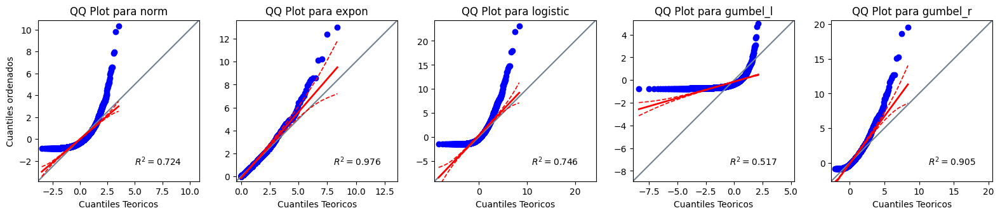

In [ ]:
# @title Se hacen gráficas Q-Q Plot porque las pruebas de Bondad de Ajuste no paso ninguna.
# @markdown Se identifica que con la que esta más representada es con la Exponecial con un R2 de 0.976, unicamente que tiene colas muy pesadas.
graficos_QQPLOT("TiempoA")

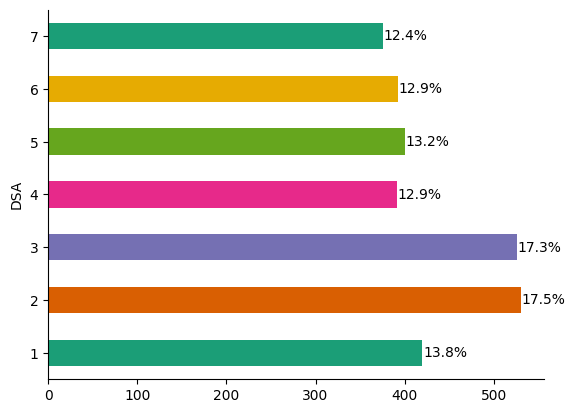

In [ ]:
# @title Dia de la semana
counts = base.groupby('DSA').size()
percentages = counts / counts.sum() * 100
ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

for i, (count, percentage) in enumerate(zip(counts, percentages)):
    ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')

plt.gca().spines[['top', 'right']].set_visible(False)
plt.show()

In [ ]:
# @title Correlacion

from scipy.stats import spearmanr, pearsonr
# Seleccionamos las variables de interés
x = base["CAUE"]  # Variable independiente
y = base["TiempoA"]  # Variable dependiente

# Correlación de Pearson (lineal)
pearson_corr, pearson_p = pearsonr(x, y)
print(f"Correlación de Pearson: {pearson_corr}, p-valor: {pearson_p}")

# Correlación de Spearman (monótona, no lineal)
spearman_corr, spearman_p = spearmanr(x, y)
print(f"Correlación de Spearman: {spearman_corr}, p-valor: {spearman_p}")

# Correlación de Pearson con los datos transformados
log_pearson_corr, log_pearson_p = pearsonr(base["CAUE"], np.log(base["TiempoA"]))
print(f"Correlación de Pearson (log transformado): {log_pearson_corr}, p-valor: {log_pearson_p}")

Correlación de Pearson: 0.002004688180555097, p-valor: 0.9120964670417522
Correlación de Spearman: -0.010927197824800523, p-valor: 0.5473349540842718
Correlación de Pearson (log transformado): -0.007627632707473781, p-valor: 0.6744521014477312


In [ ]:
# @title Se separa por Dia de la semana y por CAUE

resultados = []
variables = ['Gravedad', 'Servicio.1', 'Bloque','CAUE']
for k in base["DSA"].unique():
  filtro = base[base["DSA"]==k]
  for i in variables:
    j="TiempoA"
    if i =="DS":
      i = "DSA"
    pruebas_independencia(base, i, j)
    pruebas_homogeneidad(base, i, j)
  prueba_ajuste_exponencial(base, j)
  for resultado in resultados:
    if len(resultado) == 6:
      resultado.append(k)
df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa',"DSA"])
sacar_informacion(df_resultados,"TA DSA")

resultados = []
variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS']
for k in base["CAUE"].unique():
  filtro = base[base["CAUE"]==k]
  for i in variables:
    j="TiempoA"
    if i =="DS":
      i = "DSA"
    pruebas_independencia(base, i, j)
    pruebas_homogeneidad(base, i, j)
  prueba_ajuste_exponencial(base, j)
  for resultado in resultados:
    if len(resultado) == 6:
      resultado.append(k)
df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa',"CAUE"])
sacar_informacion(df_resultados,"TA CAUE")

variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS','CAUE']

In [ ]:
# @title Media, desviacion y varianza. Por dia de la semana para arribo.
resultados = []
for i in base['DSA'].unique():
  filtro = base[base['DSA']==i]
  media = filtro['TiempoA'].mean()
  varianza = filtro['TiempoA'].var()
  desviacion = filtro['TiempoA'].std()
  resultados.append([ i, media, varianza, desviacion])
df_resultados = pd.DataFrame(resultados, columns=['Dia de la semana', 'Media', 'Varianza', 'Desviacion'])
sacar_informacion(df_resultados,"TA-DS-Mean-Desv")

resultados = []
for i in base['CAUE'].unique():
  filtro = base[base['CAUE']==i]
  media = filtro['TiempoA'].mean()
  varianza = filtro['TiempoA'].var()
  desviacion = filtro['TiempoA'].std()
  resultados.append([ i, media, varianza, desviacion])
df_resultados = pd.DataFrame(resultados, columns=['CAUE', 'Media', 'Varianza', 'Desviacion'])
sacar_informacion(df_resultados,"TA-CAUE-Mean-Desv")

[distfit] >INFO> fit
[distfit] >INFO> transform
[distfit] >INFO> [norm      ] [0.00 sec] [RSS: 17.6726] [loc=0.237 scale=0.262]
[distfit] >INFO> [expon     ] [0.00 sec] [RSS: 0.499745] [loc=0.000 scale=0.237]
[distfit] >INFO> [pareto    ] [0.00 sec] [RSS: 0.255029] [loc=-2.267 scale=2.267]
[distfit] >INFO> [dweibull  ] [0.14 sec] [RSS: 11.0387] [loc=0.138 scale=0.166]
[distfit] >INFO> [t         ] [0.21 sec] [RSS: 11.1328] [loc=0.154 scale=0.131]
[distfit] >INFO> [genextreme] [0.14 sec] [RSS: 2.30205] [loc=0.098 scale=0.103]
[distfit] >INFO> [gamma     ] [0.12 sec] [RSS: 9.83303] [loc=0.000 scale=2.174]
[distfit] >INFO> [lognorm   ] [0.00 sec] [RSS: 0.846538] [loc=-0.011 scale=0.151]
[distfit] >INFO> [beta      ] [0.21 sec] [RSS: 0.263268] [loc=0.000 scale=29.355]
[distfit] >INFO> [uniform   ] [0.00 sec] [RSS: 39.0774] [loc=0.000 scale=2.432]
[distfit] >INFO> [loggamma  ] [0.09 sec] [RSS: 17.9903] [loc=-98.735 scale=12.866]
[distfit] >INFO> [norm      ] [0.99 sec] [RSS: 17.6726] [loc=0

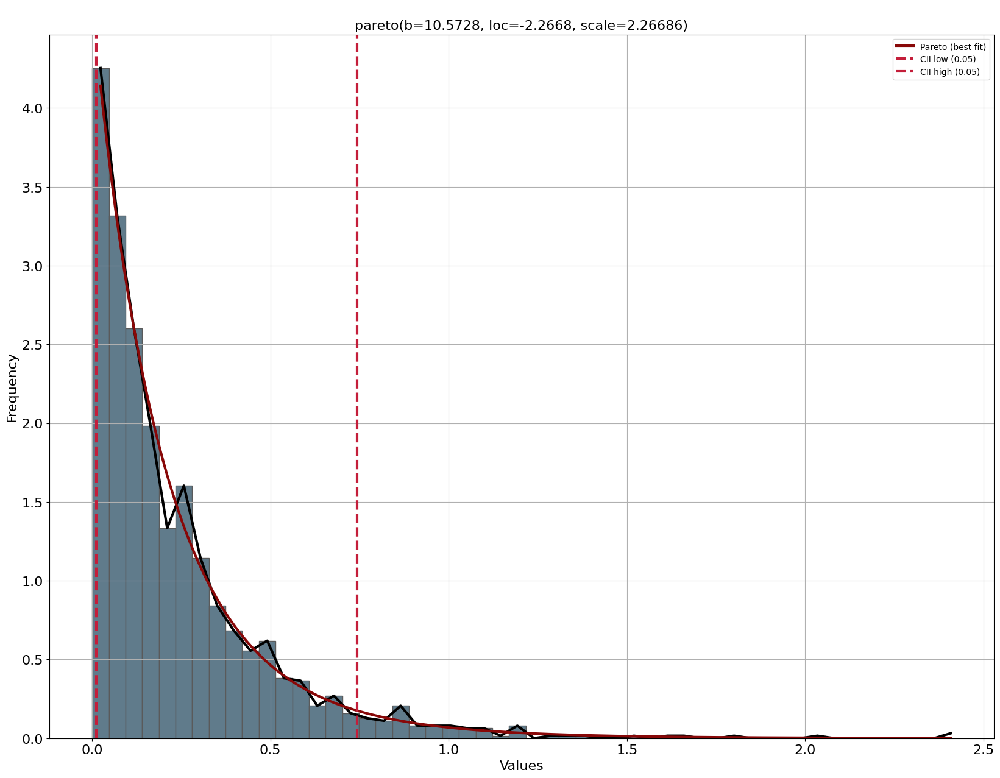

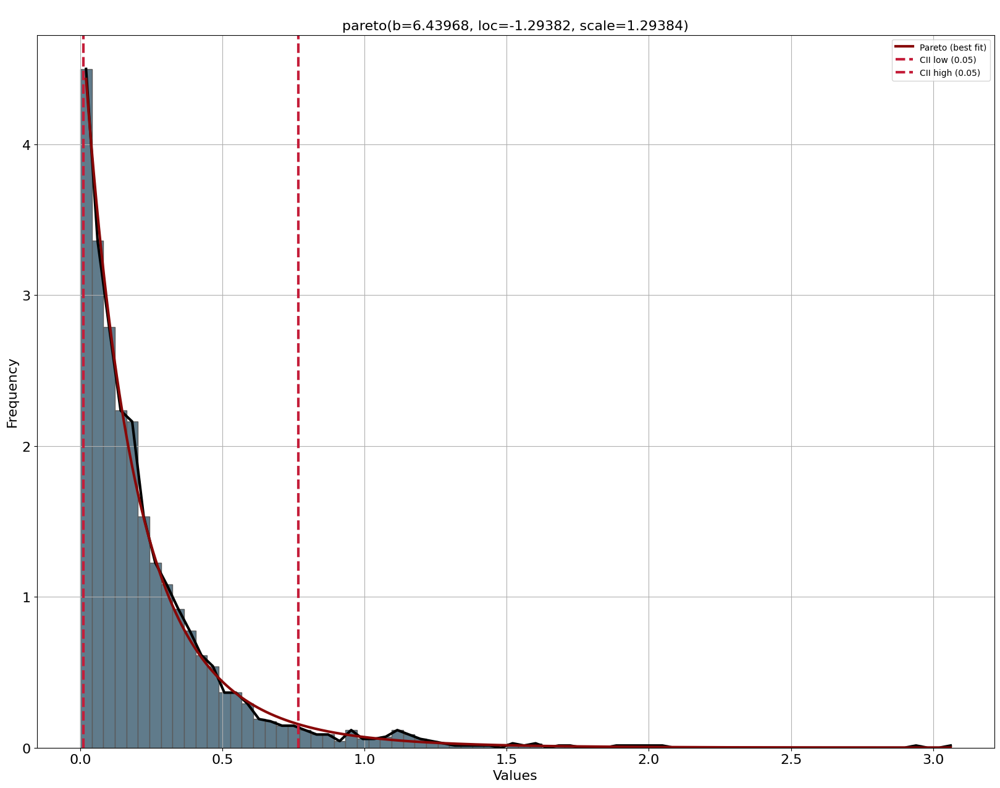

In [ ]:
# @title Funciones de probabilidad para tiempo de arribo por dia de la semana.
resultados = pd.DataFrame()
for i in base['DSA'].unique():
  filtro = base[base['DSA']==i]
  dfit = distfit()
  resultado = dfit.fit_transform(filtro['TiempoA'])
  resultado['summary']['DSA'] = [str(i)] * len(resultado['summary'])
  resultados = pd.concat([resultados, resultado['summary']])
  dfit.plot()
sacar_informacion(resultados, "FDP Tiempo Arribo por DSA")

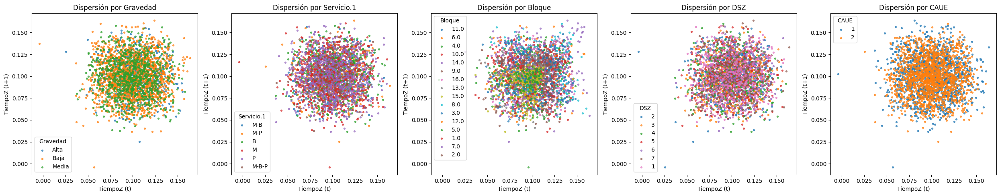

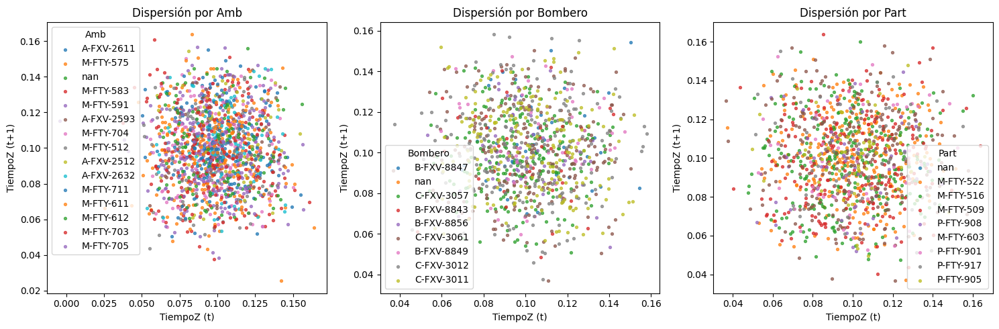

In [ ]:
# @title Gráficos de disperción para el Tiempo de Zona.
# @markdown A primera vista parecen ser independientes y homogeneas, exepto en Bloque que parece tener una agrupación de verde con amarillo. Por otra parte en CAUE se observa que el CAUE 2 esta más concentrado y el CAUE 1 más disperso.
variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS','CAUE']
dispercion("Z", variables)
variables = ['Amb','Bombero','Part']
dispercion("Z", variables)
variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS','CAUE','Amb','Bombero','Part']

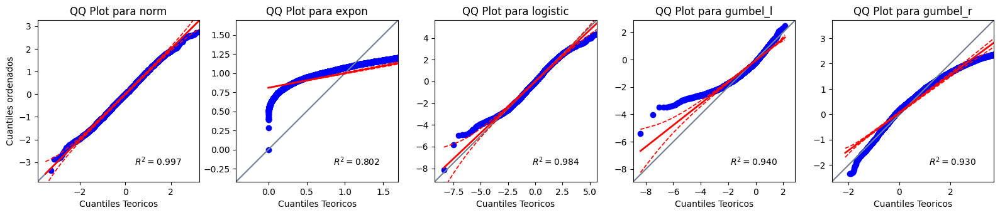

In [ ]:
# @title QQPlot
graficos_QQPLOT("TiempoZ")

In [ ]:
# @title Para el Tiempo de la Zona
# @markdown Las pruebas arrojarón que de la variable Bloque no son homogeneos en varianza al no pasar ninguna de Homoscedaticity, además de no pasar la de Kruskal-Wallis y ANOVA. El CAUE solo paso la independecia de Pearson, el resto no paso y en homogeneidad solo paso las Mann-Whitney U, Kruskal-Wallis ANOVA, las de Homoscedaticity no, se decide separar por CAUE.
resultados = []
for i in variables:
  j="TiempoZ"
  if i =="DS":
    i = "DSZ"
  pruebas_independencia(base, i, j)
  pruebas_homogeneidad(base, i, j)

prueba_ajuste_exponencial(base, j)
df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa'])
sacar_informacion(df_resultados,"Tiempo de Zona")

In [ ]:
# @title Correlacion

from scipy.stats import spearmanr, pearsonr
# Seleccionamos las variables de interés
x = base["CAUE"]  # Variable independiente
y = base["TiempoZ"]  # Variable dependiente

# Correlación de Pearson (lineal)
pearson_corr, pearson_p = pearsonr(x, y)
print(f"Correlación de Pearson: {pearson_corr}, p-valor: {pearson_p}")

# Correlación de Spearman (monótona, no lineal)
spearman_corr, spearman_p = spearmanr(x, y)
print(f"Correlación de Spearman: {spearman_corr}, p-valor: {spearman_p}")

# Correlación de Pearson con los datos transformados
log_pearson_corr, log_pearson_p = pearsonr(base["CAUE"], np.log(base["TiempoZ"]))
print(f"Correlación de Pearson (log transformado): {log_pearson_corr}, p-valor: {log_pearson_p}")

Correlación de Pearson: -0.008988963432206759, p-valor: 0.6205891817475268
Correlación de Spearman: -0.007533832083003575, p-valor: 0.6782297463996543
Correlación de Pearson (log transformado): 0.003742998241712063, p-valor: 0.8366966506942033


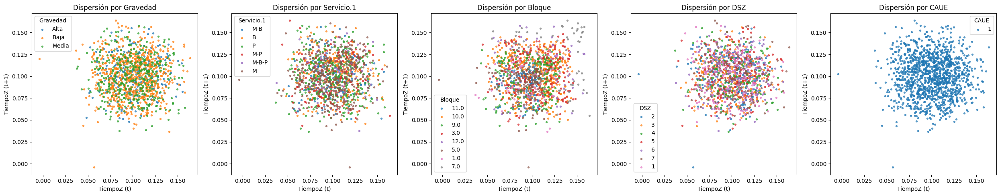

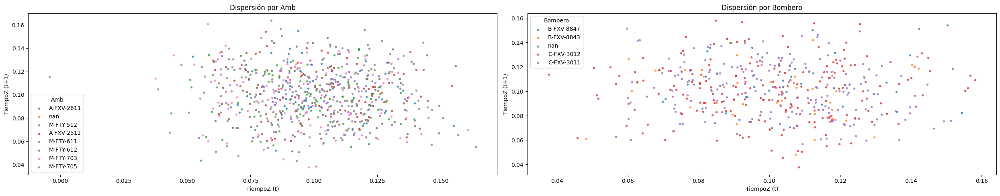

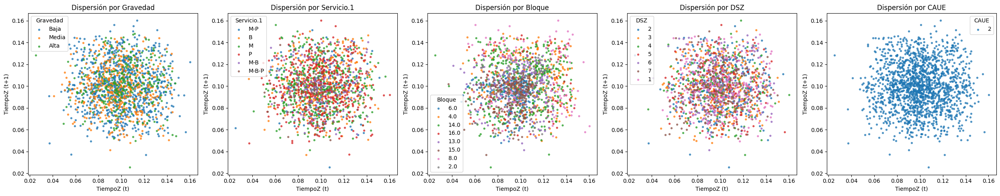

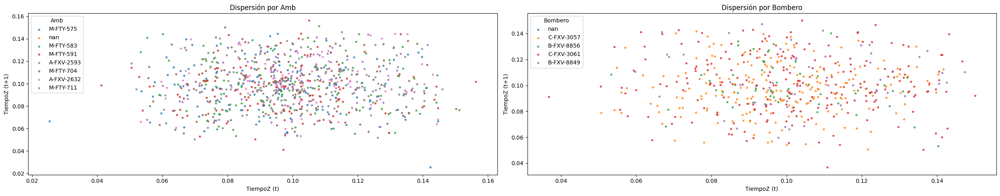

In [ ]:
# @title Gráficos de disperción para Cada CAUE
# @markdown Tras realizar la separación si se percibe que los datos de CAUE 1 so diferentes concentrandoce en 0.1 (media) con minimo 0.05 y maximo 0.15 aproximadamente (varianza), mientras CAUE 2 se concentra en 0.1 (media) con minimo 0.06 y maximo 0.14 aproximandamente (varianza)
for k in [1,2]:
  filtro = base[base['CAUE']==k]
  dispercion_porgrupos("Z", variables[0:5], filtro)
  dispercion_porgrupos("Z", variables[5:-1], filtro)

In [ ]:
# @title Para Tiempo de la Zona por CAUE
# @markdown En este punto pasa todos lo de indepencia para Bloque pero no pasa la homogeneidad, ninguna prueba, por lo que se debe separar por Bloque.
resultados = []
variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS','Amb','Bombero','Part']
for k in [1,2]:
  filtro = base[base['CAUE']==k]
  for i in variables:
    j="TiempoZ"
    if i =="DS":
      i = "DSZ"
    pruebas_independencia(filtro, i, j)
    pruebas_homogeneidad(filtro, i, j)
  prueba_ajuste_exponencial(filtro, j)
  for resultado in resultados:
    if len(resultado) == 6:
      resultado.append(k)
df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa','CAUE'])
sacar_informacion(df_resultados,f"TZ-CAUE")

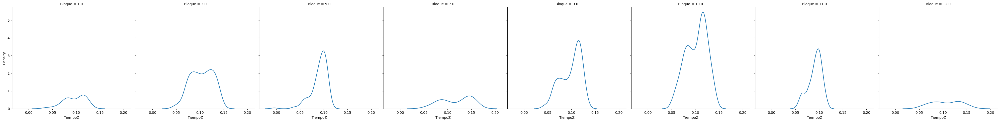

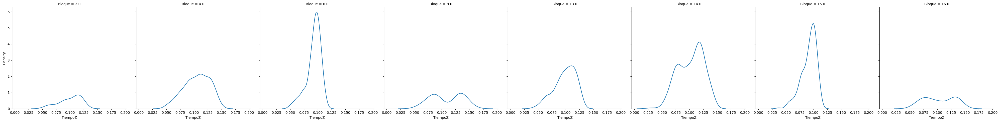

In [ ]:
# @title Separar por bloque, uniendo dependiendo media y varianza, muy similares.
# @markdown Al sacar las desviaciones se agrupa por lo valores más cercanos, quedando 7 Grupos, 3 en CAUE 1 Bloques {11,5},{1,9,3,10},{12,7} y 4 en CAUE 2 {14,4}, {6,15}, {2,13}, {16,8}. Se proceden a hacer las pruebas.
resultados = []
for i in range(1,17):
  filtro = base[base['Bloque']==i]
  media = filtro['TiempoZ'].mean()
  varianza = filtro['TiempoZ'].var()
  desviacion = filtro['TiempoZ'].std()
  resultados.append([filtro['CAUE'].unique()[0], i, media, varianza, desviacion])
df_resultados = pd.DataFrame(resultados, columns=["CAUE",'Bloque', 'Media', 'Varianza', 'Desviacion'])
sacar_informacion(df_resultados,"TZ-Bloque-Mean-Desv")

for i in range(1,3):
  sns.color_palette()
  filtro = base[base['CAUE']==i]
  sns.displot(data=filtro, x="TiempoZ", col="Bloque", kind = "kde")

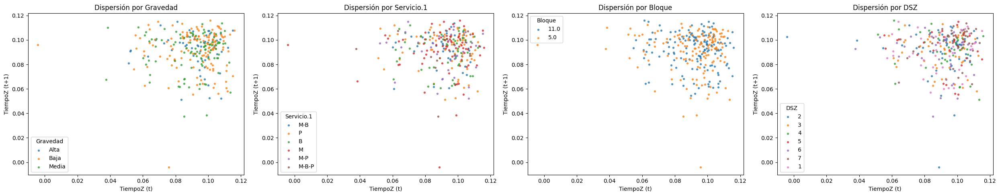

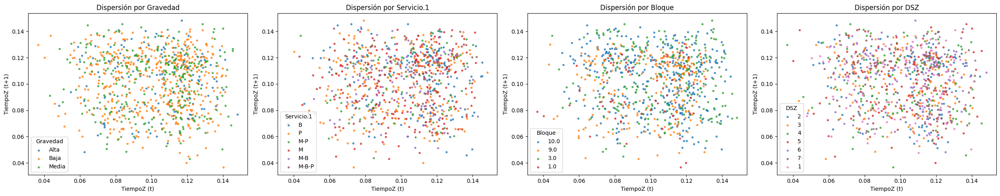

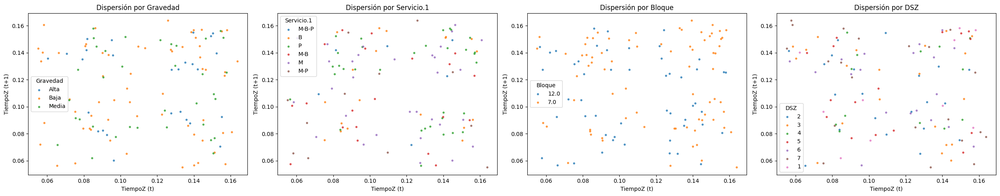

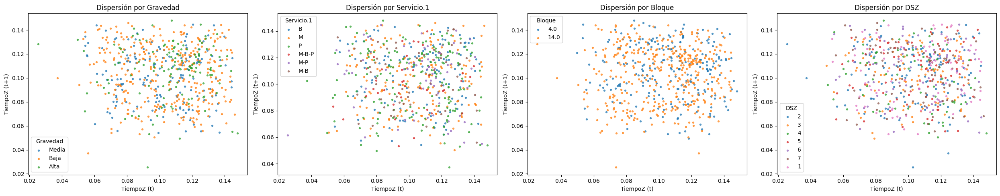

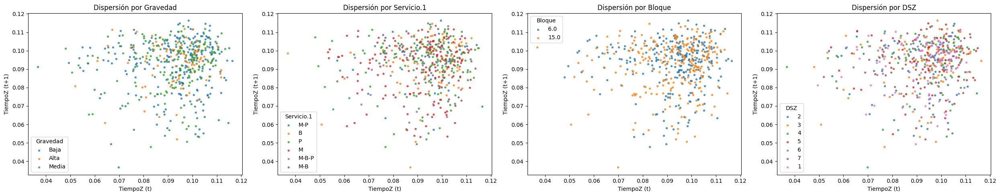

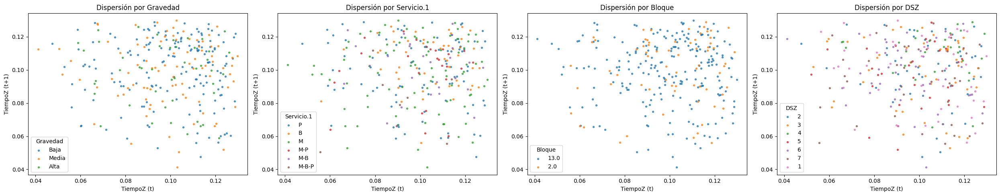

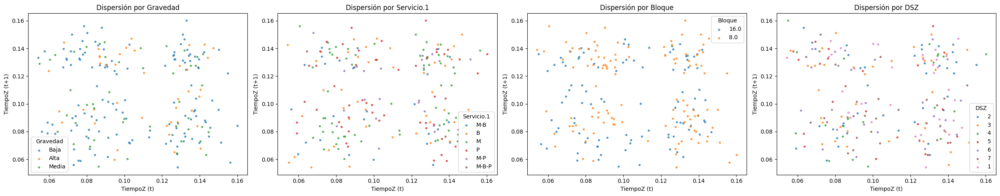

In [ ]:
# @title Gráficos de disperción por agrupación de Bloques.
grupos = [[11,5],[1,9,3,10],[12,7],[14,4],[6,15],[2,13],[16,8]]
variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS']
for grupo in grupos:
  filtro = base[base['Bloque'].isin(grupo)]
  dispercion_porgrupos("Z", variables, filtro)

In [ ]:
# @title Pruebas por los grupos de Bloques, queda:
# @markdown Pasan las pruebas los grupos {14,4},{2,13},{16,8},{11,5}. Se tiene que separar {1,9,3,10} dado que dos de las pruebas clave para homogeneidad de tiempos (Kruskal-Wallis y ANOVA) no pasan, la evidencia sugiere que los bloques actuales podrían no ser representativos de grupos homogéneos. Sería recomendable dividir los bloques en grupos más pequeños para garantizar una mayor homogeneidad dentro de cada grupo. Los grupos {12,7} se separan dado que dos de las pruebas clave para homogeneidad de tiempos (Mann-Whitney U, Kruskal-Wallis y ANOVA) no pasan. Y el grupo {6,15} no pasa prueba de homogeneidad de Varianzas ni en Gravedad y Tipo de Servicio.
resultados = []
for j in grupos:
  filtro = base[base['Bloque'].isin(j)]
  for i in variables:
    k="TiempoZ"
    if i =="DS":
      i = "DSZ"
    pruebas_independencia(filtro, i, k)
    pruebas_homogeneidad(filtro, i, k)
  prueba_ajuste_exponencial(filtro, k)
  for resultado in resultados:
    if len(resultado) == 6:
      resultado.append(j)

df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa',"Grupo"])
sacar_informacion(df_resultados,f"TZ-Bloques")

In [ ]:
# @title Se hace {6,15} evaluando media y varianza por Tipo de Servicio y Gravedad.
# @markdown Se separa {"Alta","Media"} y "Baja" para los bloques {6,15}. Para los bloques {1,9,3,10} se separan de {1,9},{3,10} y se separan 12 y 7.
filtro = base[base['Bloque'].isin([6,15])]
resultados = []
for i in filtro['Gravedad'].unique():
  filtro2 = filtro[filtro['Gravedad']==i]
  media = filtro2['TiempoZ'].mean()
  varianza = filtro2['TiempoZ'].var()
  desviacion = filtro2['TiempoZ'].std()
  resultados.append(["[6,15]", i, "", media,varianza,desviacion])
for i in filtro['Servicio.1'].unique():
  filtro2 = filtro[filtro['Servicio.1']==i]
  media = filtro2['TiempoZ'].mean()
  varianza = filtro2['TiempoZ'].var()
  desviacion = filtro2['TiempoZ'].std()
  resultados.append(["[6,15]", "", i, media,varianza,desviacion])
df_resultados = pd.DataFrame(resultados, columns=["Bloque",'Gravedad', 'Servicio.1', 'Media', 'Varianza', 'Desviacion'])
sacar_informacion(df_resultados,"TZ-6,15-Values")

In [ ]:
# @title Nuevas pruebas para las separaciones hechas.
# @markdown Todas pasan pruebas de independencia y homogeneidad quedando los grupos bloques {14,4},{2,13},{16,8},{11,5},{1,9},{3,10},{12},{7} y {6,15} separados por gravedad {"Alta","Media"},{"Baja"}
grupos = [[1,9],[3,10],[6,15],[12],[7]]
h = "TiempoZ"
resultados = []
for i in grupos:
  filtro = base[base['Bloque'].isin(i)]
  gravedad = [["Alta","Media"],["Baja"]]
  if i == [6,15]:
    for j in gravedad:
      filtro2 = filtro[filtro['Gravedad'].isin(j)]
      for k in variables:
        if k =="DS":
          k = "DSZ"
        pruebas_independencia(filtro2, k, h)
        pruebas_homogeneidad(filtro2, k, h)
      prueba_ajuste_exponencial(filtro2, h)
      for resultado in resultados:
        if len(resultado) == 6:
          resultado.append(i)
          resultado.append(j)
  else:
    for k in variables:
      if k =="DS":
        k = "DSZ"
      pruebas_independencia(filtro, k, h)
      pruebas_homogeneidad(filtro, k, h)
    prueba_ajuste_exponencial(filtro, h)
    for resultado in resultados:
      if len(resultado) == 6:
        resultado.append(i)

df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa',"Grupo", "Gravedad"])
sacar_informacion(df_resultados,f"TZ-CAUE-Bloques")

[distfit] >INFO> fit
[distfit] >INFO> transform
[distfit] >INFO> [norm      ] [0.00 sec] [RSS: 112.234] [loc=0.104 scale=0.023]
[distfit] >INFO> [expon     ] [0.00 sec] [RSS: 1036.29] [loc=0.025 scale=0.078]
[distfit] >INFO> [pareto    ] [0.00 sec] [RSS: 1036.29] [loc=-4194303.975 scale=4194304.000]
[distfit] >INFO> [dweibull  ] [0.02 sec] [RSS: 83.2062] [loc=0.104 scale=0.022]
[distfit] >INFO> [t         ] [0.23 sec] [RSS: 112.231] [loc=0.104 scale=0.023]
[distfit] >INFO> [genextreme] [0.18 sec] [RSS: 831.277] [loc=0.106 scale=0.051]
[distfit] >INFO> [gamma     ] [0.07 sec] [RSS: 119.98] [loc=-0.306 scale=0.001]
[distfit] >INFO> [lognorm   ] [0.00 sec] [RSS: 112.236] [loc=-2047.975 scale=2048.078]
[distfit] >INFO> [beta      ] [0.05 sec] [RSS: 45.1833] [loc=0.018 scale=0.131]
[distfit] >INFO> [uniform   ] [0.00 sec] [RSS: 495.313] [loc=0.025 scale=0.123]
[distfit] >INFO> [loggamma  ] [0.02 sec] [RSS: 86.6143] [loc=0.066 scale=0.038]
[distfit] >INFO> [norm      ] [0.63 sec] [RSS: 112.2

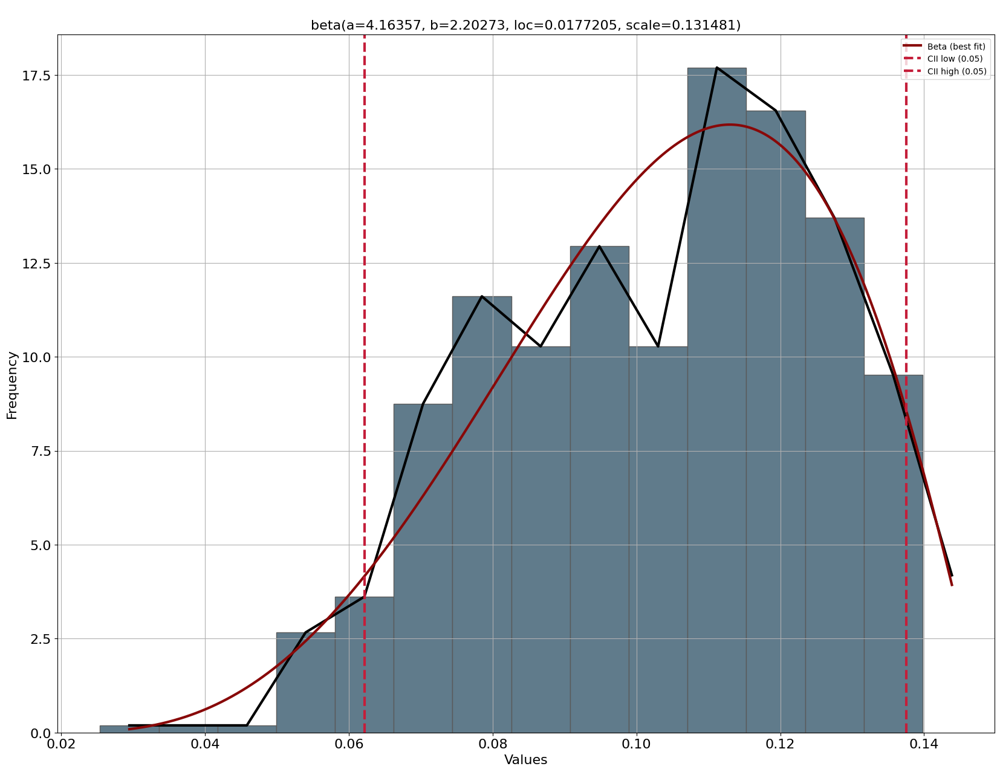

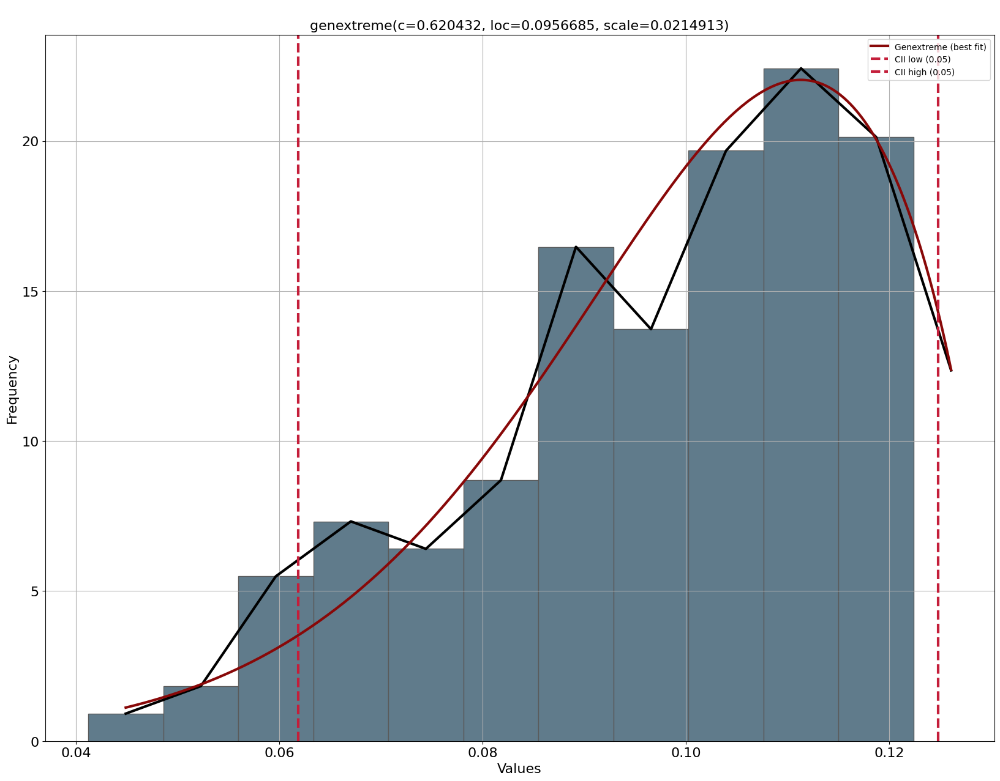

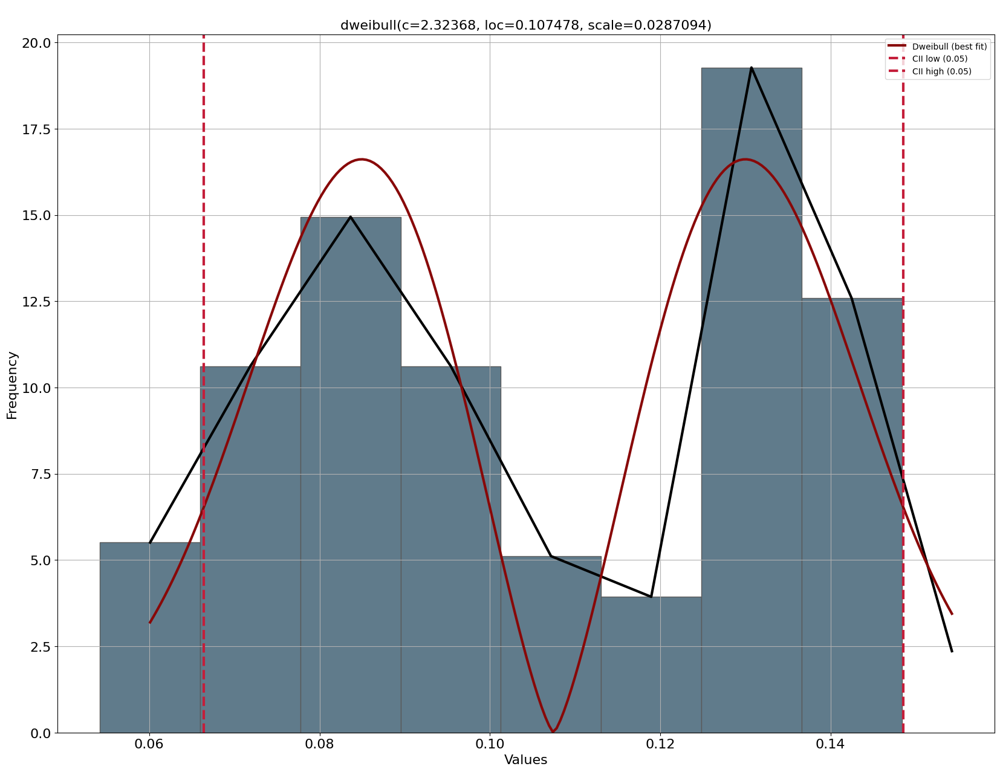

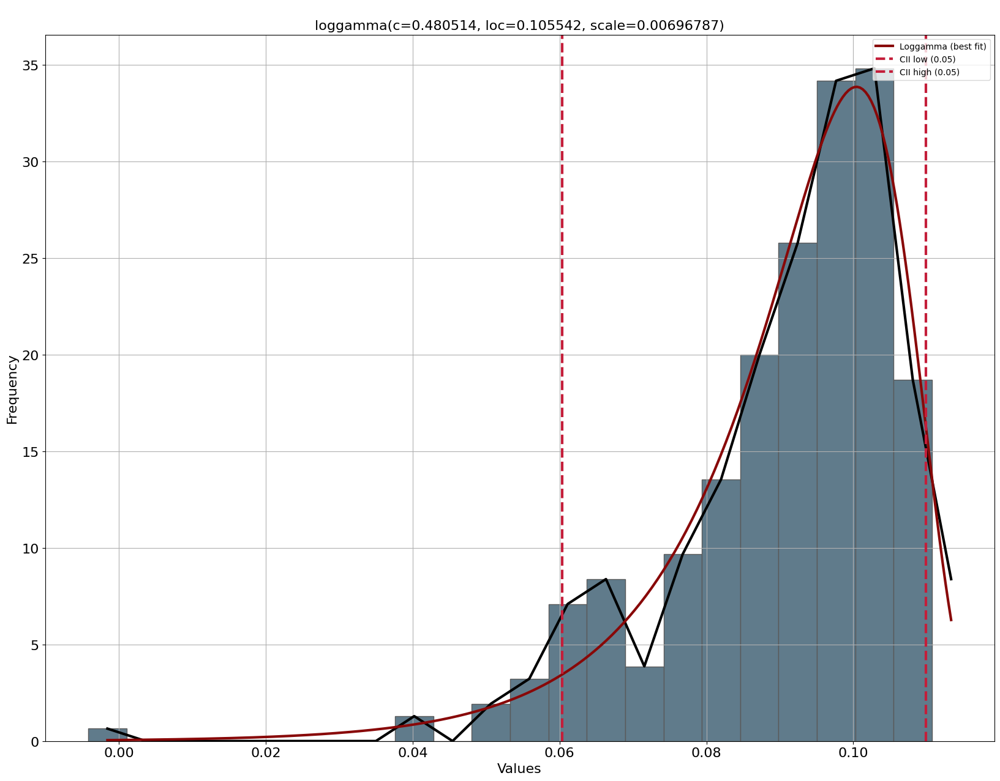

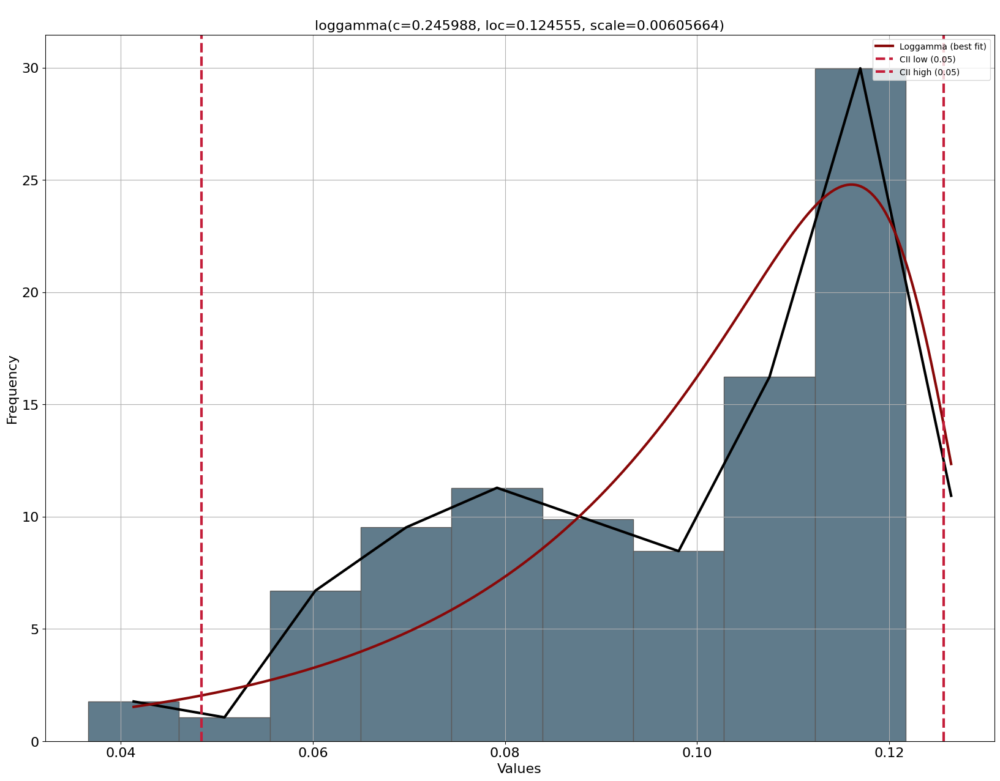

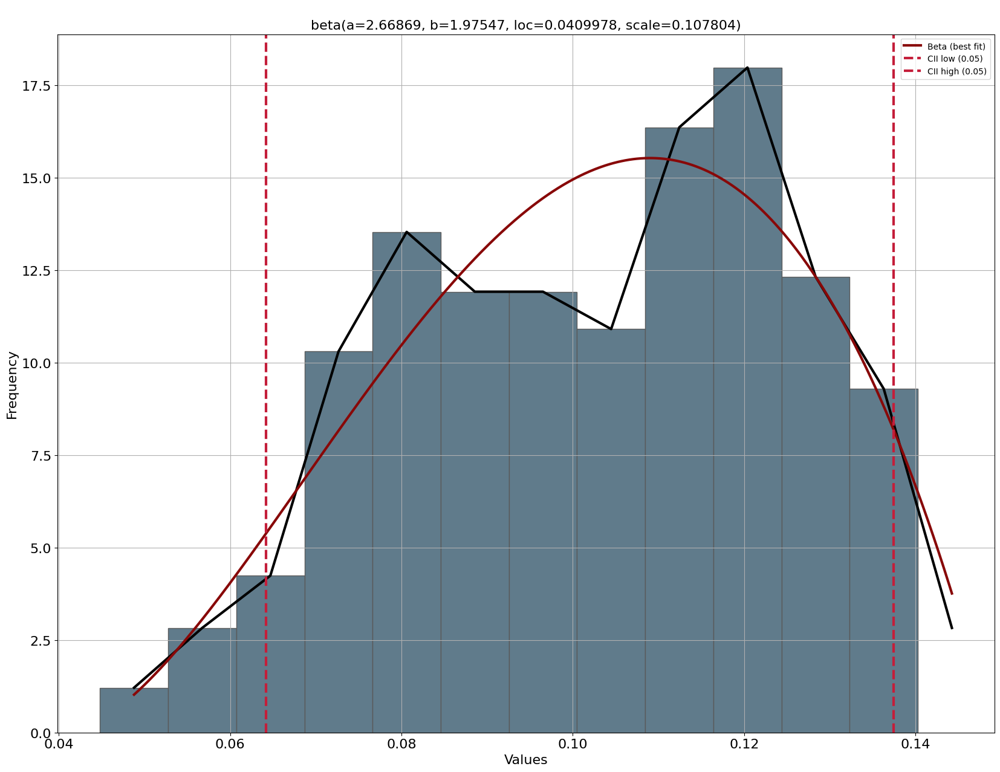

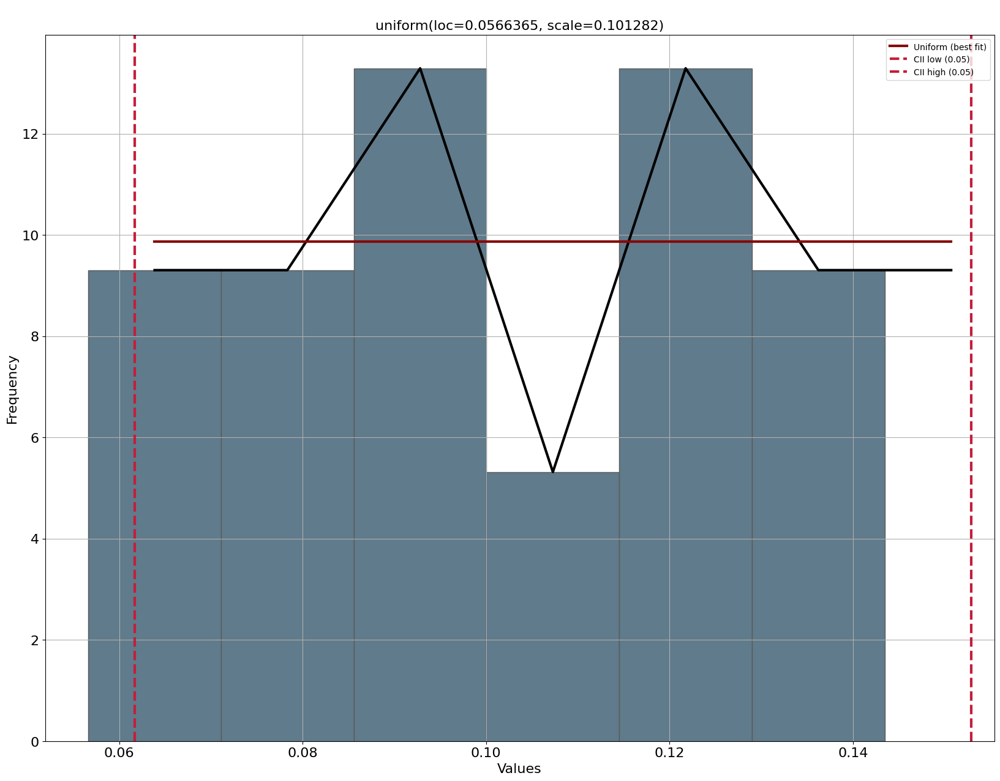

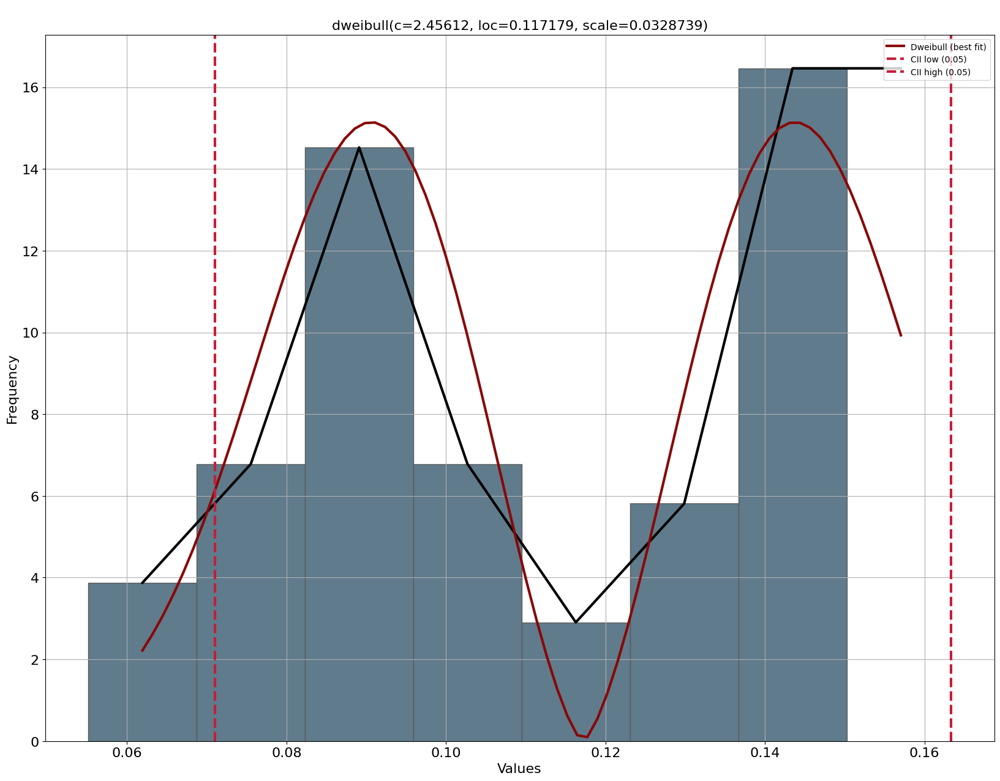

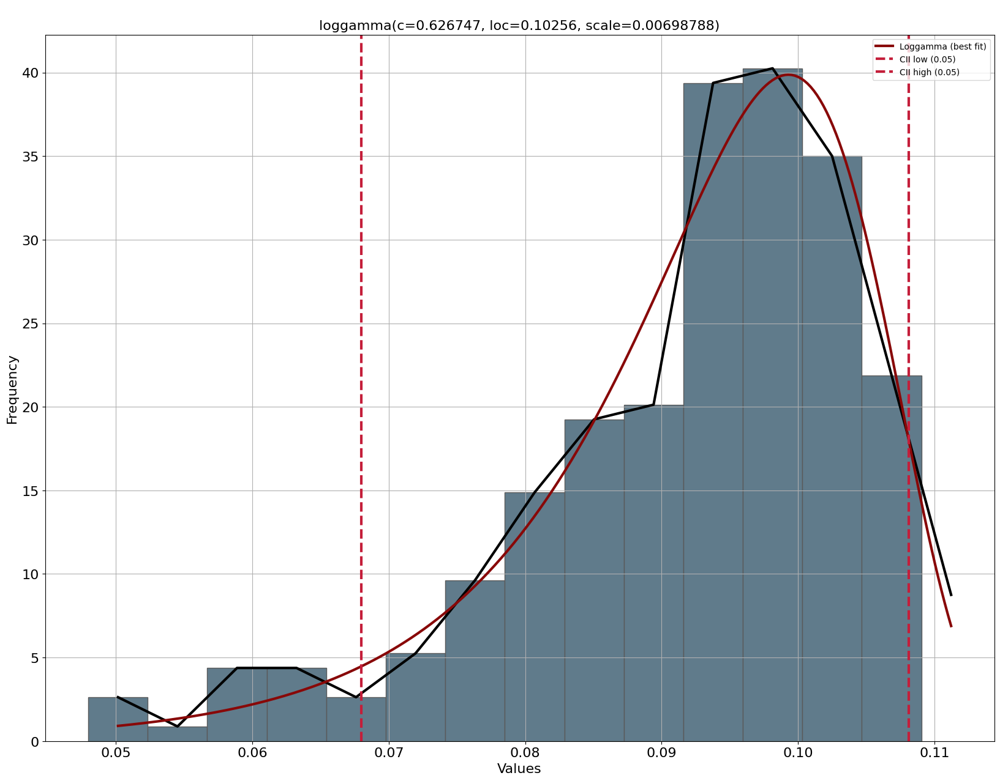

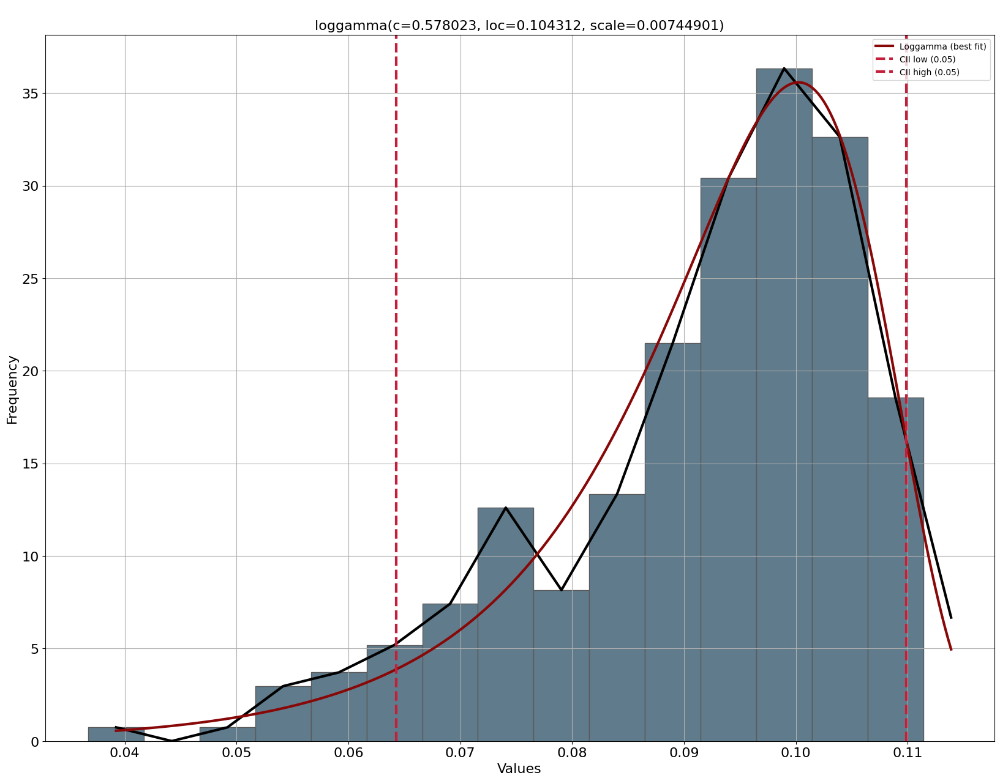

In [ ]:
# @title Sacando FDP de los grupos
grupos = [[14,4],[2,13],[16,8],[11,5],[1,9],[3,10],[12],[7],[6,15]]
gravedad = [["Alta","Media"],["Baja"]]
resultados = pd.DataFrame()
for i in grupos:
  filtro = base[base['Bloque'].isin(i)]
  if i == [6,15]:
    for j in gravedad:
      filtro2 = filtro[filtro['Gravedad'].isin(j)]
      dfit = distfit()
      resultado = dfit.fit_transform(filtro2['TiempoZ'])
      dfit.plot()
      resultado['summary']['Bloque'] = [str(i)] * len(resultado['summary'])
      resultado['summary']['Gravedad'] = [str(j)] * len(resultado['summary'])
      resultados = pd.concat([resultados, resultado['summary']])
  else:
    dfit = distfit()
    resultado = dfit.fit_transform(filtro['TiempoZ'])
    resultado['summary']['Bloque'] = [str(i)] * len(resultado['summary'])
    resultado['summary']['Gravedad'] = [""] * len(resultado['summary'])
    resultados = pd.concat([resultados, resultado['summary']])
    dfit.plot()

sacar_informacion(resultados, f"FDP Tiempo Zona")

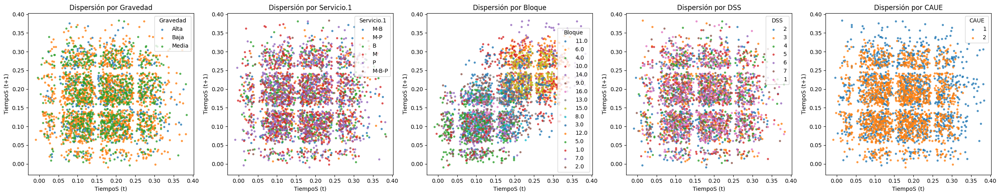

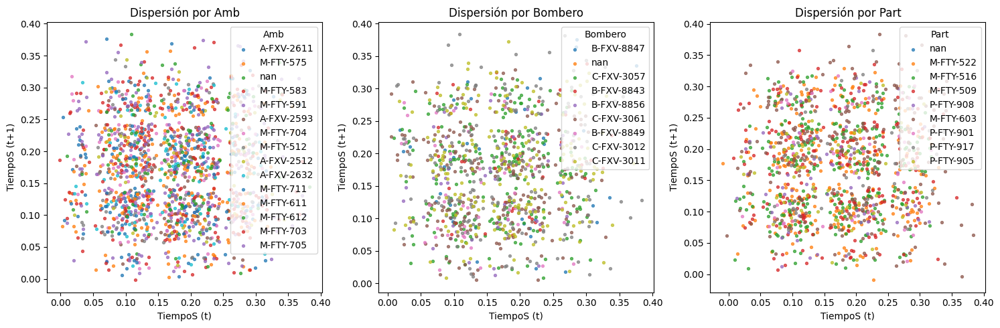

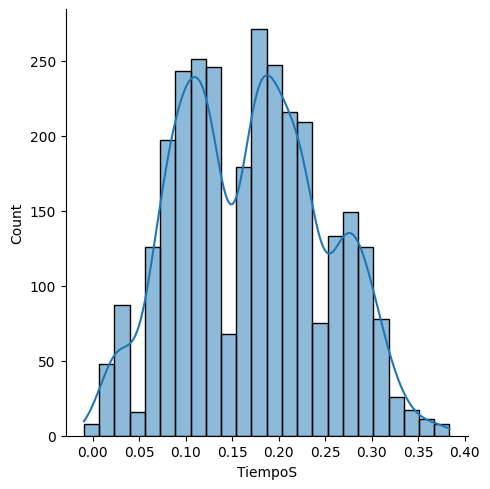

In [ ]:
# @title Tiempo de Salida Central (TiempoS)
variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS','CAUE']
dispercion("S", variables)
variables = ['Amb', 'Bombero','Part']
dispercion("S", variables)
sns.displot(data=base, x="TiempoS", kde=True)

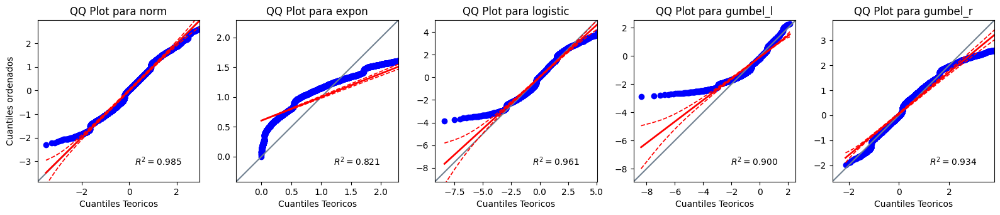

In [ ]:
# @title QQPlot
graficos_QQPLOT("TiempoS")

In [ ]:
# @title Pruebas de independencia y homogeneidad Tiempo de Salida Central
# @markdown Se debe separar por CAUE, solo paso una de las pruebas de independecia de 3 y no paso ninguna de homogeneidad.
variables = ['Gravedad', 'Servicio.1',"Amb","Bombero","Part", 'Bloque', 'DS','CAUE']
resultados = []
for i in variables:
  j="TiempoS"
  if i =="DS":
    i = "DSS"
  pruebas_independencia(base, i, j)
  pruebas_homogeneidad(base, i, j)

prueba_ajuste_exponencial(base, j)
df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa'])
sacar_informacion(df_resultados,"Tiempo de Salida Central")

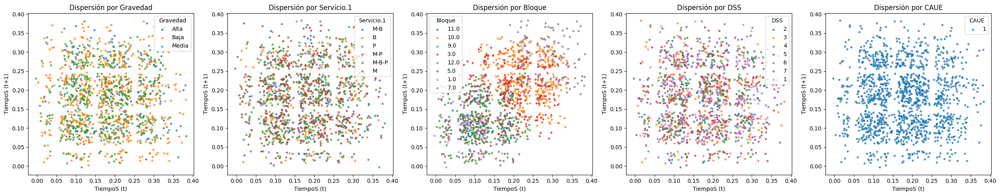

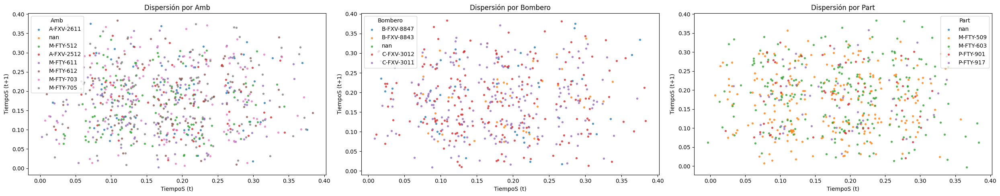

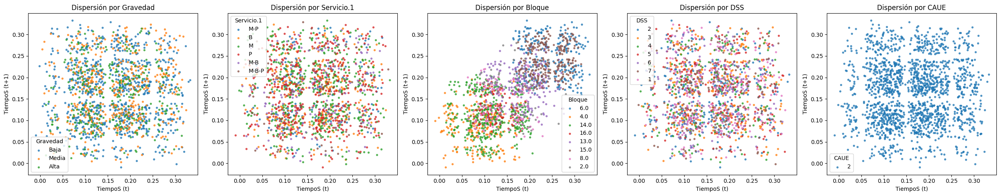

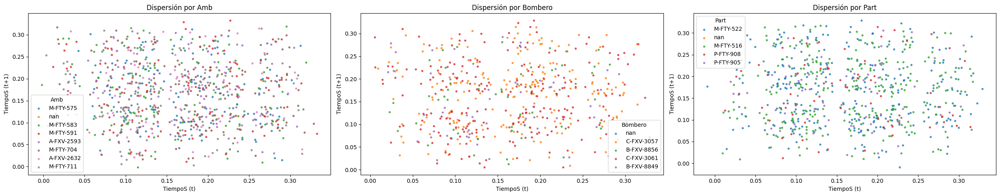

In [ ]:
# @title Separación de los CAUE, queda.
for k in [1,2]:
  variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS','CAUE']
  filtro = base[base['CAUE']==k]
  dispercion_porgrupos("S", variables, filtro)
  variables = ['Amb', 'Bombero','Part']
  dispercion_porgrupos("S", variables, filtro)

In [ ]:
# @title Nuevas Pruebas separando el CAUES
# @markdown No paso las pruebas de homogeneidad en los BLoques, por lo que se deben separar por bloques por que por CAUES no paso las pruebas, se aplica el mismo método que el tiempo de Zona.
resultados = []
variables = ['Gravedad', 'Servicio.1',"Amb","Bombero","Part", 'Bloque', 'DS','CAUE']
for k in [1,2]:
  filtro = base[base['CAUE']==k]
  for i in variables:
    j="TiempoS"
    if i =="DS":
      i = "DSS"
    pruebas_independencia(filtro, i, j)
    pruebas_homogeneidad(filtro, i, j)
  prueba_ajuste_exponencial(filtro, j)
  for resultado in resultados:
      if len(resultado) == 6:
        resultado.append(k)
df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa','CAUES'])
sacar_informacion(df_resultados,"TS-CAUES")

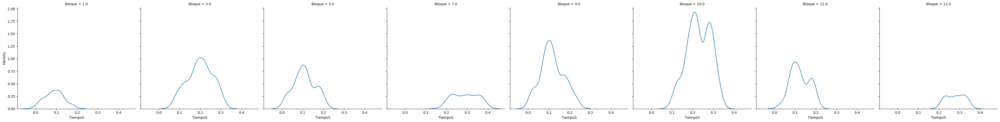

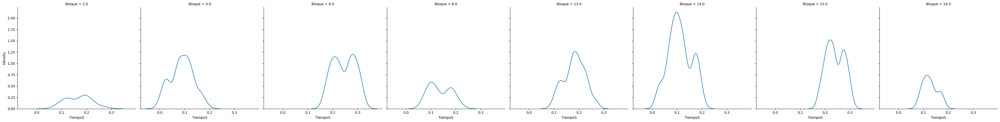

In [ ]:
# @title Sacando Media, varianza y desviación para agrupar los valores más parecidos.
# @markdown Se agrupan los siguientes bloques {7,12},{1,11},{3,10},{5,9},{2,8},{4,14,16},{15,6,13}
resultados = []
for i in range(1,17):
  filtro = base[base['Bloque']==i]
  media = filtro['TiempoS'].mean()
  varianza = filtro['TiempoS'].var()
  desviacion = filtro['TiempoS'].std()
  resultados.append([filtro['CAUE'].unique()[0], i, media, varianza, desviacion])
df_resultados = pd.DataFrame(resultados, columns=["CAUE",'Bloque', 'Media', 'Varianza', 'Desviacion'])
sacar_informacion(df_resultados,"TS-Bloque-Mean-Desv")

for i in range(1,3):
  sns.color_palette()
  filtro = base[base['CAUE']==i]
  sns.displot(data=filtro, x="TiempoS", col="Bloque", kind = "kde")

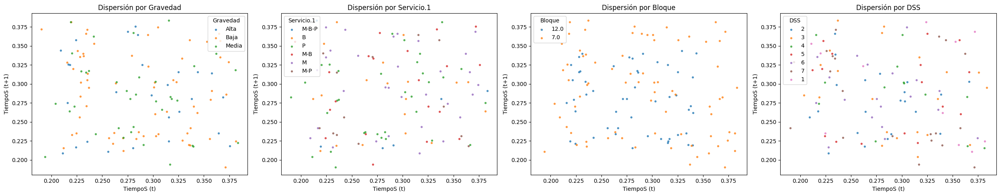

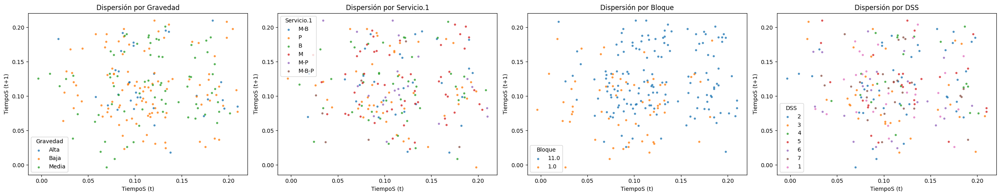

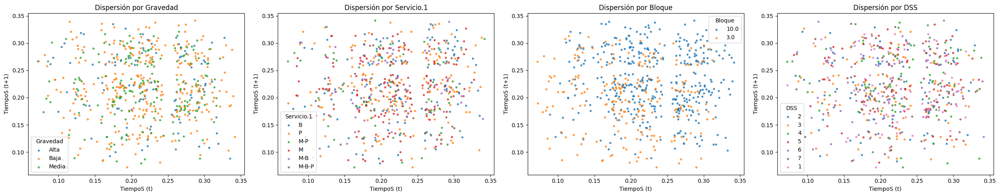

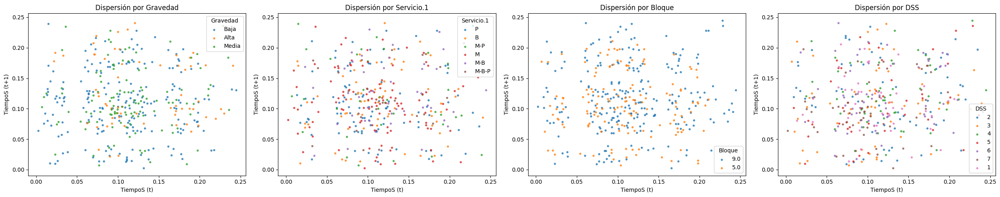

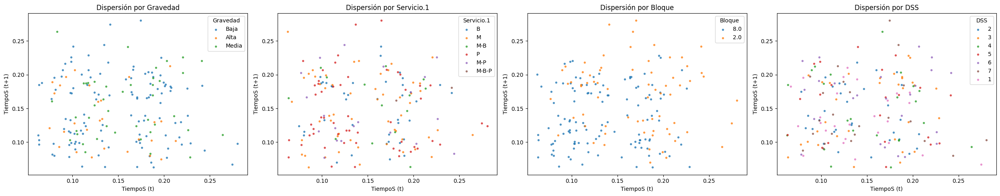

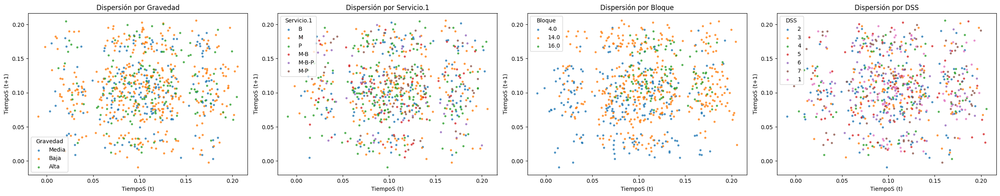

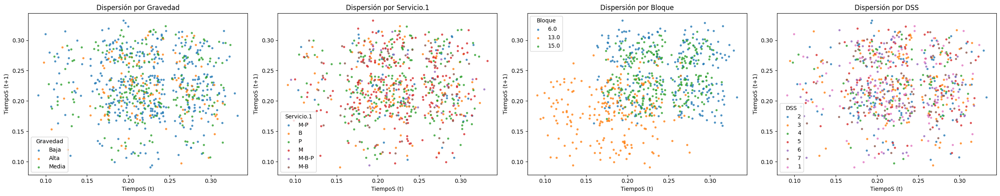

In [ ]:
# @title Gráficos de disperción de las agrupaciones realizadas.
# @markdown El unico grupo que no parece congeniar es el de los bloques 16,6 y 13.
grupos = [[7,12],[1,11],[3,10],[5,9],[2,8],[4,14,16],[15,6,13]]
variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS']
for grupo in grupos:
  filtro = base[base['Bloque'].isin(grupo)]
  dispercion_porgrupos("S", variables, filtro)

In [ ]:
# @title Pruebas por bloques
# @markdown Queda que se separan a los siguientes grupos {16},{4,14},{13},{6,15}
resultados = []
for j in grupos:
  filtro = base[base['Bloque'].isin(j)]
  for i in variables:
    k="TiempoS"
    if i =="DS":
      i = "DSS"
    pruebas_independencia(filtro, i, k)
    pruebas_homogeneidad(filtro, i, k)
  prueba_ajuste_exponencial(filtro, k)
  for resultado in resultados:
    if len(resultado) == 6:
      resultado.append(j)

df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa',"Grupo"])
sacar_informacion(df_resultados,f"TS-Bloques")

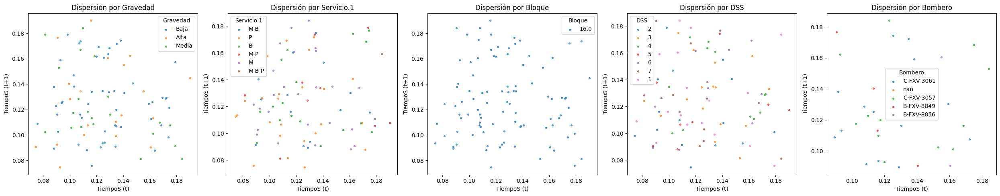

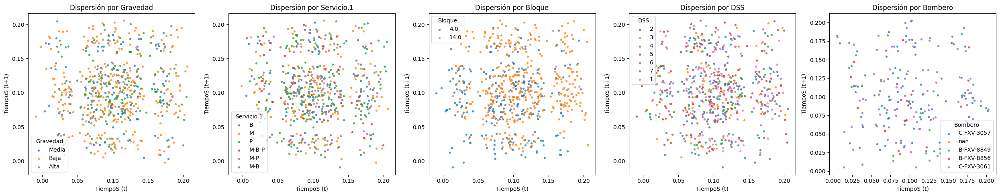

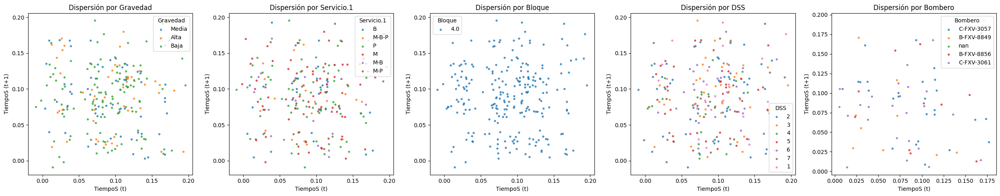

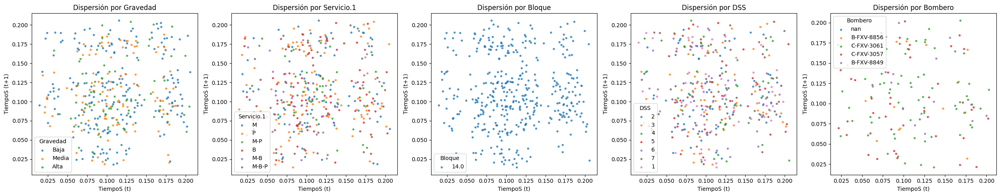

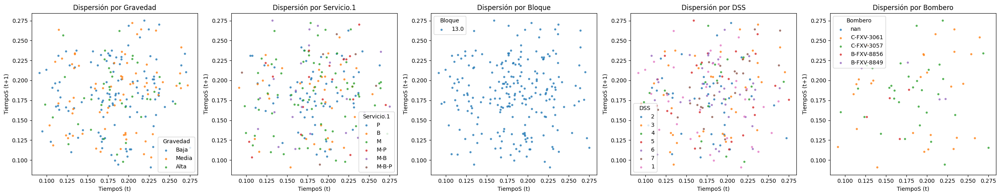

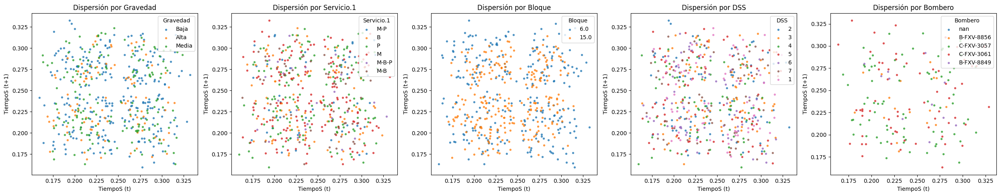

In [ ]:
# @title Se separan 4 y 14, por diferencias de media muy altas.
grupos = [[16],[4,14],[4],[14],[13],[6,15]]
variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS','Bombero']
for grupo in grupos:
  filtro = base[base['Bloque'].isin(grupo)]
  dispercion_porgrupos("S", variables, filtro)

In [ ]:
# @title Version de los bloques, seapados segun las primeras pruebas.
grupos = [[16],[4,14],[4],[14],[13],[6,15]]
variables = ['Gravedad', 'Servicio.1',"Amb","Bombero","Part", 'Bloque', 'DS']
resultados = []
for j in grupos:
  filtro = base[base['Bloque'].isin(j)]
  for i in variables:
    k="TiempoS"
    if i =="DS":
      i = "DSS"
    pruebas_independencia(filtro, i, k)
    pruebas_homogeneidad(filtro, i, k)
  prueba_ajuste_exponencial(filtro, k)
  for resultado in resultados:
    if len(resultado) == 6:
      resultado.append(j)

df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa',"Grupo"])
sacar_informacion(df_resultados,f"TS-Bloques-V2")

[distfit] >INFO> fit
[distfit] >INFO> transform
[distfit] >INFO> [norm      ] [0.00 sec] [RSS: 70.3753] [loc=0.287 scale=0.052]
[distfit] >INFO> [expon     ] [0.00 sec] [RSS: 108.157] [loc=0.190 scale=0.097]
[distfit] >INFO> [pareto    ] [0.00 sec] [RSS: 108.157] [loc=-8388607.810 scale=8388608.000]
[distfit] >INFO> [dweibull  ] [0.01 sec] [RSS: 69.5646] [loc=0.293 scale=0.050]
[distfit] >INFO> [t         ] [0.15 sec] [RSS: 70.3751] [loc=0.287 scale=0.052]
[distfit] >INFO> [genextreme] [0.14 sec] [RSS: 67.8555] [loc=0.270 scale=0.052]
[distfit] >INFO> [gamma     ] [0.07 sec] [RSS: 70.1569] [loc=-0.610 scale=0.003]
[distfit] >INFO> [lognorm   ] [0.00 sec] [RSS: 69.9075] [loc=-0.213 scale=0.497]
[distfit] >INFO> [beta      ] [0.04 sec] [RSS: 45.0158] [loc=0.190 scale=0.194]
[distfit] >INFO> [uniform   ] [0.00 sec] [RSS: 48.9481] [loc=0.190 scale=0.193]
[distfit] >INFO> [loggamma  ] [0.06 sec] [RSS: 70.2284] [loc=-11.566 scale=1.702]
[distfit] >INFO> [norm      ] [0.54 sec] [RSS: 70.3753]

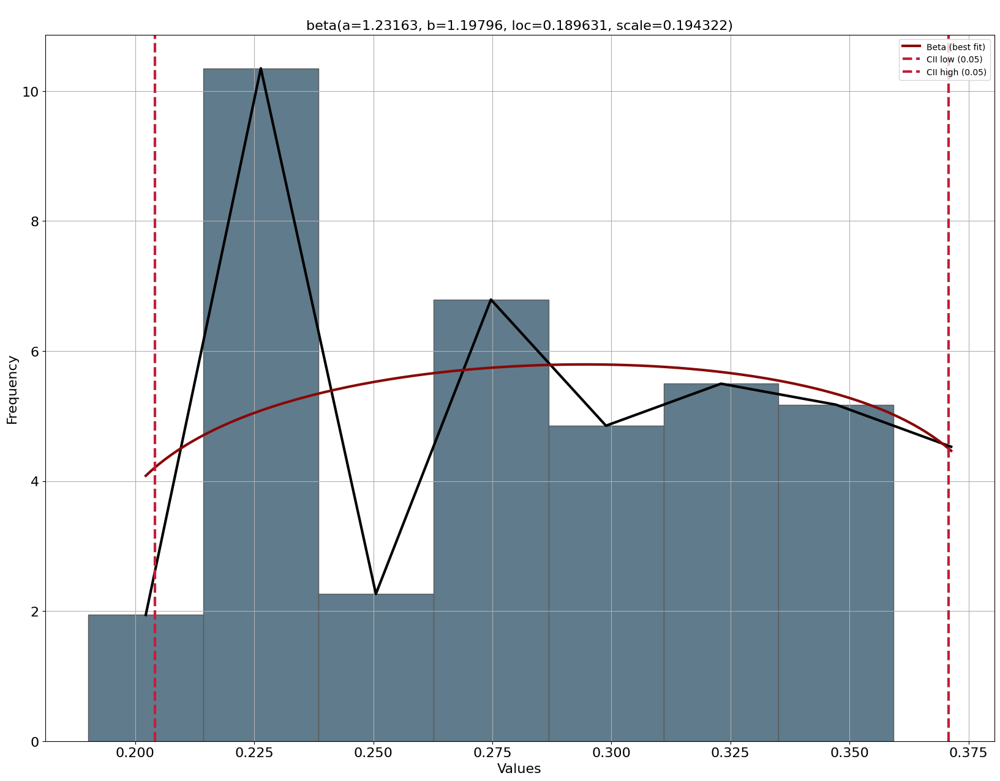

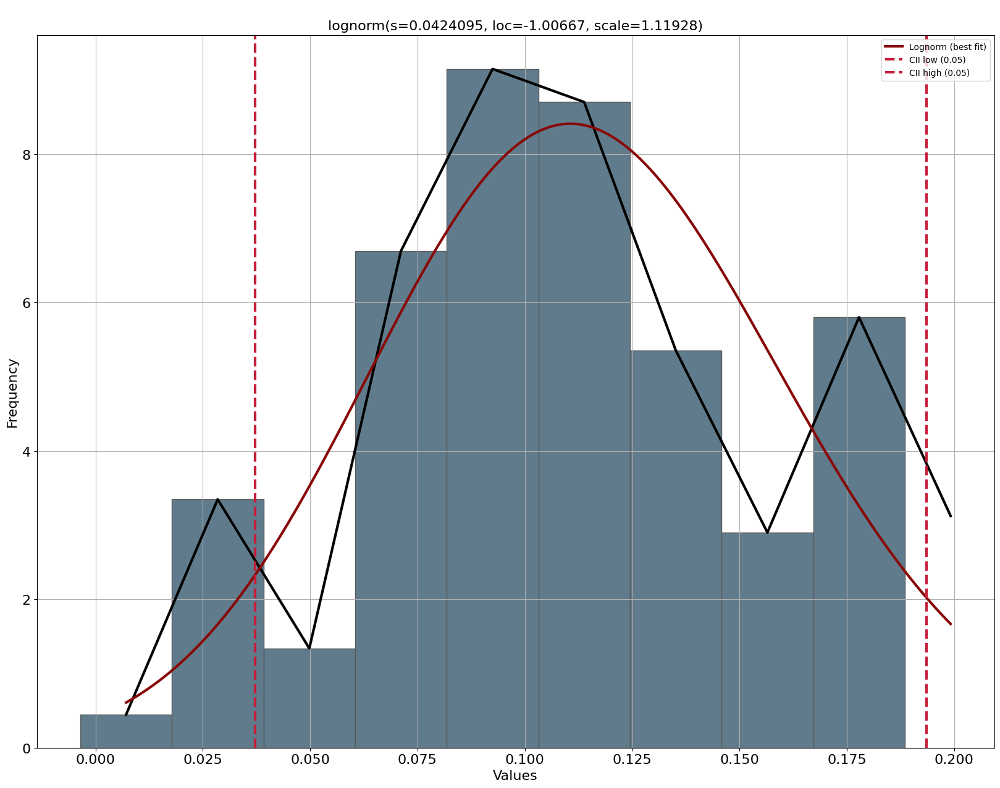

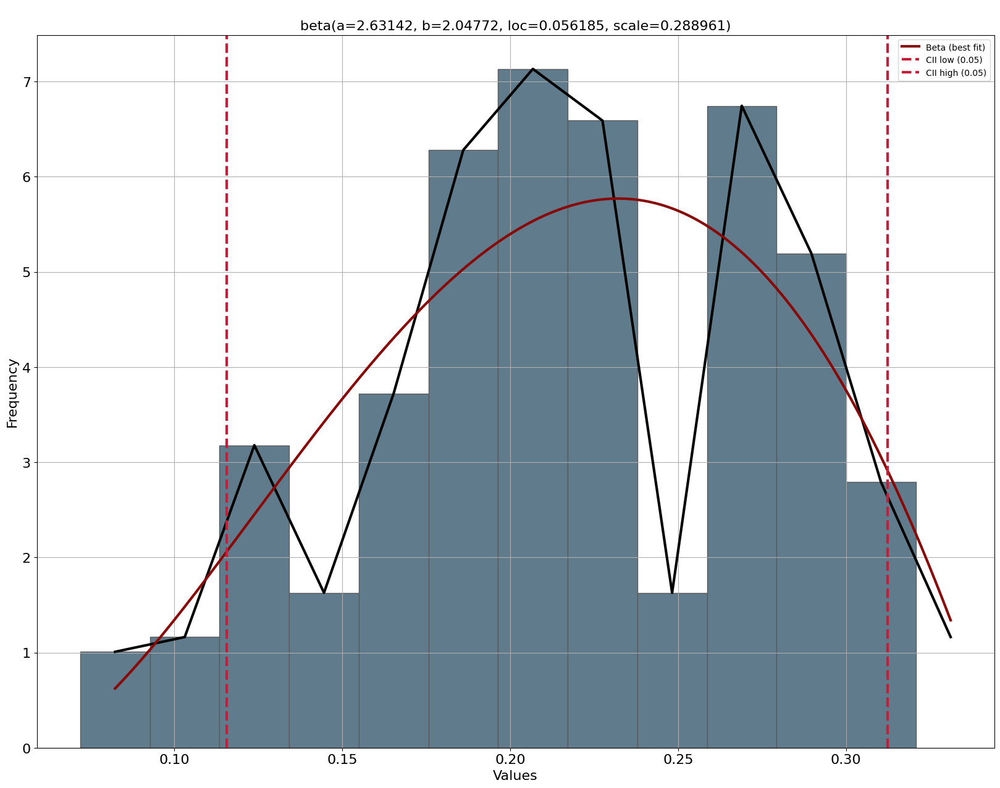

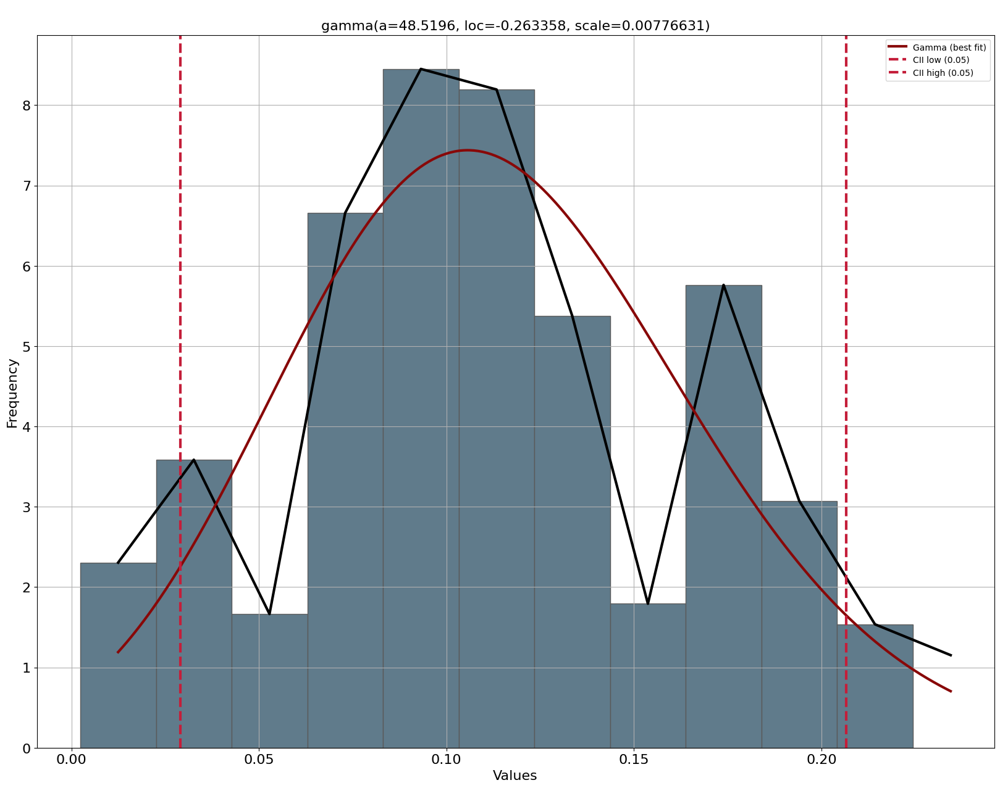

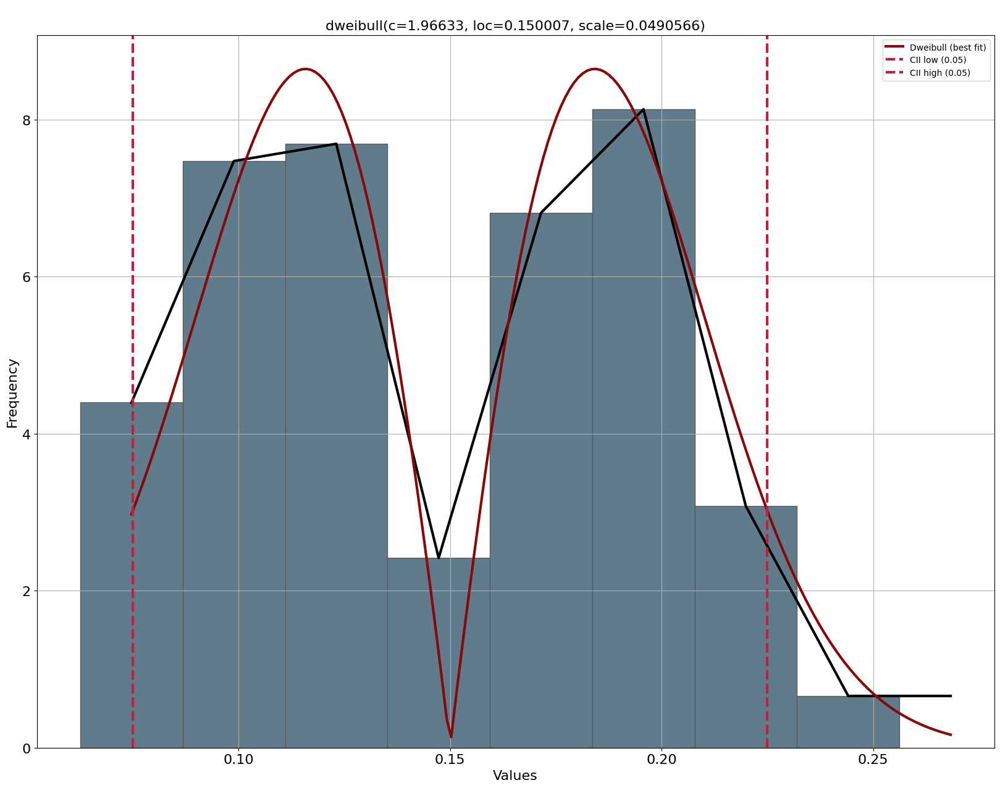

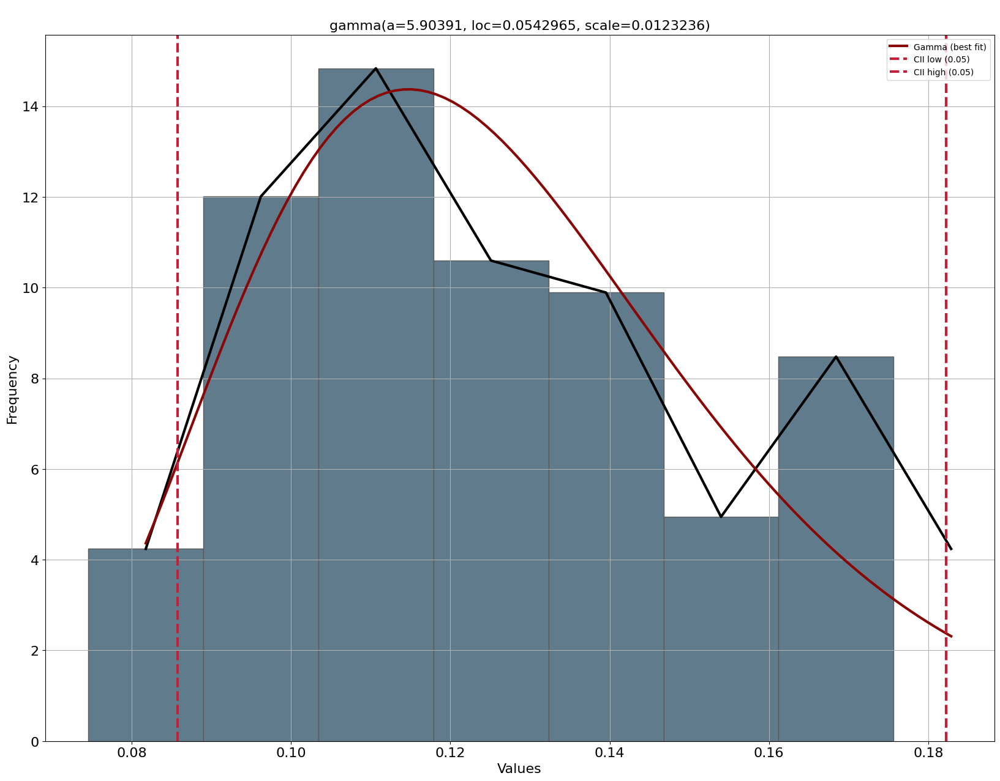

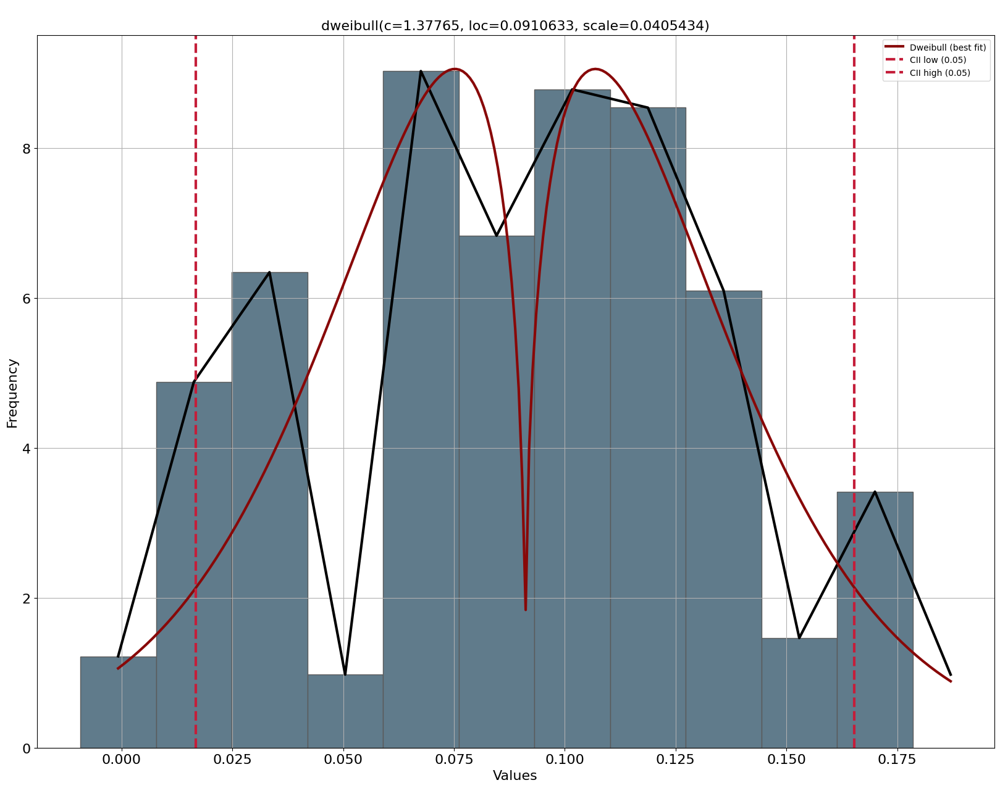

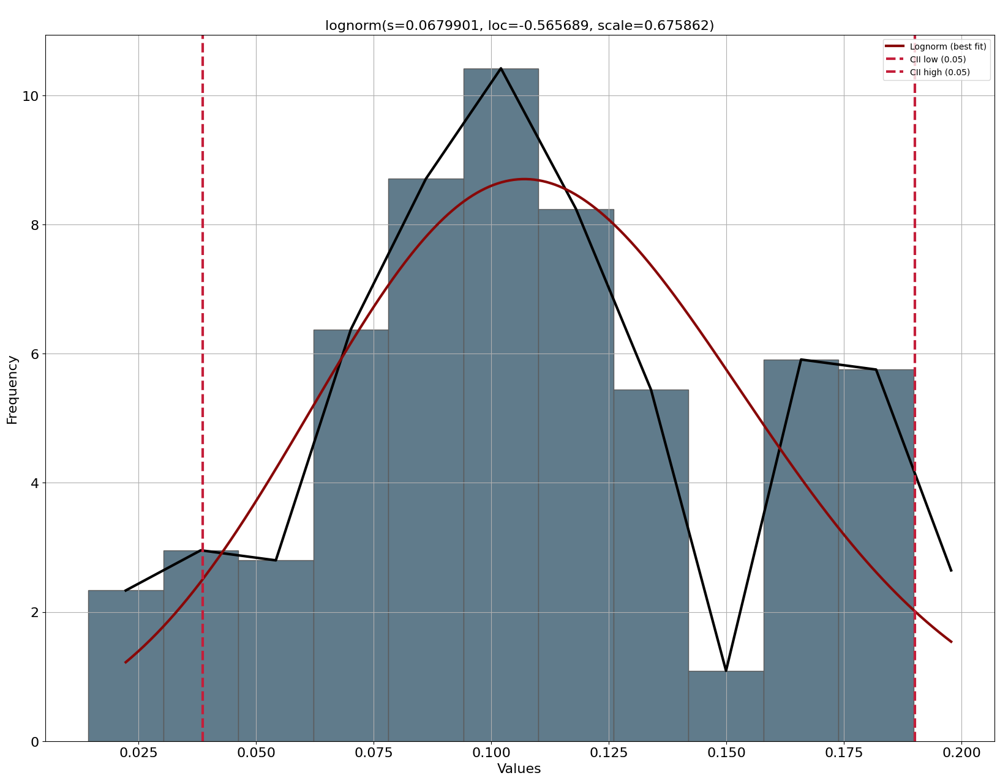

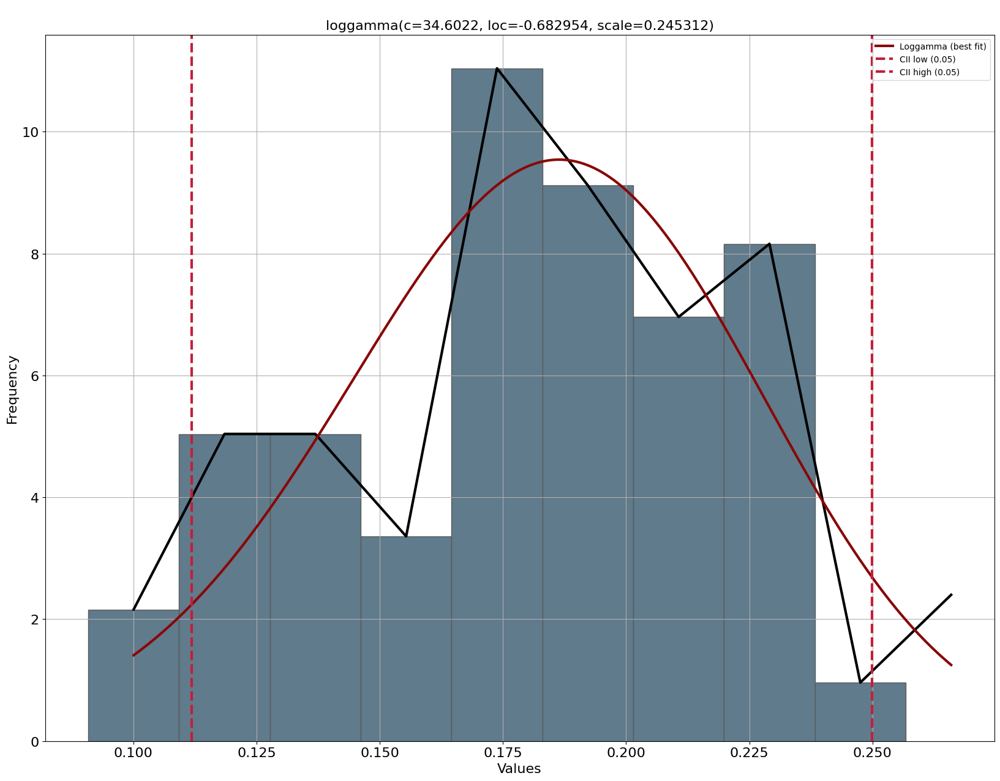

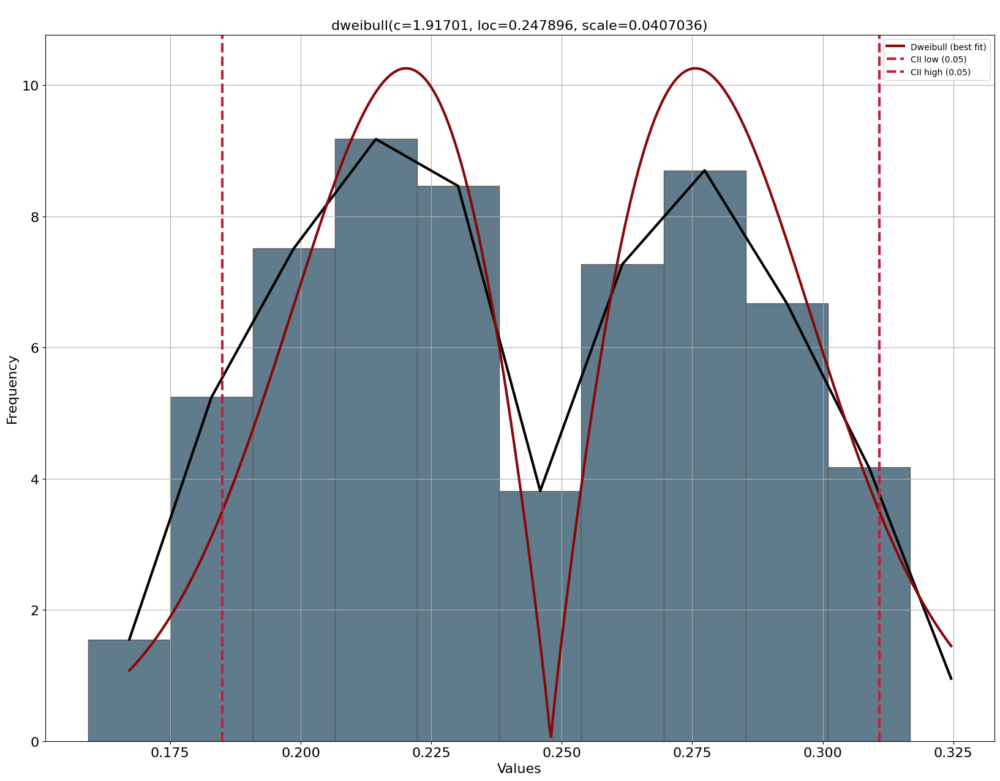

In [ ]:
# @title Sacando FDP de los grupos
grupos = [[7,12],[1,11],[3,10],[5,9],[2,8],[16],[4],[14],[13],[6,15]]
resultados = pd.DataFrame()
for i in grupos:
  filtro = base[base['Bloque'].isin(i)]
  dfit = distfit()
  resultado = dfit.fit_transform(filtro['TiempoS'])
  resultado['summary']['Bloque'] = [str(i)] * len(resultado['summary'])
  resultados = pd.concat([resultados, resultado['summary']])
  dfit.plot()

sacar_informacion(resultados, f"FDP Tiempo Salida de Central")

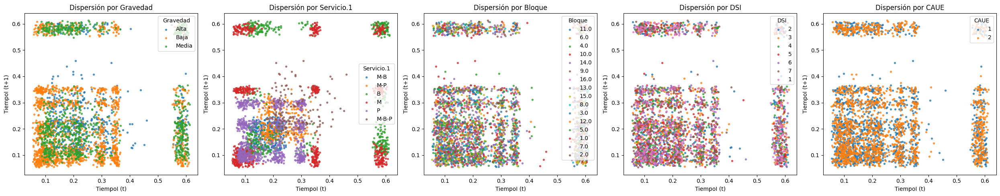

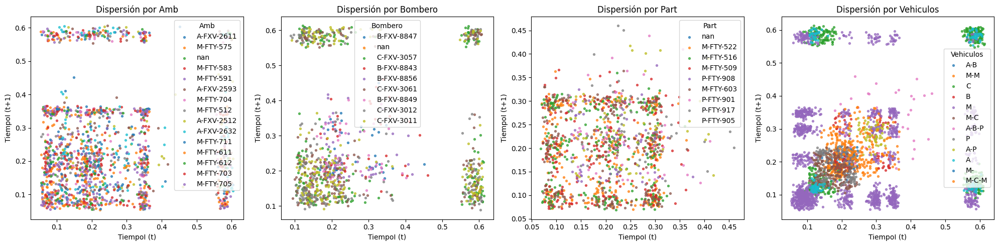

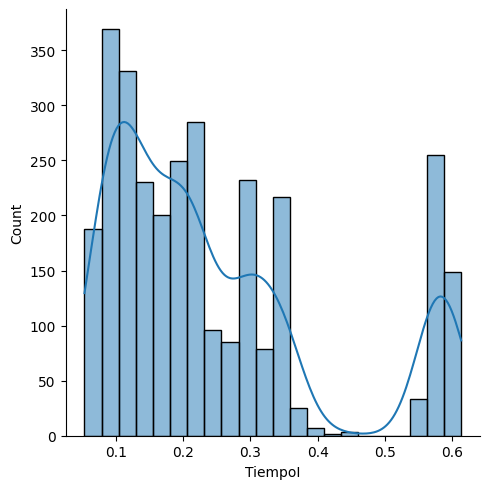

In [ ]:
# @title Tiempo de llegada a incidente
# @markdown En este tiempo, se perciben clusteres en Tipo de Servicio, Gravedad y el Patrullero.
variables = ['Gravedad', 'Servicio.1', 'Bloque', 'DS','CAUE']
dispercion("I", variables)
variables = ["Amb","Bombero","Part","Vehiculos"]
dispercion("I", variables)
sns.displot(data=base, x="TiempoI", kde=True)

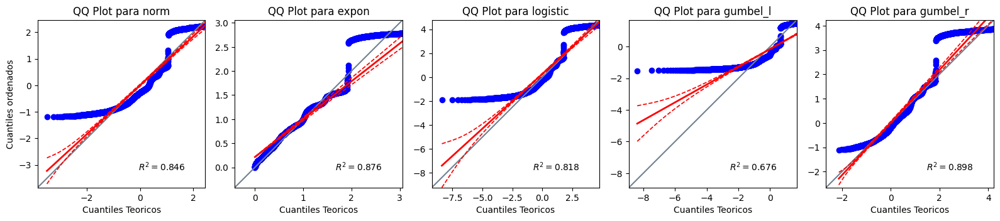

In [ ]:
# @title QQ-Plot
graficos_QQPLOT("TiempoI")

In [ ]:
# @title Pruebas de independencia y homogeneidad.
# @markdown Se comprueba lo que los gráficos de dispercion decian, no existe homogeneidad en Servicio, Gravedad, Amb, Bombero, Patrulleros, Vehiculos. Por lo que primero se empieza separando por el grupo más grande y que abarca más segregación, Tipo de Servicio.
variables = ['Gravedad', 'Servicio.1',"Amb","Bombero","Part","Vehiculos","Servidores", 'Bloque', 'DS','CAUE']
resultados = []
for i in variables:
  j="TiempoI"
  if i =="DS":
    i = "DSI"
  pruebas_independencia(base, i, j)
  pruebas_homogeneidad(base, i, j)

df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa'])
sacar_informacion(df_resultados,"Tiempo de Llegada a Incidente")

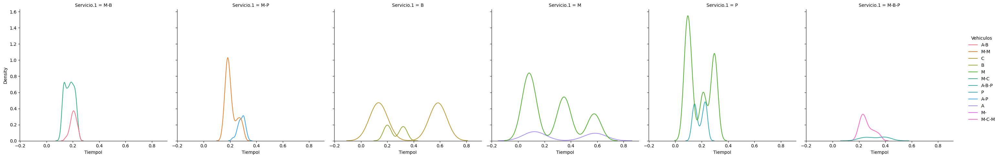

In [ ]:
# @title Se sacan los indicadores de Tipo de servicio para agrupar.
# @markdown Además se espera que se deba separar por tipo de vehiculos implementados, y posiblemente los servidores y la gravedad. Se agregan por servicios [['M-B-P'],['M-B','M-P'],[M,B],[P]]
resultados = []
for i in base['Servicio.1'].unique():
  filtro = base[base['Servicio.1']==i]
  media = filtro['TiempoI'].mean()
  varianza = filtro['TiempoI'].var()
  desviacion = filtro['TiempoI'].std()
  resultados.append([i, media, varianza, desviacion])
df_resultados = pd.DataFrame(resultados, columns=['Tipo de Servicio', 'Media', 'Varianza', 'Desviacion'])
sacar_informacion(df_resultados,"TI-TipoServicio-Mean-Desv")

sns.color_palette()
sns.displot(data=base, x="TiempoI", col="Servicio.1", hue="Vehiculos", kind ="kde" )

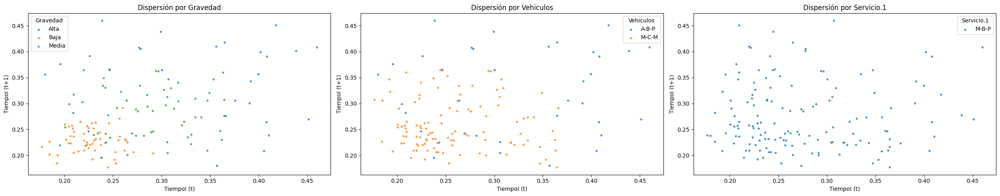

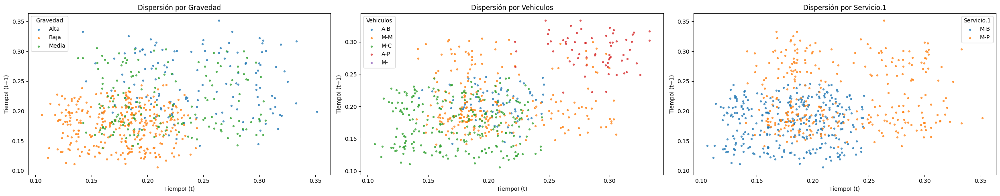

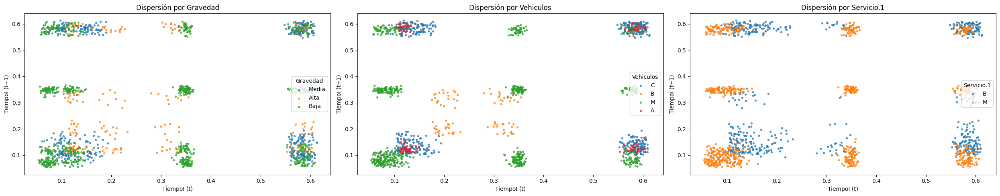

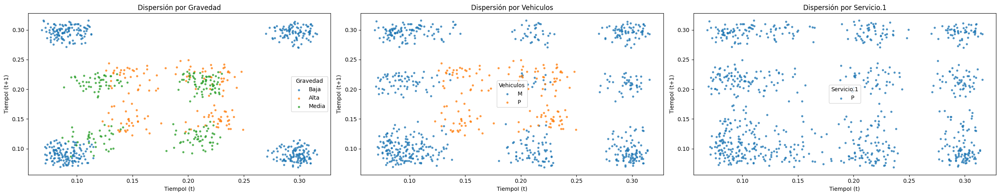

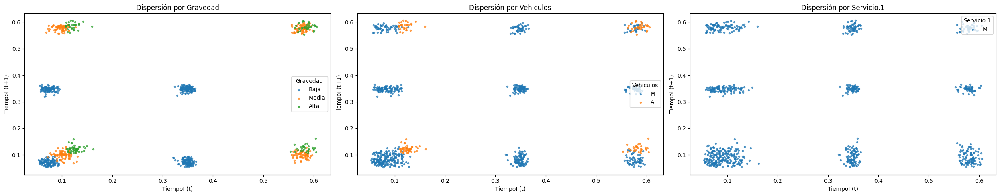

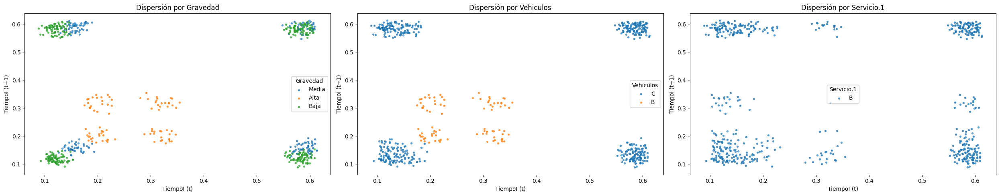

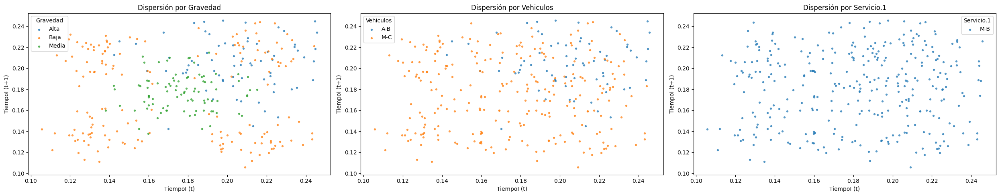

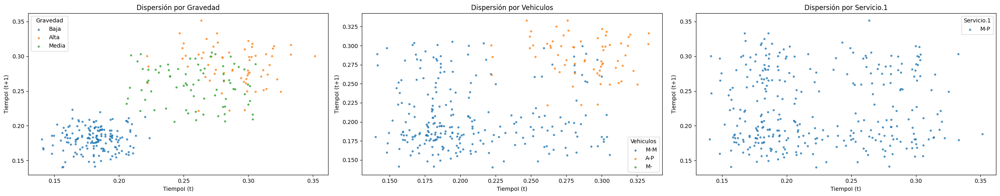

In [ ]:
# @title Se decide separa, todo de forma independiente.
grupos = [['M-B-P'],['M-B','M-P'],['M','B'],['P'],['M'],['B'],['M-B'],['M-P']]
variables = ["Gravedad","Vehiculos","Servicio.1"]
for i in grupos:
  filtro = base[base['Servicio.1'].isin(i)]
  dispercion_porgrupos("I", variables, filtro)

In [ ]:
# @title Tras las pruebas todos los grupos necesitan segregarse por la gravedad y algunos por vehiculos.

variables = ['Gravedad', 'Servicio.1',"Vehiculos","Servidores", 'Bloque', 'DS','CAUE']
resultados = []
for k in grupos:
  filtro = base[base['Servicio.1'].isin(k)]
  for i in variables:
    j="TiempoI"
    if i =="DS":
      i = "DSI"
    pruebas_independencia(filtro, i, j)
    pruebas_homogeneidad(filtro, i, j)
  prueba_ajuste_exponencial(filtro, j)
  for resultado in resultados:
    if len(resultado) == 6:
      resultado.append(k)

df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa', 'Tipo de Servicio'])
sacar_informacion(df_resultados,"TI-TipoServicio")

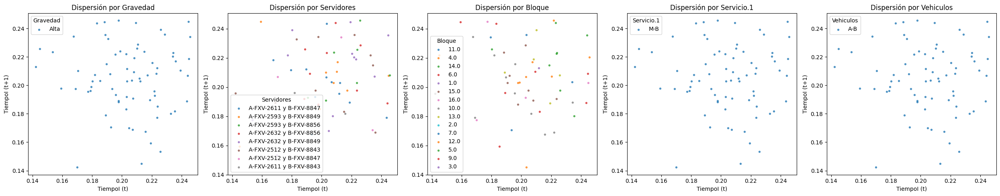

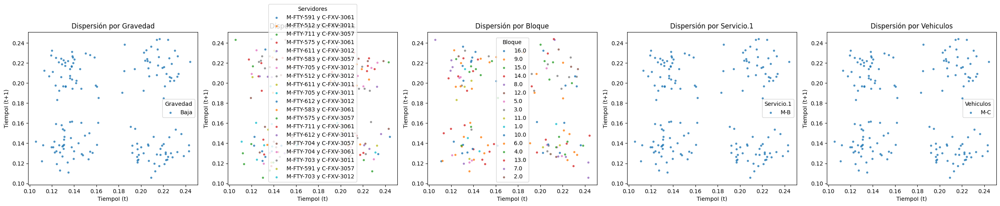

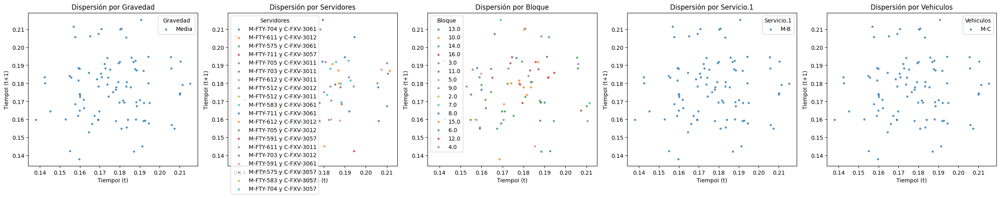

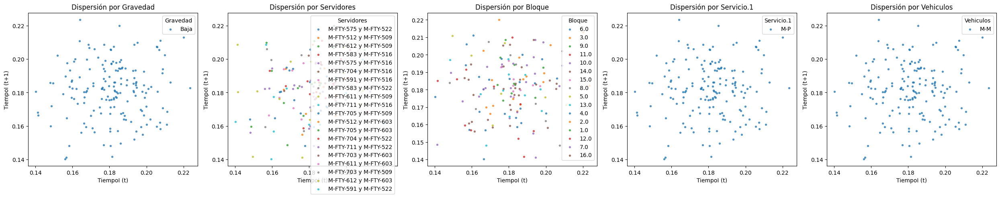

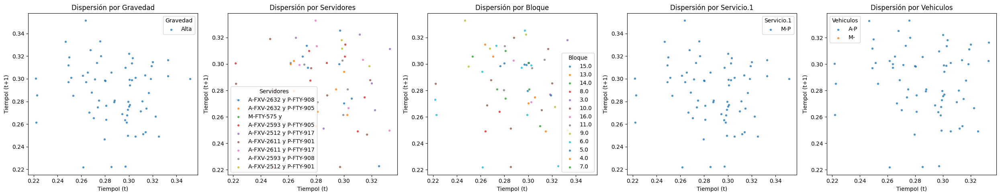

...

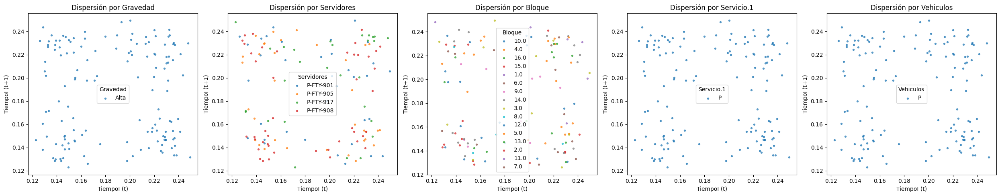

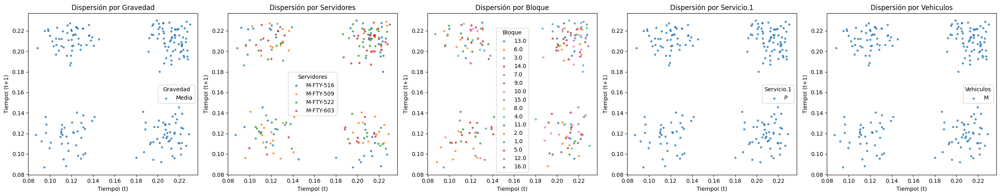

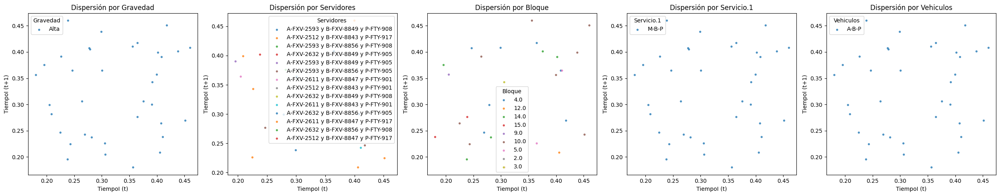

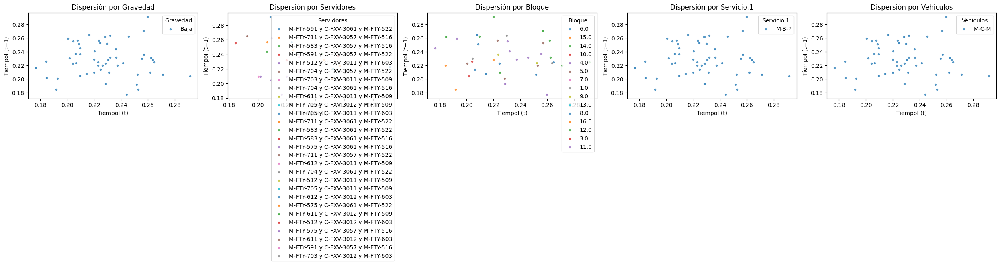

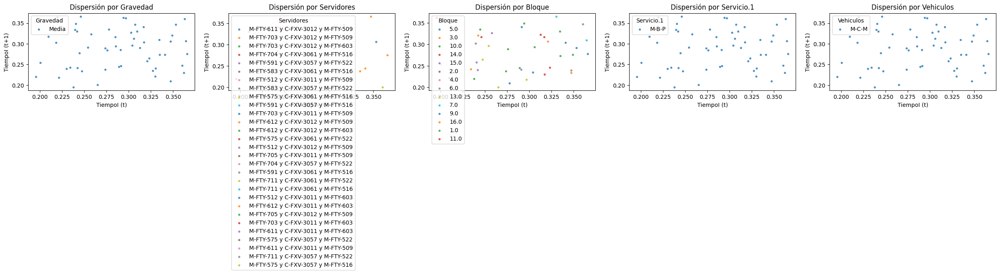

In [ ]:
# @title Primero se separa por Gravedad, se observa que la mayoria necesita por separado con dos excepciones.
# @markdown El servicio de Bombero que se debe agrupar [["Baja","Media"], ["Alta"]] y el Medico que debe ser [["Baja"], ["Media","Alta"]] para poder segregar bien.
variables = ['Gravedad',"Servidores", 'Bloque', 'Servicio.1','Vehiculos']
for i in base['Servicio.1'].unique():
  filtro = base[base['Servicio.1']==i]
  for j in filtro['Gravedad'].unique():
    filtro2 = filtro[filtro['Gravedad']==j]
    dispercion_porgrupos("I", variables, filtro2)

In [ ]:
# @title Prueba de independecia y homogeneidad
# @markdown Tras los resultados de esta prueba se determina que necesariamente todo debe estar separado por Gravedad, porque los grupos que se hicieron en M y B, pero se respaldara con una boxplot (cajas y bigotes).
gruposB =  [["Baja","Media"], ["Alta"]]
gruposM = [["Baja"], ["Media","Alta"]]
variables = ['Gravedad', "Vehiculos","Servidores", 'Bloque', 'DS', 'CAUE']
resultados = []
w = "TiempoI"
for k in base['Servicio.1'].unique():
  filtro = base[base['Servicio.1']==k]
  if k == "B":
    for j in gruposB:
      filtro2 = filtro[filtro['Gravedad'].isin(j)]
      for i in variables:
        if i =="DS":
          i = "DSI"
        pruebas_independencia(filtro2, i, w)
        pruebas_homogeneidad(filtro2, i, w)
      prueba_ajuste_exponencial(filtro2, w)
      for resultado in resultados:
        if len(resultado) == 6:
          resultado.append(k)
          resultado.append(j)
  elif k == "M":
    for j in gruposM:
      filtro2 = filtro[filtro['Gravedad'].isin(j)]
      for i in variables:
        if i =="DS":
          i = "DSI"
        pruebas_independencia(filtro2, i, w)
        pruebas_homogeneidad(filtro2, i, w)
      prueba_ajuste_exponencial(filtro2, w)
      for resultado in resultados:
        if len(resultado) == 6:
          resultado.append(k)
          resultado.append(j)
  else:
    for j in filtro['Gravedad'].unique():
      filtro2 = filtro[filtro['Gravedad']==j]
      for i in variables:
        if i =="DS":
          i = "DSI"
        pruebas_independencia(filtro2, i, w)
        pruebas_homogeneidad(filtro2, i, w)
      prueba_ajuste_exponencial(filtro2,w)
      for resultado in resultados:
        if len(resultado) == 6:
          resultado.append(k)
          resultado.append(j)

df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa',"Tipo de Servicio","Gravedad"])
sacar_informacion(df_resultados,"TI-ServiciosV2")

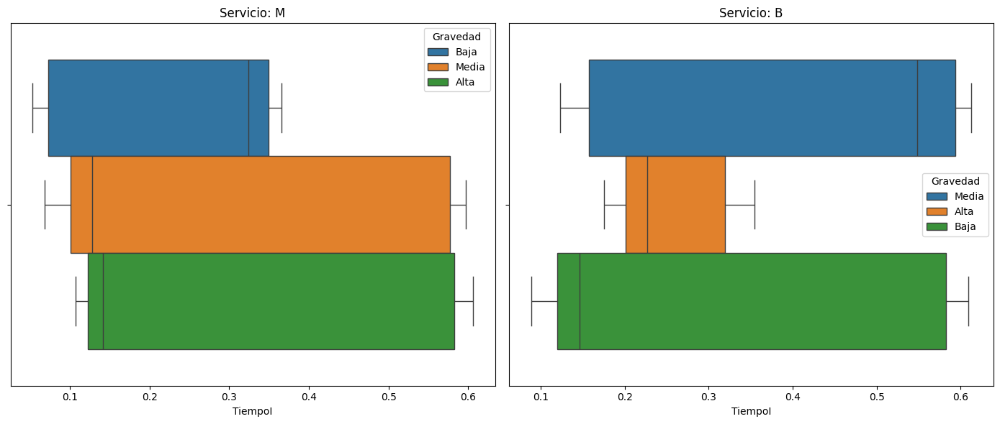

In [ ]:
# @title BoxPlot del servicio de Medico y Bomberos.
# @markdown Se determina que del servicio de Bomberos si es necesario seaparar, y aunque del servicio Medico no se percibe una gran diferencia entre Gravedad Media y Alta, dado que no paso las pruebas y que si se percibe una diferencia, se separan.
filtro_M = base[base['Servicio.1'] == "M"]
filtro_B = base[base['Servicio.1'] == "B"]
fig, axes = plt.subplots(1, 2, figsize=(14, 6), sharey=True)
sns.boxplot(data=filtro_M, x='TiempoI', hue="Gravedad", ax=axes[0])
axes[0].set_title("Servicio: M")
axes[0].set_xlabel("TiempoI")
axes[0].set_ylabel("")

sns.boxplot(data=filtro_B, x='TiempoI', hue="Gravedad", ax=axes[1])
axes[1].set_title("Servicio: B")
axes[1].set_xlabel("TiempoI")
axes[1].set_ylabel("")

plt.tight_layout()
plt.show()

In [ ]:
# @title Visto bueno pasa la mayoria de pruebas a excepción del Servicio "M-P" para gravedad "Baja".
# @markdown Se da VoBo porque no representa diferencias muy significativas, además si se usas una confianza del 98% pasaria todas las pruebas sin problemas.
resultados = []
w = "TiempoI"
for k in base['Servicio.1'].unique():
  filtro = base[base['Servicio.1']==k]
  for j in filtro['Gravedad'].unique():
        filtro2 = filtro[filtro['Gravedad']==j]
        for i in variables:
          if i =="DS":
            i = "DSI"
          pruebas_independencia(filtro2, i, w)
          pruebas_homogeneidad(filtro2, i, w)
        prueba_ajuste_exponencial(filtro2,w)
        for resultado in resultados:
          if len(resultado) == 6:
            resultado.append(k)
            resultado.append(j)
df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa',"Tipo de Servicio","Gravedad"])
sacar_informacion(df_resultados,"TI-ServiciosV3")

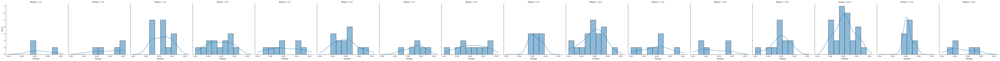

In [ ]:
# @title Vista de lo que no pasa las pruebas de homogeneidad.
filtro = base[base['Servicio.1'] == "M-P"]
filtro2 = filtro[filtro['Gravedad'] == "Baja"]

sns.displot(data=filtro2, x="TiempoI", col="Bloque",kde=True)

[distfit] >INFO> fit
[distfit] >INFO> transform
[distfit] >INFO> [norm      ] [0.00 sec] [RSS: 33.4423] [loc=0.205 scale=0.024]
[distfit] >INFO> [expon     ] [0.00 sec] [RSS: 538] [loc=0.142 scale=0.062]
[distfit] >INFO> [pareto    ] [0.00 sec] [RSS: 538] [loc=-3670015.858 scale=3670016.000]
[distfit] >INFO> [dweibull  ] [0.02 sec] [RSS: 47.0675] [loc=0.206 scale=0.020]
[distfit] >INFO> [t         ] [0.21 sec] [RSS: 33.4458] [loc=0.205 scale=0.024]
[distfit] >INFO> [genextreme] [0.05 sec] [RSS: 18.8686] [loc=0.198 scale=0.026]
[distfit] >INFO> [gamma     ] [0.10 sec] [RSS: 37.5902] [loc=-0.221 scale=0.001]
[distfit] >INFO> [lognorm   ] [0.00 sec] [RSS: 33.4429] [loc=-3331.461 scale=3331.666]
[distfit] >INFO> [beta      ] [0.05 sec] [RSS: 27.1112] [loc=0.133 scale=0.114]
[distfit] >INFO> [uniform   ] [0.00 sec] [RSS: 178.729] [loc=0.142 scale=0.103]
[distfit] >INFO> [loggamma  ] [0.03 sec] [RSS: 28.8552] [loc=0.144 scale=0.046]
[distfit] >INFO> [norm      ] [0.54 sec] [RSS: 33.4423] [lo

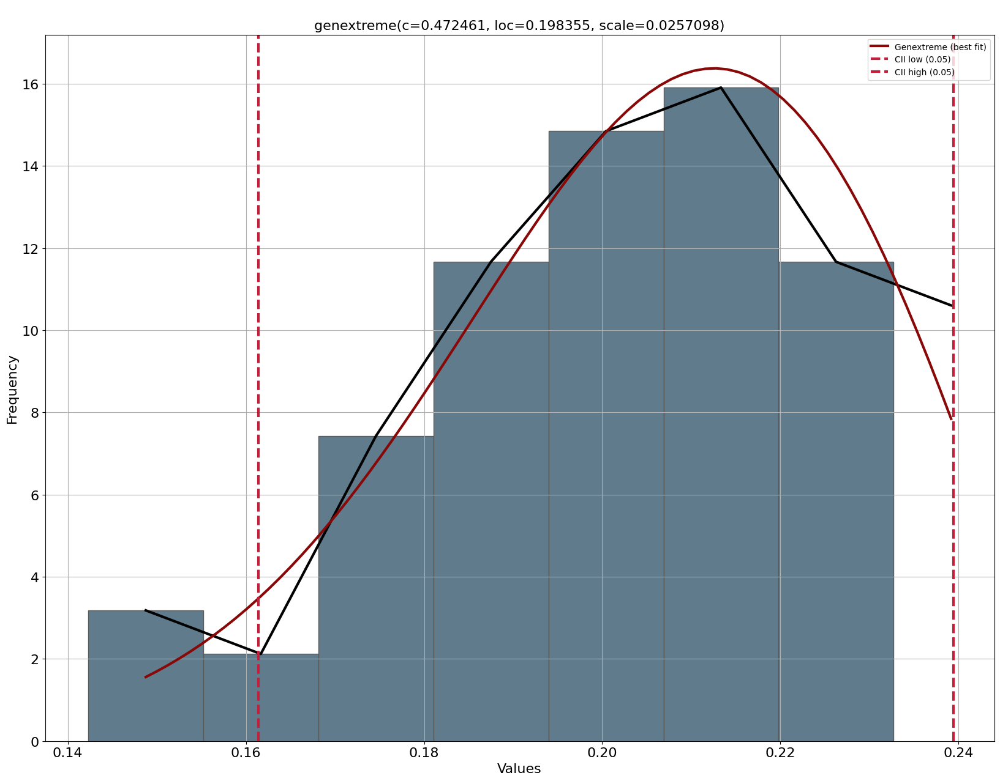

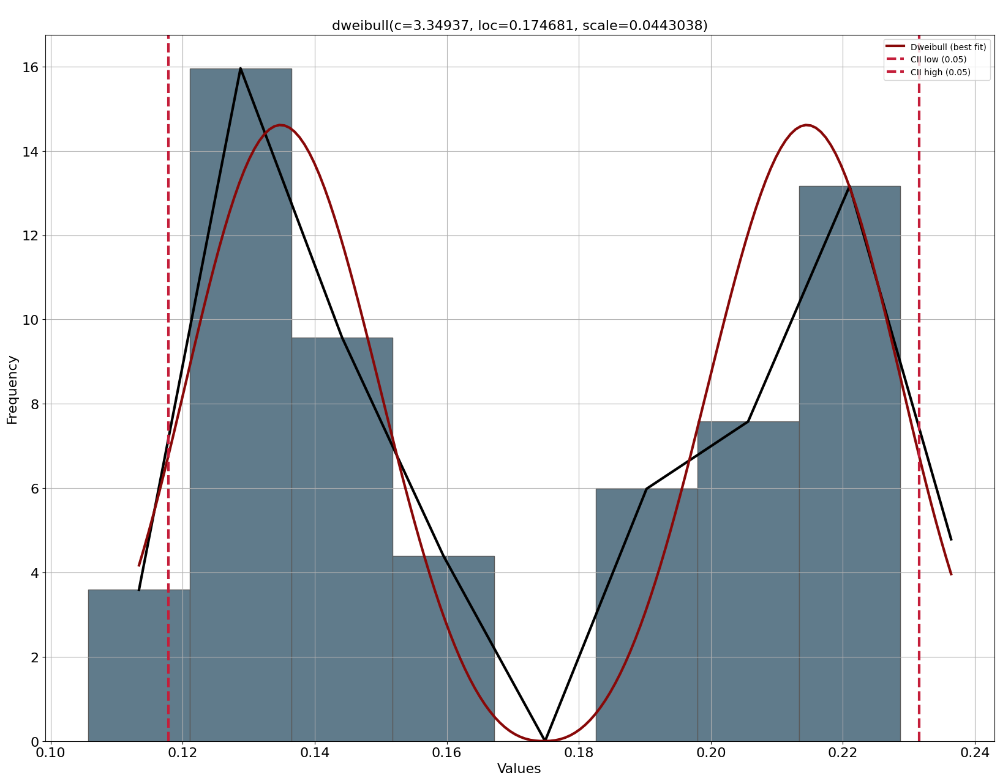

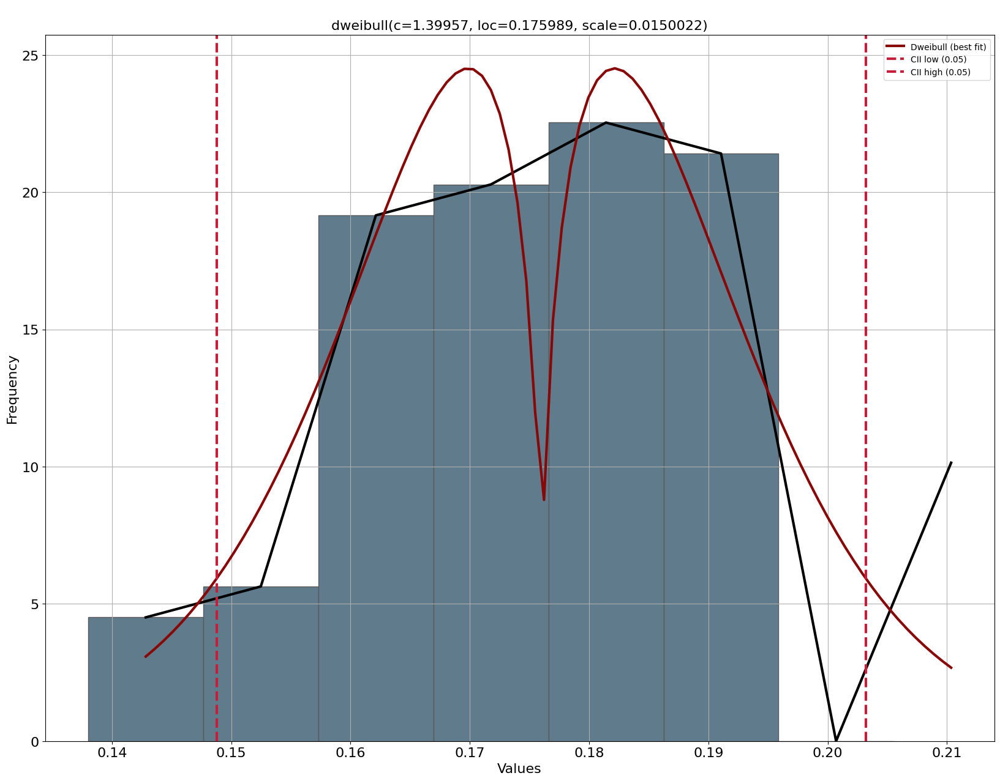

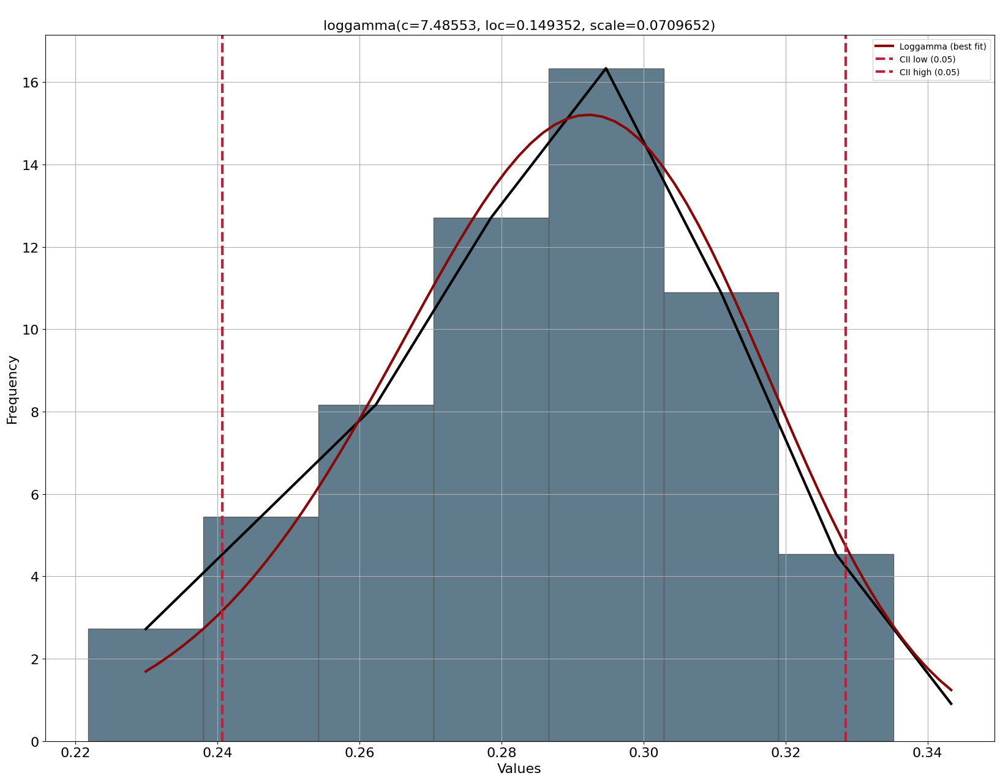

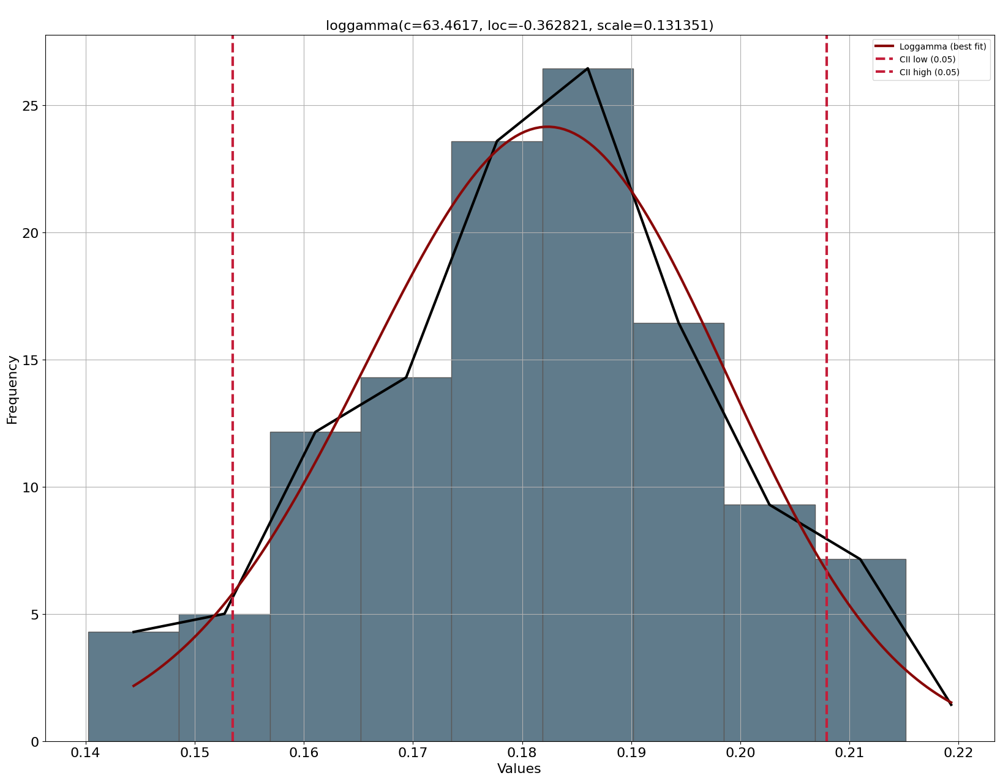

...

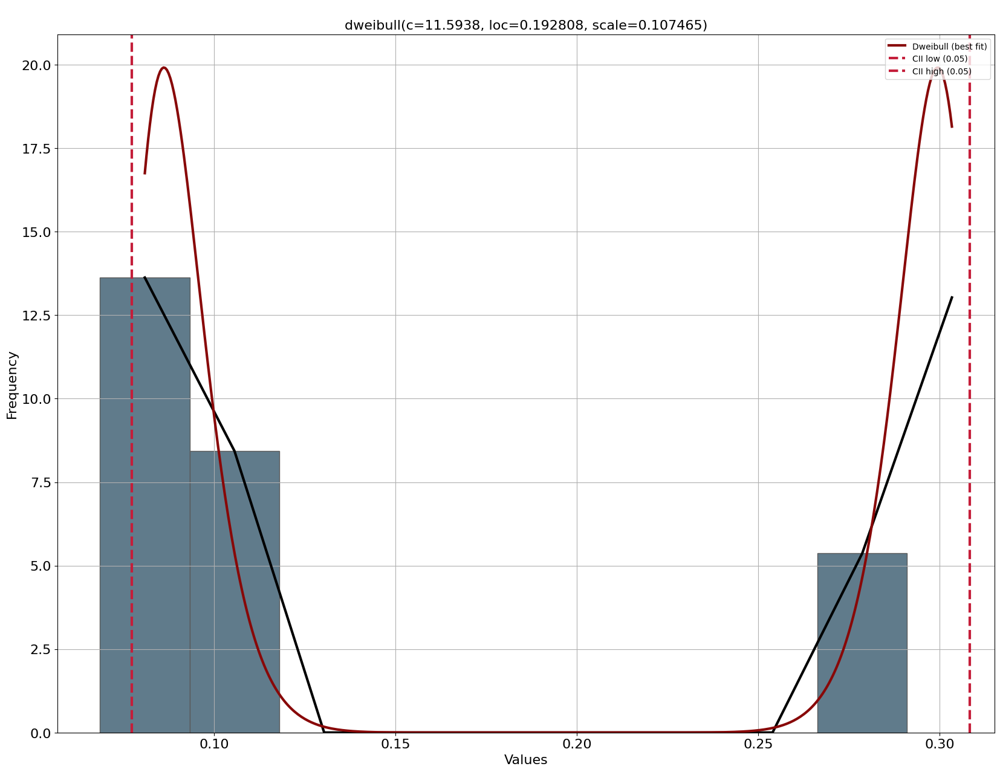

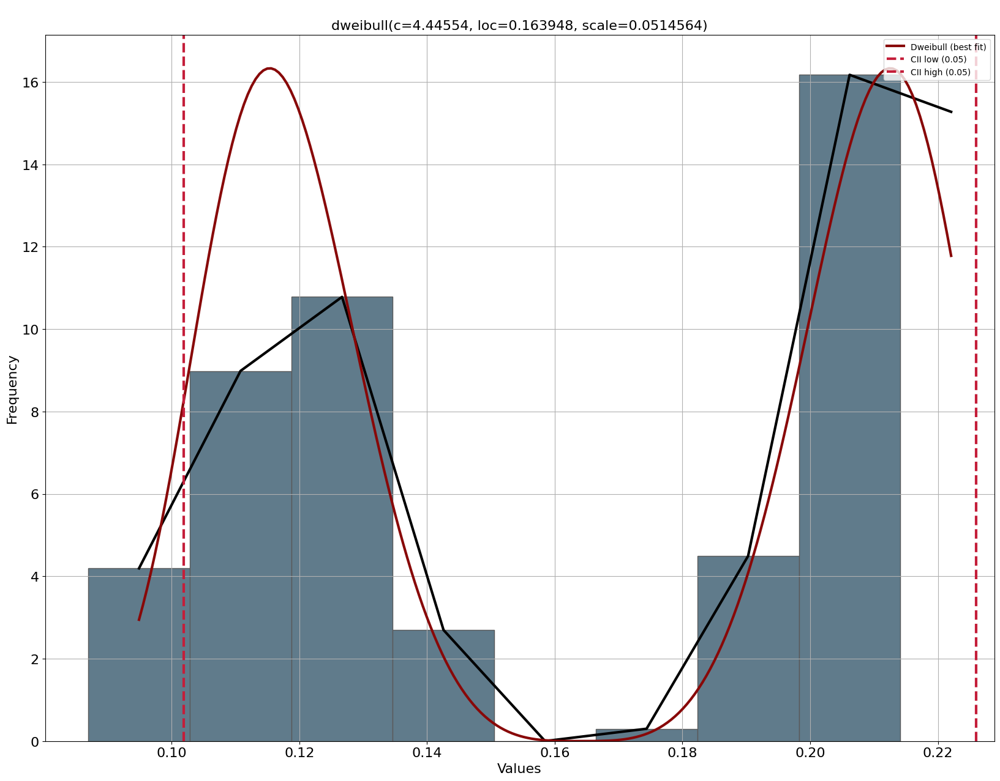

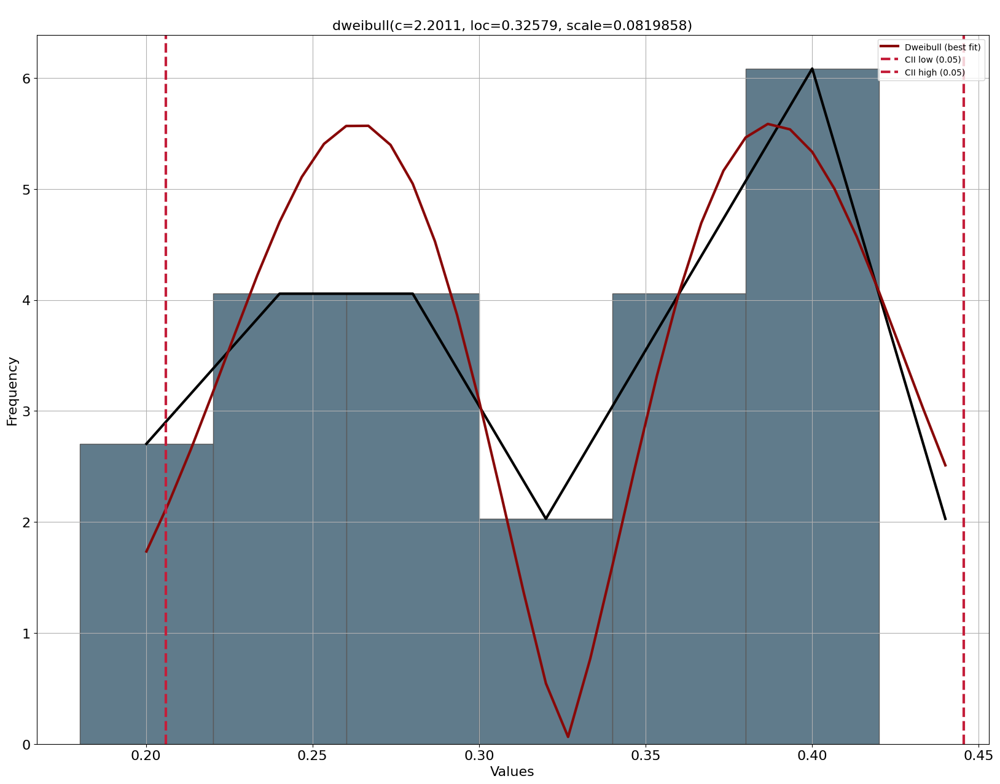

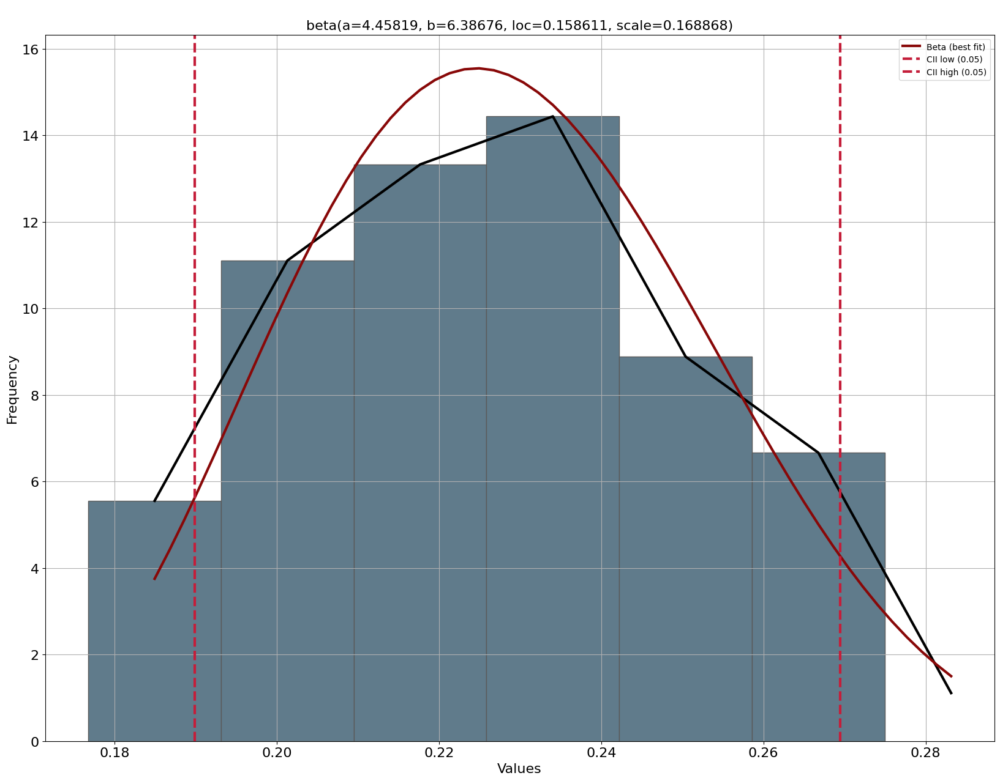

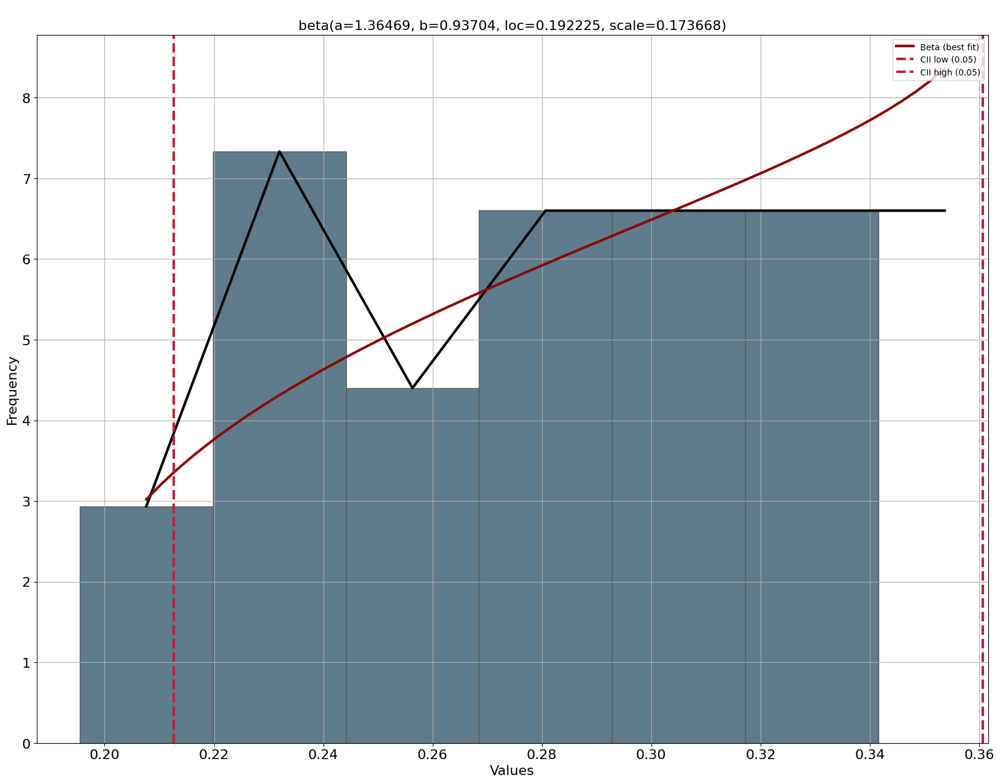

In [ ]:
# @title Se sacan la FDP para El tiempo de Llegada al Incidente.
resultados = pd.DataFrame()
for i in base['Servicio.1'].unique():
  filtro = base[base['Servicio.1'] == i]
  for j in base['Gravedad'].unique():
    filtro2 = filtro[filtro['Gravedad'] == j]
    dfit = distfit()
    resultado = dfit.fit_transform(filtro2['TiempoI'])
    resultado['summary']['Tipo de Servicio'] = [str(i)] * len(resultado['summary'])
    resultado['summary']['Gravedad'] = [str(j)] * len(resultado['summary'])
    resultados = pd.concat([resultados, resultado['summary']])
    dfit.plot()

sacar_informacion(resultados, f"FDP Tiempo Llegada Incidente")

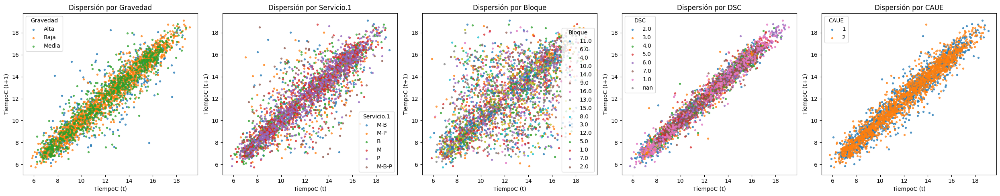

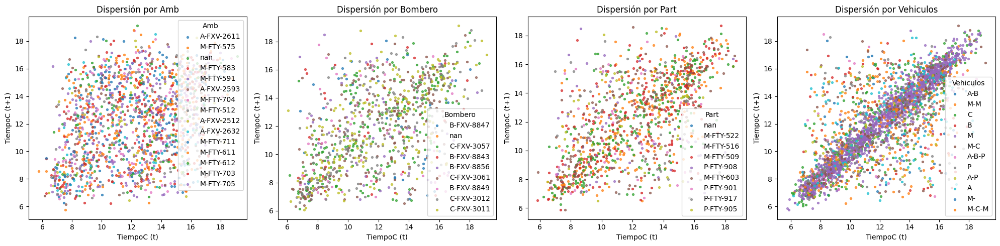

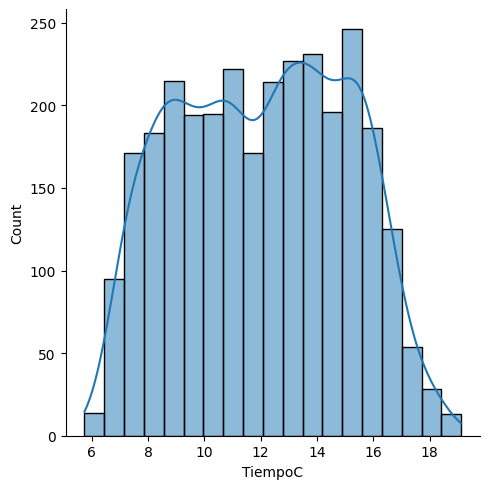

In [ ]:
# @title Tiempo de Llegada a la Central.
dispercion("C", ['Gravedad', 'Servicio.1', 'Bloque', 'DS','CAUE'])
dispercion("C", ['Amb', 'Bombero','Part','Vehiculos'])
sns.displot(data=base, x="TiempoC", kde=True)

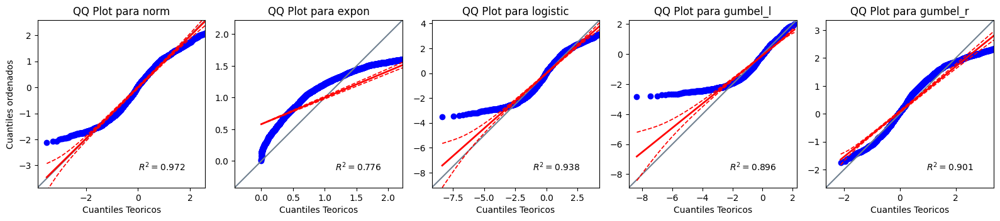

In [ ]:
# @title QQPlot
graficos_QQPLOT("TiempoC")

In [ ]:
# @title Pruebas de Independencia y Homogeneidad TiempoS
# @markdown Tras esta prueba se determina la no Homogeneidad entre el Tiempo de Llegada a la Central y el Día de la Semana en la que se hace este proceso. Por lo que se debe separar por esto.
variables = ['Gravedad', 'Servicio.1',"Amb","Bombero","Part","Vehiculos","Servidores", 'Bloque', 'DS','CAUE']
resultados = []
for i in variables:
  filtro = base[pd.notna(base["TiempoC"])]
  j="TiempoC"
  if i =="DS":
    i = "DSC"
  pruebas_independencia(filtro, i, j)
  pruebas_homogeneidad(filtro, i, j)
prueba_ajuste_exponencial(filtro, j)

df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa'])
sacar_informacion(df_resultados,"Tiempo de Llegada a la Central")

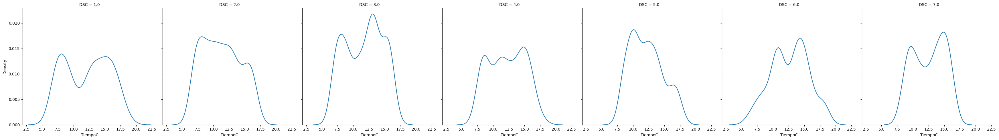

In [ ]:
# @title Se agrupan por dias por {2,3} y {1,4,6} y {5,7}
resultados = []
for i in base['DSC'].unique():
  filtro = base[base['DSC']==i]
  media = filtro['TiempoC'].mean()
  varianza = filtro['TiempoC'].var()
  desviacion = filtro['TiempoC'].std()
  resultados.append([i, media, varianza, desviacion])
df_resultados = pd.DataFrame(resultados, columns=['Dia de la semana', 'Media', 'Varianza', 'Desviacion'])
sacar_informacion(df_resultados,"TC-Dia-Mean-Desv")

sns.color_palette()
sns.displot(data=base, x="TiempoC", col="DSC", kind ="kde" )

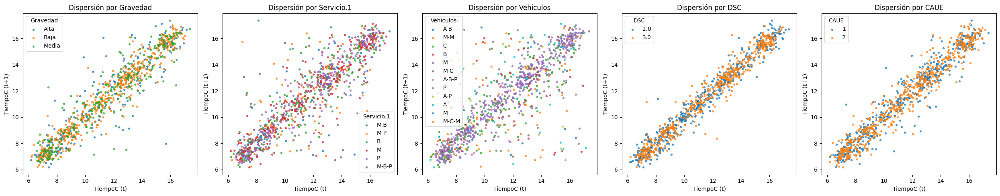

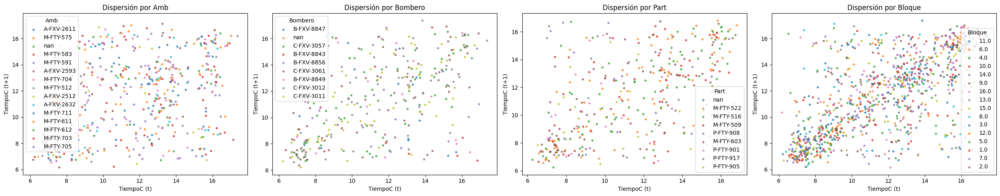

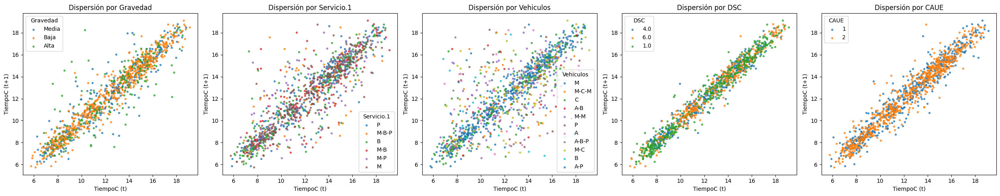

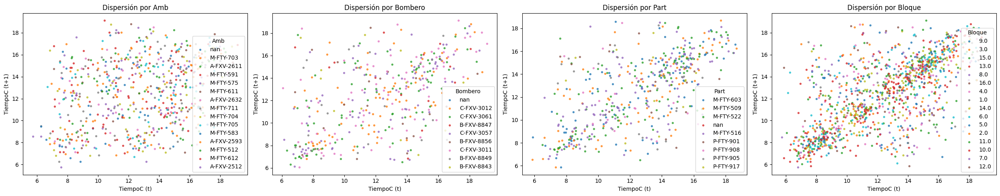

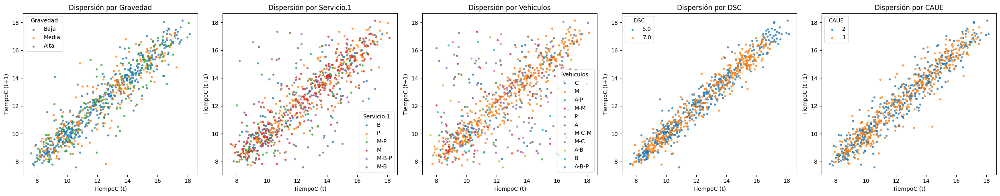

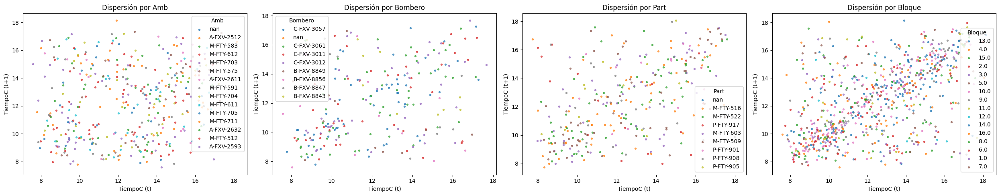

In [ ]:
# @title Gráficos de disperción para los grupos.
grupos = [[2,3],[1,4,6],[5,7]]
variables = ['Gravedad', 'Servicio.1',"Amb","Bombero","Part","Vehiculos","Servidores", 'Bloque', 'DS','CAUE']
for grupo in grupos:
  filtro = base[base['DSC'].isin(grupo)]
  dispercion_porgrupos("C", ["Gravedad","Servicio.1","Vehiculos","DSC","CAUE"], filtro)
  dispercion_porgrupos("C", ["Amb","Bombero","Part","Bloque"], filtro)

In [ ]:
# @title Ahora presenta no homogeneidad en los días de la semana 1, 4 y 7 en tipo de servicio por lo que se analizan y se hacen los siguientes grupos para dia [1] queda el servicio de Bombero por aparte y posiblemente quedara aparte M-B, para [4] queda
variables = ['Gravedad', 'Servicio.1',"Vehiculos","Amb","Bombero","Part", 'Bloque', 'DS','CAUE']
grupos = [[1],[2],[3],[4],[5],[6],[7]]
resultados = []
for k in grupos:
  filtro = base[base['DSC'].isin(k)]
  for i in variables:
    j="TiempoC"
    if i =="DS":
      i = "DSC"
    pruebas_independencia(filtro, i, j)
    pruebas_homogeneidad(filtro, i, j)
  prueba_ajuste_exponencial(filtro, j)
  for resultado in resultados:
    if len(resultado) == 6:
      resultado.append(k)

df_resultados = pd.DataFrame(resultados, columns=["Tipo_Prueba",'Test', 'Comparación', 'Resultados_varios', 'Valor_prueba', 'Pasa/No pasa', 'Dia_Semana'])
sacar_informacion(df_resultados,"TC-DiaSemanaV2")

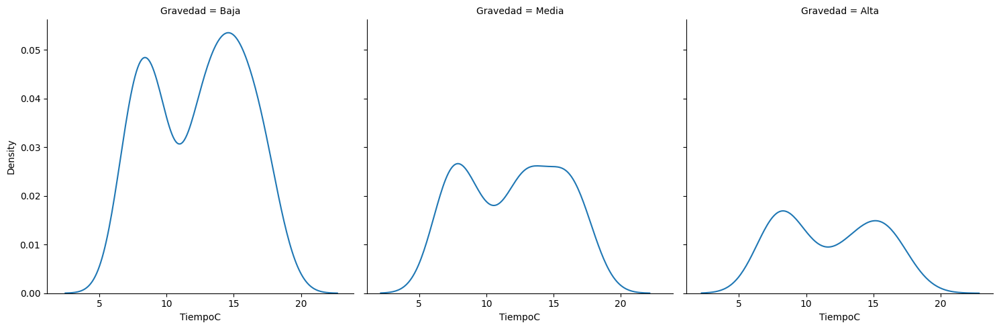

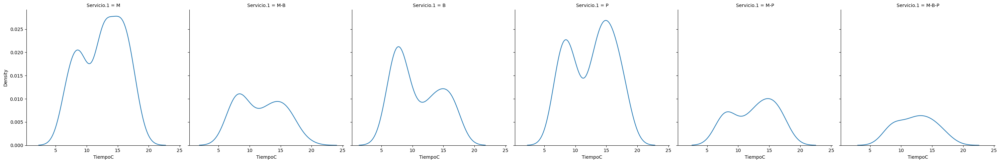

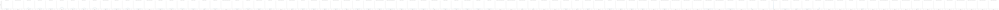

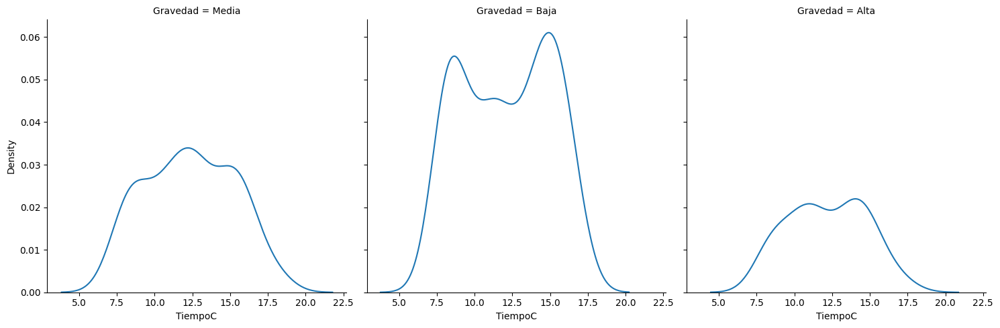

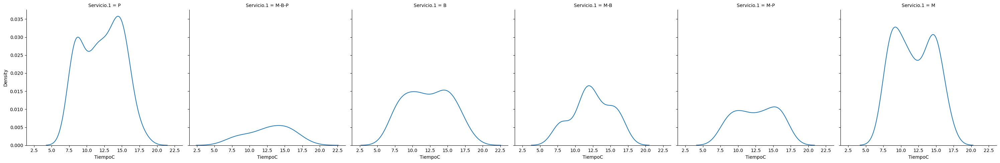

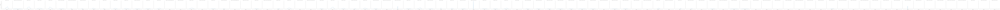

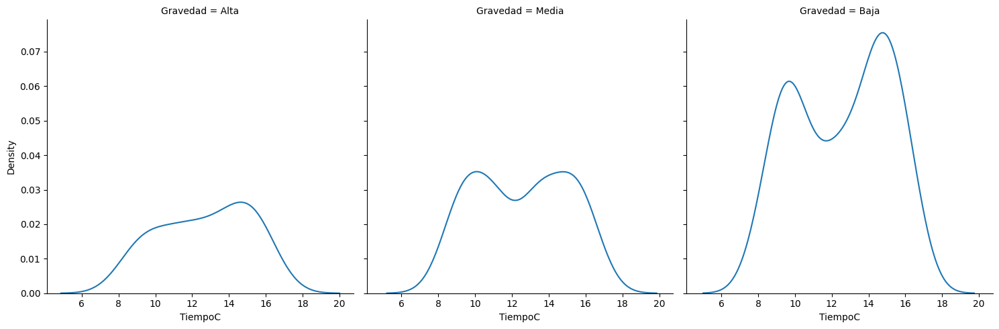

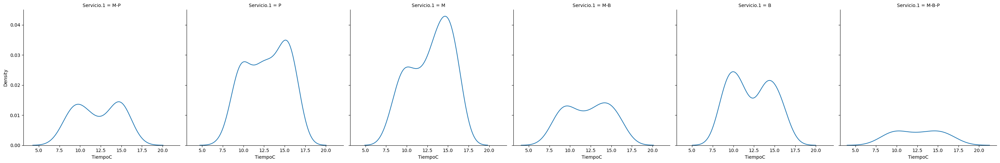

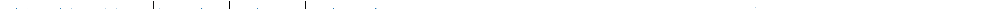

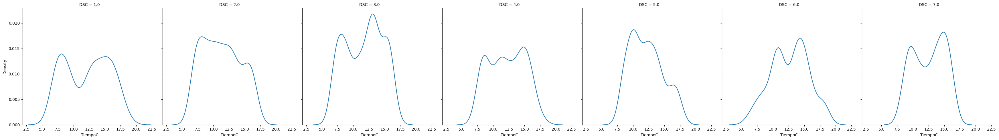

In [ ]:
# @title dias 7,4,1
# @markdown Es en este punto en donde se perciben inconsistencias en las homogeneidades de los Servidores para los días 4 y 7, por la gran cantidad de estos que son muestras únicas, es decir, que se usa combinaciones particulares de vehículos que dificultan el tratarlos como homogeneos, además de los que si cuentan con suficientes para sacar varianzas tienen muchos extremos como un min de varianza de 0.2 y un max de var de mas de 20, igualmente esto no es una decisión de peso porque es una variable hecha a consiencia, los importante es que pase las variables de amb, patr, bomb. Mientras que el días 1 si se debe separar el bombero a parte "B" porque es un tiempo promedio muy diferenciado
grupos = [[1],[4],[7]]
for i in grupos:
  filtro = base[base['DSC'].isin(i)]
  sns.displot(data=filtro, x="TiempoC", col="Gravedad", kind = "kde")
  sns.displot(data=filtro, x="TiempoC", col="Servicio.1", kind = "kde")
  sns.displot(data=filtro, x="TiempoC", col="Servidores", kind = "kde")

resultados = []
for i in grupos:
  fil1 = base[base['DSC'].isin(i)]
  for j in fil1['Servicio.1'].unique():
    filtro = fil1[fil1['Servicio.1']==j]
    media = filtro['TiempoC'].mean()
    varianza = filtro['TiempoC'].var()
    desviacion = filtro['TiempoC'].std()
    resultados.append([i, j, media, varianza, desviacion])
  for j in fil1['Servidores'].unique():
    filtro = fil1[fil1['Servidores']==j]
    media = filtro['TiempoC'].mean()
    varianza = filtro['TiempoC'].var()
    desviacion = filtro['TiempoC'].std()
    resultados.append([i, j, media, varianza, desviacion])
df_resultados = pd.DataFrame(resultados, columns=['Dia de la semana','Tipo Servicio', 'Media', 'Varianza', 'Desviacion'])
sacar_informacion(df_resultados,"TC-DiaServ-Mean-Dev")

sns.color_palette()
sns.displot(data=base, x="TiempoC", col="DSC", kind ="kde" )

[distfit] >INFO> fit
[distfit] >INFO> transform
[distfit] >INFO> [norm      ] [0.01 sec] [RSS: 0.00979201] [loc=11.297 scale=3.025]
[distfit] >INFO> [expon     ] [0.00 sec] [RSS: 0.0193028] [loc=6.164 scale=5.133]
[distfit] >INFO> [pareto    ] [0.00 sec] [RSS: 0.0193028] [loc=-268435449.836 scale=268435456.000]
[distfit] >INFO> [dweibull  ] [0.04 sec] [RSS: 0.0121512] [loc=11.569 scale=2.898]
[distfit] >INFO> [t         ] [0.26 sec] [RSS: 0.00979193] [loc=11.297 scale=3.025]
[distfit] >INFO> [genextreme] [0.10 sec] [RSS: 0.00902331] [loc=10.196 scale=2.893]
[distfit] >INFO> [gamma     ] [0.08 sec] [RSS: 0.00911691] [loc=2.633 scale=1.064]
[distfit] >INFO> [lognorm   ] [0.00 sec] [RSS: 0.0088035] [loc=-2.796 scale=13.767]
[distfit] >INFO> [beta      ] [0.14 sec] [RSS: 0.00299041] [loc=6.164 scale=11.208]
[distfit] >INFO> [uniform   ] [0.00 sec] [RSS: 0.00492771] [loc=6.164 scale=11.203]
[distfit] >INFO> [loggamma  ] [0.11 sec] [RSS: 0.00965521] [loc=-661.519 scale=97.210]
[distfit] >INF

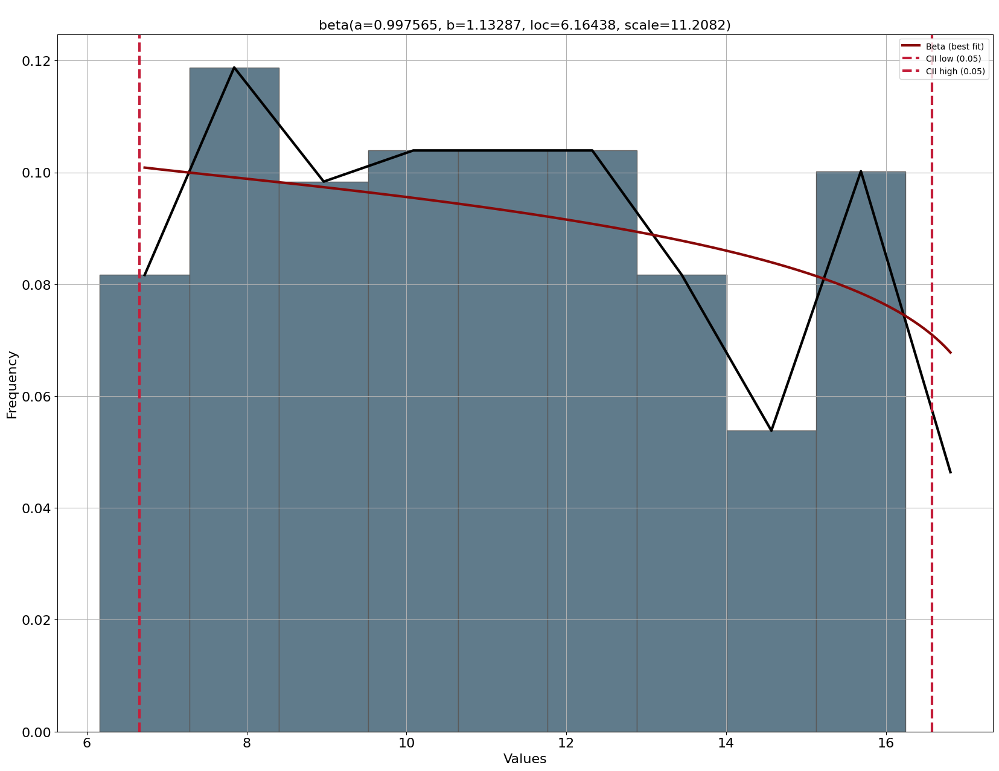

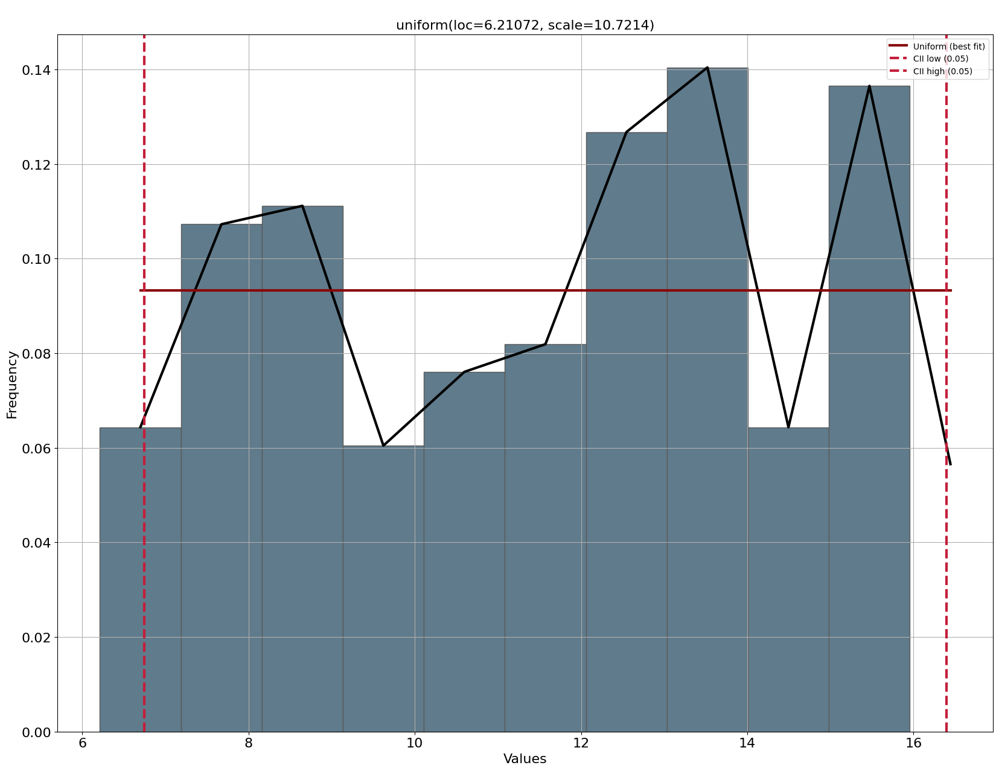

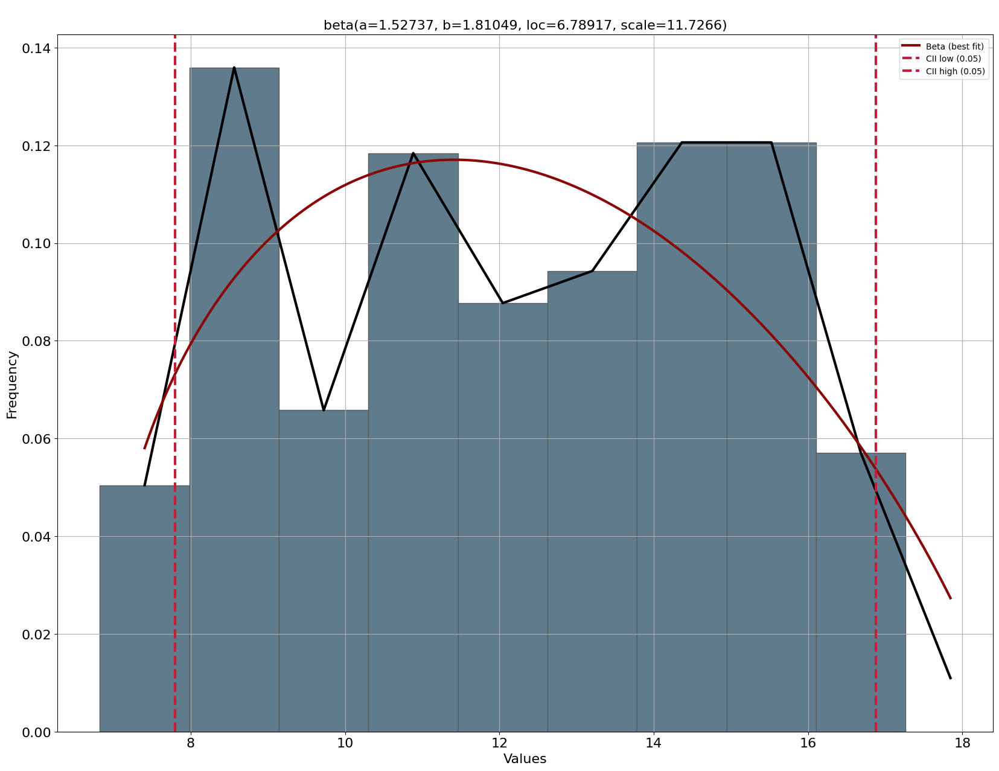

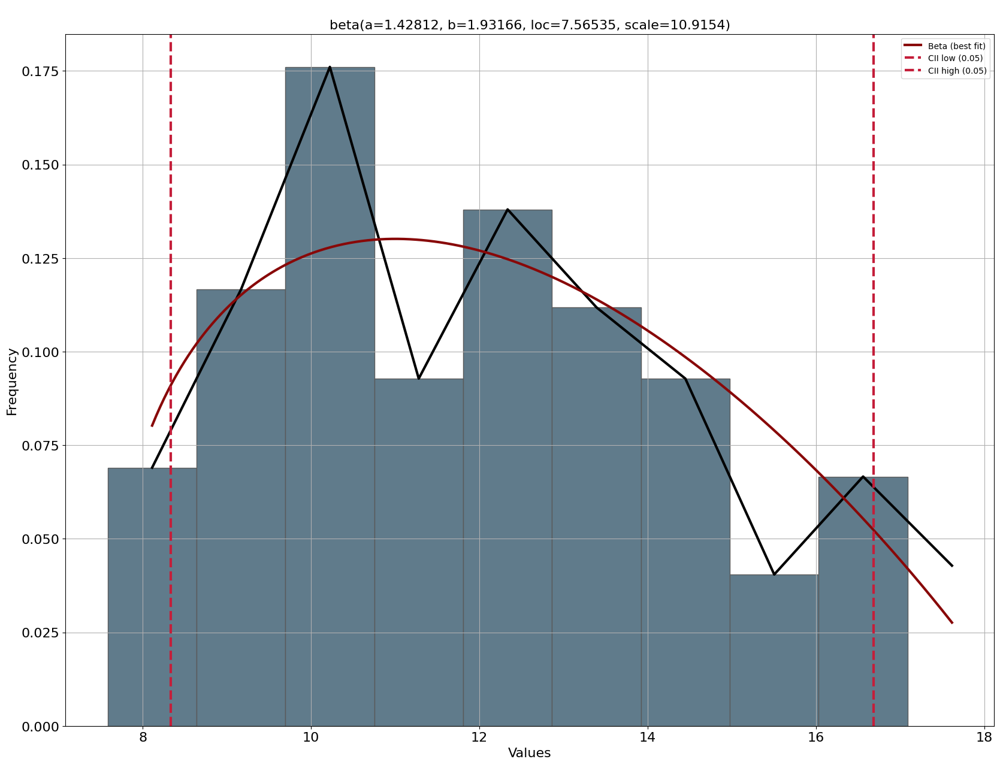

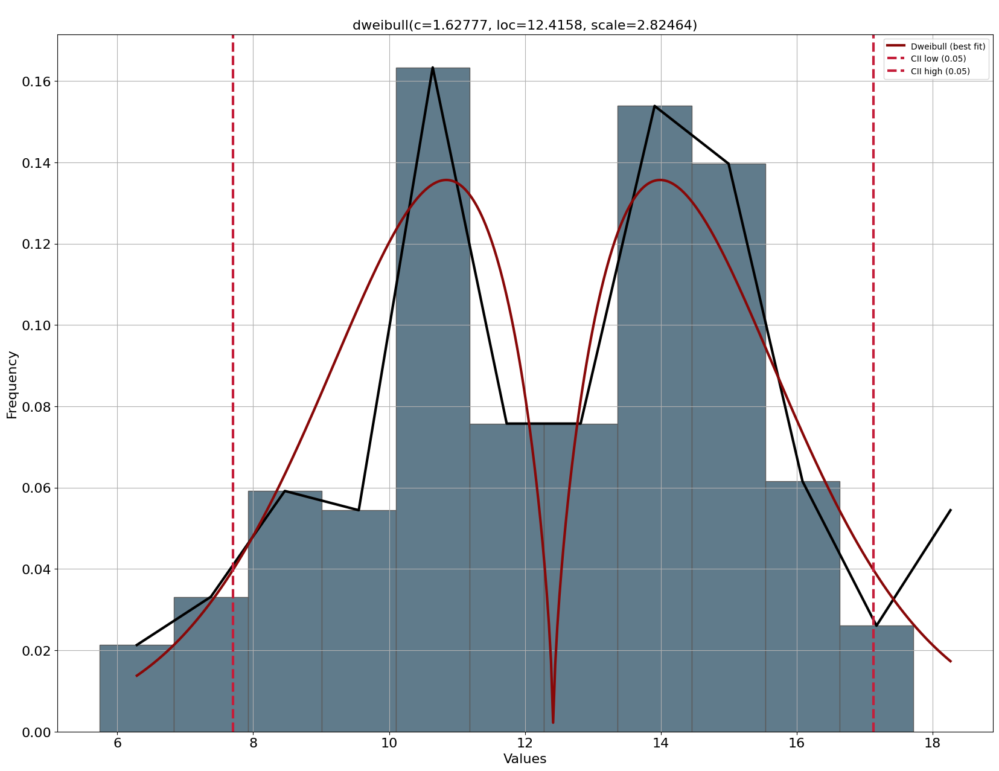

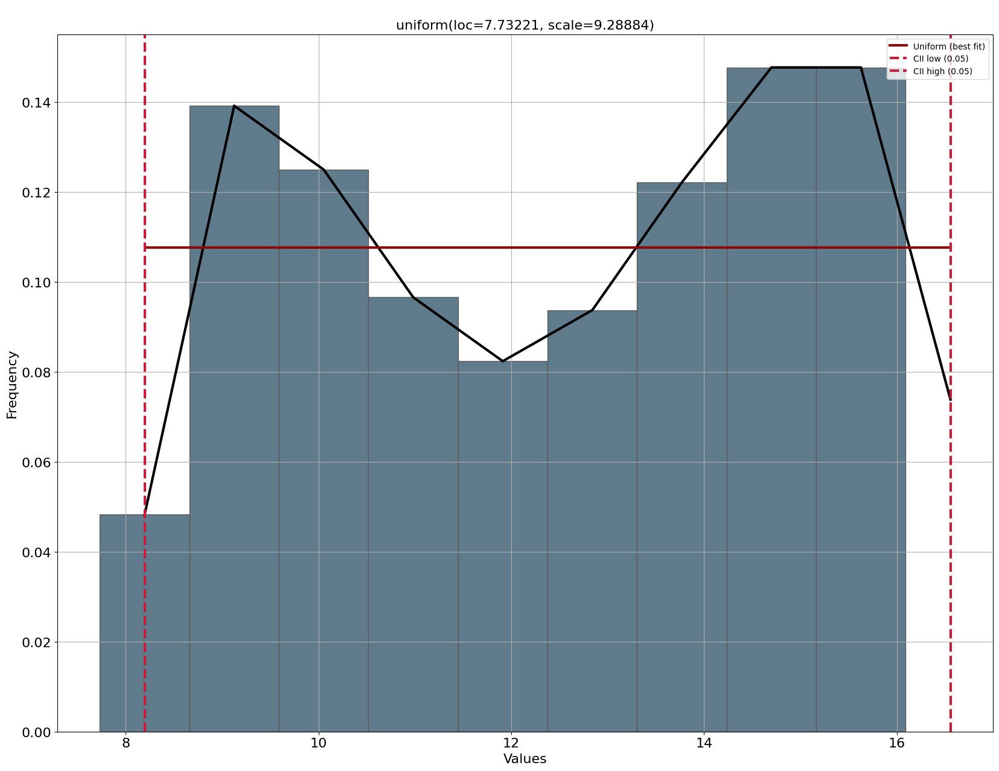

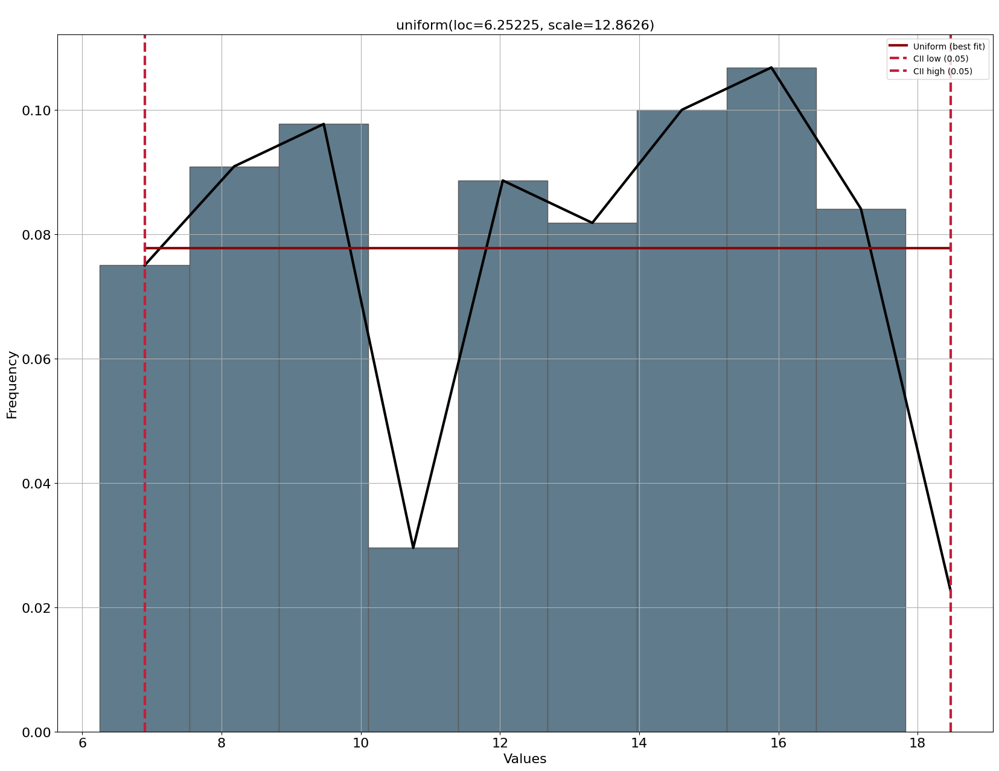

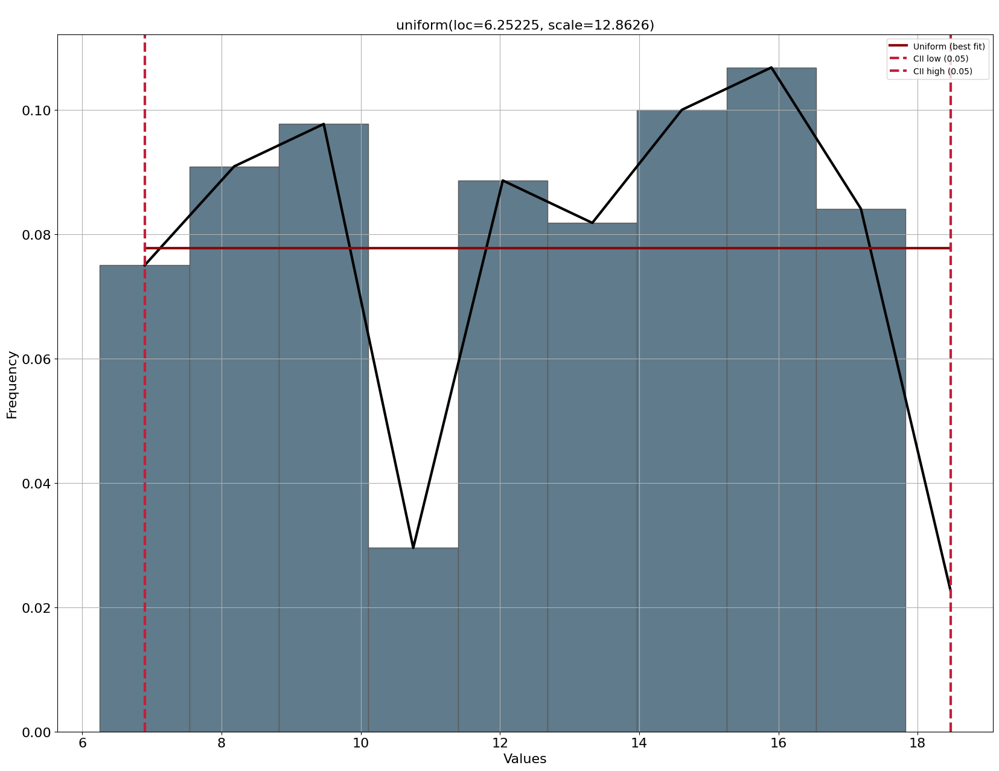

In [ ]:
# @title queda las distribuciones para TC quedan así.
resultados = pd.DataFrame()

for i in base['DSC'].unique():
  filtro = base[base['DSC'] == i]

  if i == 1:

    filtro2 = filtro[filtro['Servicio.1'] == "B"]
    filtro3 = filtro[filtro['Servicio.1'] != "B"]
    dfit = distfit()
    resultado = dfit.fit_transform(filtro3['TiempoC'])
    resultado['summary']['Dia de la semana'] = [str(i)] * len(resultado['summary'])
    resultado['summary']['Servicio'] = ["B"] * len(resultado['summary'])
    resultados = pd.concat([resultados, resultado['summary']])
    dfit.plot()
    resultado = dfit.fit_transform(filtro3['TiempoC'])
    resultado['summary']['Dia de la semana'] = [str(i)] * len(resultado['summary'])
    resultado['summary']['Servicio'] = ["M,M-B,P,M-P,M-B-P"] * len(resultado['summary'])
    resultados = pd.concat([resultados, resultado['summary']])
    dfit.plot()
  elif str(i) != "nan":
    dfit = distfit()
    resultado = dfit.fit_transform(filtro['TiempoC'])
    resultado['summary']['Dia de la semana'] = [str(i)] * len(resultado['summary'])
    resultado['summary']['Servicio'] = [""] * len(resultado['summary'])
    resultados = pd.concat([resultados, resultado['summary']])
    dfit.plot()

sacar_informacion(resultados, f"FDP Tiempo Llegada a la Central")

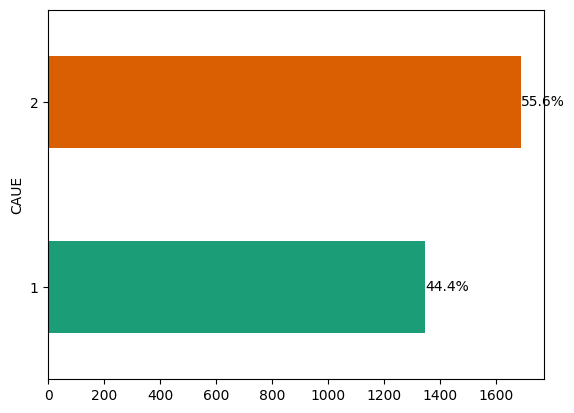

In [ ]:
# @title CAUE
counts = base.groupby('CAUE').size()
percentages = counts / counts.sum() * 100
ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
for i, (count, percentage) in enumerate(zip(counts, percentages)):
    ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')

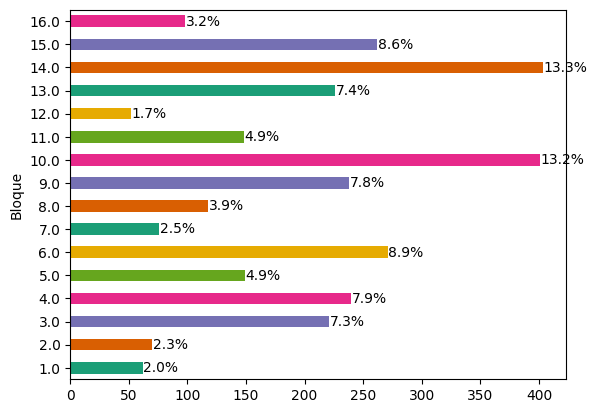

In [ ]:
# @title Bloques
counts = base.groupby('Bloque').size()
percentages = counts / counts.sum() * 100
ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
for i, (count, percentage) in enumerate(zip(counts, percentages)):
    ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')

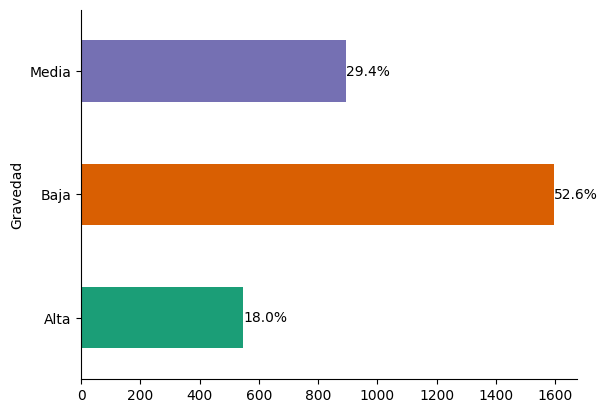

In [ ]:
# @title Gravedad
counts = base.groupby('Gravedad').size()
percentages = counts / counts.sum() * 100
ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
for i, (count, percentage) in enumerate(zip(counts, percentages)):
    ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')
plt.gca().spines[['top', 'right',]].set_visible(False)
plt.show()

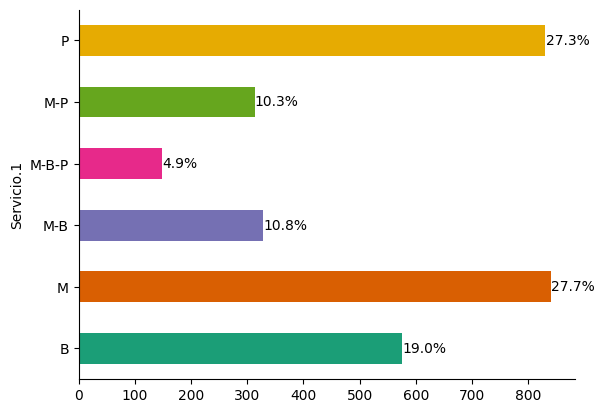

In [ ]:
# @title Servicio.1
counts = base.groupby('Servicio.1').size()
percentages = counts / counts.sum() * 100
ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

for i, (count, percentage) in enumerate(zip(counts, percentages)):
    ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')

plt.gca().spines[['top', 'right']].set_visible(False)
plt.show()

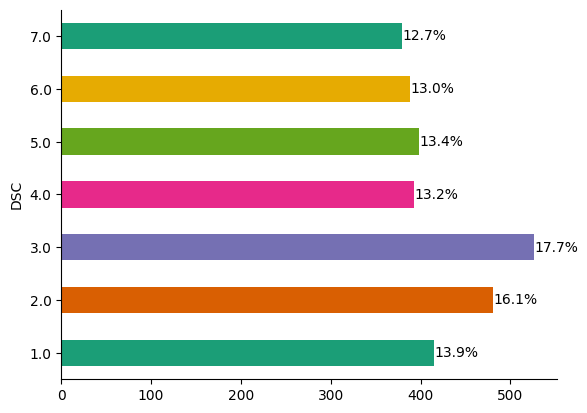

In [ ]:
# @title Dia de la semana
counts = base.groupby('DSC').size()
percentages = counts / counts.sum() * 100
ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

for i, (count, percentage) in enumerate(zip(counts, percentages)):
    ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')

plt.gca().spines[['top', 'right']].set_visible(False)
plt.show()

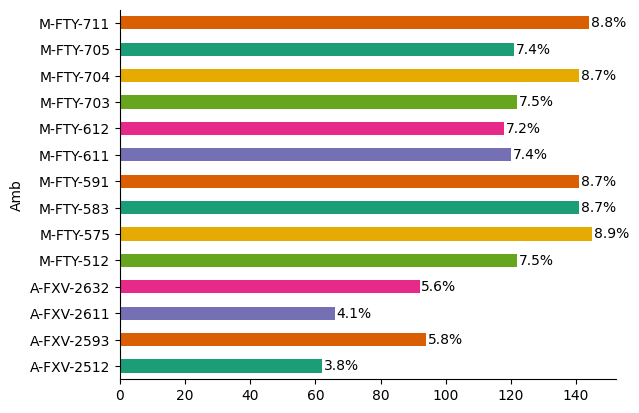

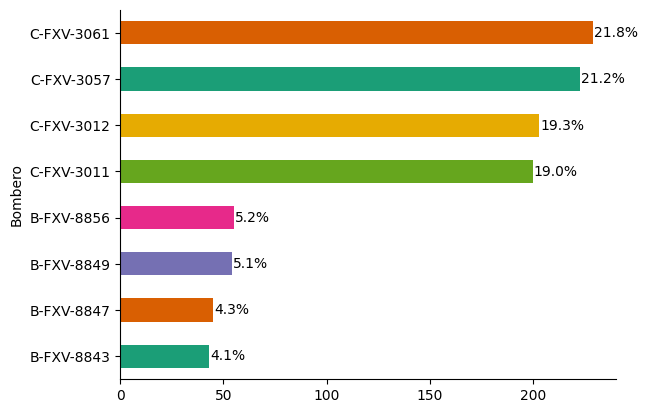

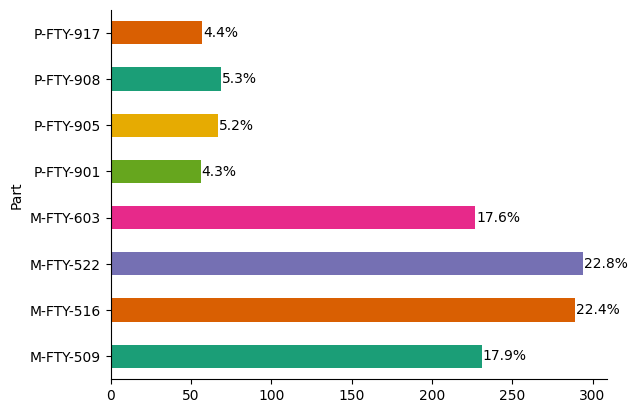

In [ ]:
# @title Uso de las capacidades
counts = base.groupby('Amb').size()
percentages = counts / counts.sum() * 100
ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

for i, (count, percentage) in enumerate(zip(counts, percentages)):
    ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')

plt.gca().spines[['top', 'right']].set_visible(False)
plt.show()

counts = base.groupby('Bombero').size()
percentages = counts / counts.sum() * 100
ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

for i, (count, percentage) in enumerate(zip(counts, percentages)):
    ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')

plt.gca().spines[['top', 'right']].set_visible(False)
plt.show()

counts = base.groupby('Part').size()
percentages = counts / counts.sum() * 100
ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

for i, (count, percentage) in enumerate(zip(counts, percentages)):
    ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')

plt.gca().spines[['top', 'right']].set_visible(False)
plt.show()

         
Centro 1


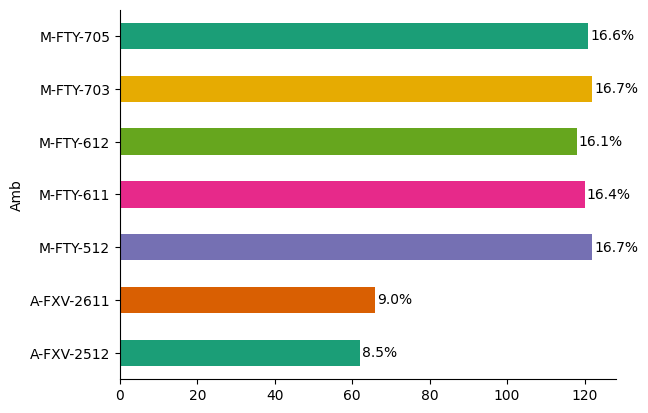

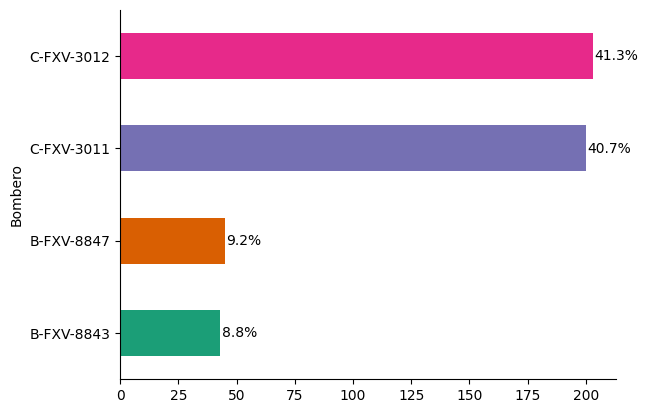

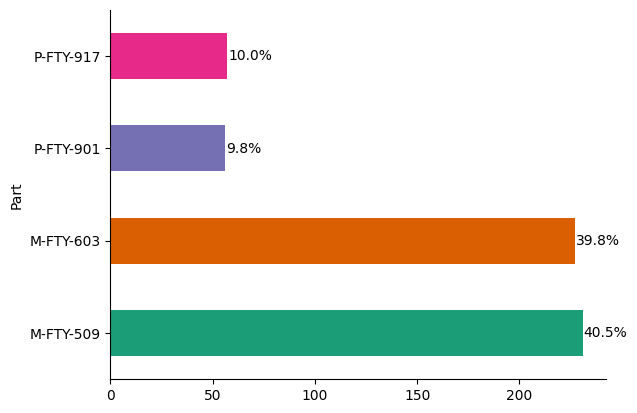

         
Centro 2


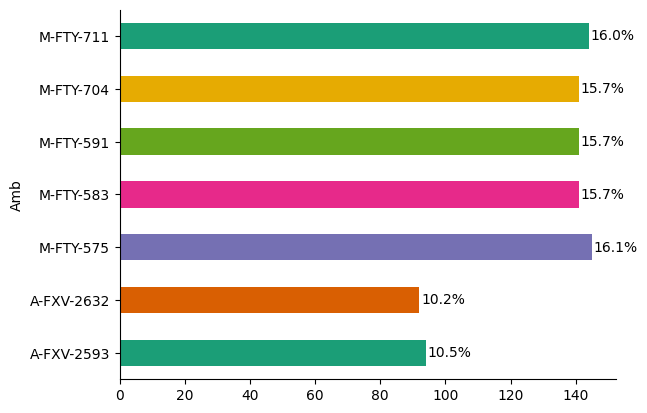

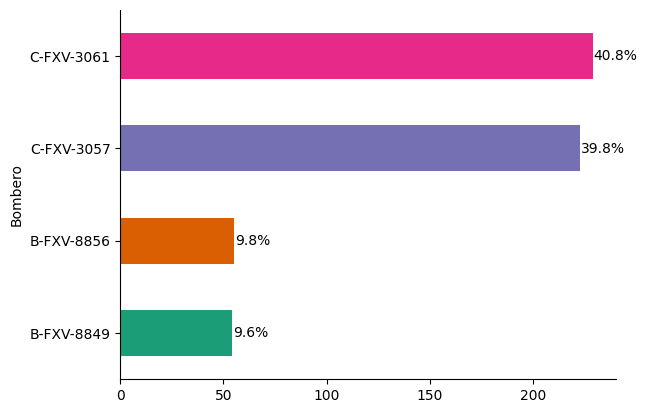

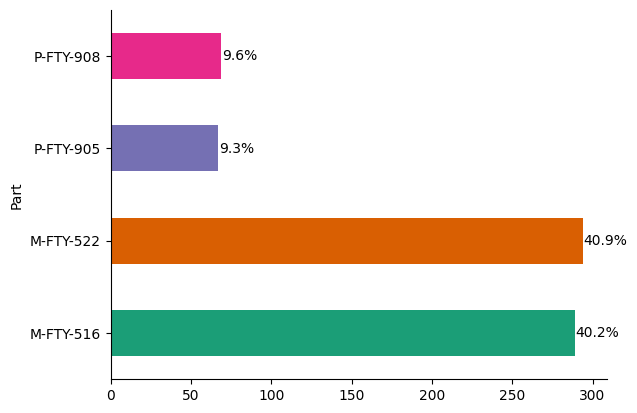

In [ ]:
for j in base["CAUE"].unique():
  filtro = base[base["CAUE"] == j]
  print("         ")
  print(f"Centro {j}")
  counts = filtro.groupby('Amb').size()
  percentages = counts / counts.sum() * 100
  ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

  for i, (count, percentage) in enumerate(zip(counts, percentages)):
      ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')

  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.show()

  counts = filtro.groupby('Bombero').size()
  percentages = counts / counts.sum() * 100
  ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

  for i, (count, percentage) in enumerate(zip(counts, percentages)):
      ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')

  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.show()

  counts = filtro.groupby('Part').size()
  percentages = counts / counts.sum() * 100
  ax = counts.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))

  for i, (count, percentage) in enumerate(zip(counts, percentages)):
      ax.text(count + 0.5, i, f'{percentage:.1f}%', va='center', ha='left', color='black')

  plt.gca().spines[['top', 'right']].set_visible(False)
  plt.show()

In [ ]:
caue1 = "St-7S Av-7E"
caue2 = "Av-10E St-8N"
print("Bloque de CAUE 1 es "+str(hallarBloque(caue1)))
print("Bloque de CAUE 2 es "+str(hallarBloque(caue2)))

Bloque de CAUE 1 es 1
Bloque de CAUE 2 es 6


In [ ]:
base.groupby(["Bloque","Servicio.1","Gravedad"])["Servicio.1"].count().to_excel("Descripcion.xlsx")

In [ ]:
base[['TiempoA', 'TiempoZ', 'TiempoS', 'TiempoI','TiempoC']].describe()

,TiempoA,TiempoZ,TiempoS,TiempoI,TiempoC
count,3035.000000,3035.000000,3035.000000,3035.000000,2980.000000
mean,0.237390,0.100020,0.170645,0.245539,12.062142
std,0.276009,0.022083,0.078063,0.160800,2.995174
min,0.000031,0.012261,0.000435,0.052649,5.761699
25%,0.060034,0.084550,0.107402,0.118940,9.458101
50%,0.152185,0.100038,0.173736,0.200582,12.220795
75%,0.310217,0.115820,0.225126,0.309155,14.562052
max,3.090977,0.162759,0.386848,0.614564,19.095752


In [ ]:
for i in base["CAUE"].unique():
  filtro = base[base["CAUE"]==i]
  print(f"Centro {i}")
  print("             ")
  print(filtro[['TiempoA', 'TiempoZ', 'TiempoS', 'TiempoI','TiempoC']].describe())
  print("             ")

Centro 1
             
           TiempoA      TiempoZ      TiempoS      TiempoI      TiempoC
count  1347.000000  1347.000000  1347.000000  1347.000000  1322.000000
mean      0.236378     0.100127     0.178877     0.239309    12.112042
std       0.262871     0.023034     0.082682     0.156969     2.989922
min       0.000082     0.012261     0.003448     0.053925     5.847779
25%       0.059584     0.083079     0.111321     0.117491     9.459088
50%       0.154038     0.100515     0.179283     0.197099    12.285194
75%       0.314768     0.117250     0.234743     0.303280    14.577466
max       2.428963     0.161342     0.386848     0.614564    19.095752
             
Centro 2
             
           TiempoA      TiempoZ      TiempoS      TiempoI      TiempoC
count  1688.000000  1688.000000  1688.000000  1688.000000  1658.000000
mean      0.238198     0.099935     0.164075     0.250511    12.022354
std       0.286136     0.021300     0.073537     0.163670     2.999662
min       0.00003

In [ ]:
print(base.groupby(["CAUE","Amb","Gravedad"])["Amb"].count())
print(base.groupby(["CAUE","Bombero","Gravedad"])["Bombero"].count())
print(base.groupby(["CAUE","Part","Gravedad"])["Part"].count())

CAUE  Amb         Gravedad
1     A-FXV-2512  Alta        62
      A-FXV-2611  Alta        66
      M-FTY-512   Baja        81
                  Media       41
      M-FTY-611   Baja        70
                  Media       50
      M-FTY-612   Baja        69
                  Media       49
      M-FTY-703   Baja        64
                  Media       58
      M-FTY-705   Baja        82
                  Media       39
2     A-FXV-2593  Alta        94
      A-FXV-2632  Alta        92
      M-FTY-575   Alta         1
                  Baja        93
                  Media       51
      M-FTY-583   Baja        88
                  Media       53
      M-FTY-591   Baja        78
                  Media       63
      M-FTY-704   Baja        95
                  Media       46
      M-FTY-711   Baja        96
                  Media       48
Name: Amb, dtype: int64
CAUE  Bombero     Gravedad
1     B-FXV-8843  Alta         43
      B-FXV-8847  Alta         45
      C-FXV-3011  Baja       

In [ ]:
# Sumar los tiempos de ocupación por recurso
tiempo_total_amb = base.loc[base['Amb'].notna(), ['TiempoS', 'TiempoI']].sum().sum()
tiempo_total_bombero = base.loc[base['Bombero'].notna(), ['TiempoS', 'TiempoI']].sum().sum()
tiempo_total_part = base.loc[base['Part'].notna(), ['TiempoS', 'TiempoI']].sum().sum()

# Obtener el tiempo total de la simulación
tiempo_total_simulacion = base["RelojC"].max()

# Calcular porcentaje de ocupación
ocupacion_amb = tiempo_total_amb / tiempo_total_simulacion
ocupacion_bombero = tiempo_total_bombero / tiempo_total_simulacion
ocupacion_part = tiempo_total_part / tiempo_total_simulacion

# Calcular porcentaje de ocio
ocio_amb = 1 - ocupacion_amb
ocio_bombero = 1 - ocupacion_bombero
ocio_part = 1 - ocupacion_part

# Mostrar resultados
print(f'Ocupación Ambulancias: {ocupacion_amb:.2%}, Ocio: {ocio_amb:.2%}')
print(f'Ocupación Bomberos: {ocupacion_bombero:.2%}, Ocio: {ocio_bombero:.2%}')
print(f'Ocupación Patrulleros: {ocupacion_part:.2%}, Ocio: {ocio_part:.2%}')

Ocupación Ambulancias: 93.93%, Ocio: 6.07%
Ocupación Bomberos: 65.94%, Ocio: 34.06%
Ocupación Patrulleros: 66.77%, Ocio: 33.23%


In [ ]:
for i in base["CAUE"].unique():
  filtro = base[base["CAUE"] == i]
  # Sumar los tiempos de ocupación por recurso
  tiempo_total_amb = filtro.loc[filtro['Amb'].notna(), ['TiempoS', 'TiempoI']].sum().sum()
  tiempo_total_bombero = filtro.loc[filtro['Bombero'].notna(), ['TiempoS', 'TiempoI']].sum().sum()
  tiempo_total_part = filtro.loc[filtro['Part'].notna(), ['TiempoS', 'TiempoI']].sum().sum()

  # Obtener el tiempo total de la simulación
  tiempo_total_simulacion = base["RelojC"].max()

  # Calcular porcentaje de ocupación
  ocupacion_amb = tiempo_total_amb / tiempo_total_simulacion
  ocupacion_bombero = tiempo_total_bombero / tiempo_total_simulacion
  ocupacion_part = tiempo_total_part / tiempo_total_simulacion

  # Calcular porcentaje de ocio
  ocio_amb = 1 - ocupacion_amb
  ocio_bombero = 1 - ocupacion_bombero
  ocio_part = 1 - ocupacion_part

  # Mostrar resultados
  print(f'Ocupación en el CAUE {i} Ambulancias: {ocupacion_amb:.2%}, Ocio: {ocio_amb:.2%}')
  print(f'Ocupación en el CAUE {i} Bomberos: {ocupacion_bombero:.2%}, Ocio: {ocio_bombero:.2%}')
  print(f'Ocupación en el CAUE {i} Patrulleros: {ocupacion_part:.2%}, Ocio: {ocio_part:.2%}')

Ocupación en el CAUE 1 Ambulancias: 41.97%, Ocio: 58.03%
Ocupación en el CAUE 1 Bomberos: 31.02%, Ocio: 68.98%
Ocupación en el CAUE 1 Patrulleros: 30.43%, Ocio: 69.57%
Ocupación en el CAUE 2 Ambulancias: 51.97%, Ocio: 48.03%
Ocupación en el CAUE 2 Bomberos: 34.92%, Ocio: 65.08%
Ocupación en el CAUE 2 Patrulleros: 36.35%, Ocio: 63.65%


In [ ]:
# Crear lista para almacenar los resultados
resultados = []

# Iterar sobre cada tipo de recurso (ambulancias, bomberos, patrulleros)
for recurso in ["Amb", "Bombero", "Part"]:
    # Obtener lista de servidores únicos en esa categoría
    servidores = base[recurso].dropna().unique()

    for servidor in servidores:
        filtro = base[base[recurso] == servidor]

        tiempo_total_servidor = filtro[['TiempoS', 'TiempoI','TiempoC']].sum().sum()

        # Obtener el tiempo total de la simulación
        tiempo_total_simulacion = base["RelojC"].max()  # Tiempo total para normalizar

        # Evitar división por cero
        if tiempo_total_simulacion == 0:
            continue

        # Calcular el porcentaje de ocupación
        ocupacion = tiempo_total_servidor / tiempo_total_simulacion

        # Calcular el porcentaje de ocio
        ocio = 1 - ocupacion

        # Guardar en la lista de resultados
        resultados.append({
            "Servidor": servidor,
            "Tipo": recurso,
            "Ocupación (%)": ocupacion * 100,
            "Ocio (%)": ocio * 100
        })

# Convertir resultados en un DataFrame
df_resultados = pd.DataFrame(resultados)

print(df_resultados)

      Servidor     Tipo  Ocupación (%)    Ocio (%)
0   A-FXV-2611      Amb     113.772831  -13.772831
1    M-FTY-575      Amb     247.711901 -147.711901
2    M-FTY-583      Amb     239.648264 -139.648264
3    M-FTY-591      Amb     238.006310 -138.006310
4   A-FXV-2593      Amb     158.306524  -58.306524
5    M-FTY-704      Amb     240.607066 -140.607066
6    M-FTY-512      Amb     208.652186 -108.652186
7   A-FXV-2512      Amb     102.609932   -2.609932
8   A-FXV-2632      Amb     153.692538  -53.692538
9    M-FTY-711      Amb     245.578088 -145.578088
10   M-FTY-611      Amb     207.556639 -107.556639
11   M-FTY-612      Amb     202.676138 -102.676138
12   M-FTY-703      Amb     207.533623 -107.533623
13   M-FTY-705      Amb     207.361395 -107.361395
14  B-FXV-8847  Bombero      78.614845   21.385155
15  C-FXV-3057  Bombero     375.553129 -275.553129
16  B-FXV-8843  Bombero      72.050455   27.949545
17  B-FXV-8856  Bombero      90.844894    9.155106
18  C-FXV-3061  Bombero     379

In [ ]:
base.loc[base['Amb'].notna(), ['TiempoS', 'TiempoI', 'TiempoC']].max()

,0
TiempoS,0.386848
TiempoI,0.609841
TiempoC,19.095752


In [ ]:
base["RelojC"].max()

720.5773758776866